# Ko Ye Kyaw Thu Data 
#Data 60000

Three reliable model you can see...
1. Build Word2Vec with Skip Gram include negative value 3
3. Build Word2Vec Model with Skip Gram (Neg=0,Iter=2,size=100,window=5)
2. Build Word2Vec Model with Skip Gram (Neg=0,Iter=2,size=100,window=10)


# --------------------------******************************--------------------------------------

# Hierarchical softmax

#Here..... 
         Hierarchical softmax uses a binary tree to represent all words in the vocabulary. The words themselves are leaves in the tree. For each leaf, there exists a unique path from the root to the leaf, and this path is used to estimate the probability of the word represented by the leaf. “We define this probability as the probability of a random walk starting from the root ending at the leaf in question.”

https://adriancolyer.files.wordpress.com/2016/04/word2vec-hierarchical-softmax.png?w=600

# ---------------------------------------*****------------------------------------------------

# Why Negative sampling?????

Negative Sampling is simply the idea that we only update a sample of output words per iteration. The target output word should be kept in the sample and gets updated, and we add to this a few (non-target) words as negative samples. “A probabilistic distribution is needed for the sampling process, and it can be arbitrarily chosen… One can determine a good distribution empirically.”

https://adriancolyer.files.wordpress.com/2016/04/word2vec-subsampling.png?w=600

f(wi) is the frequency of word wi and t is a chosen threshold, typically around 10-5.

# ---------------------------------------------************---------------------------------

# All Model Report 

[model -----SkipGram with neg 3][model1 ------CBOW with neg 3][model2 ------ SkipGram,iter 2,window 5]||[model3 ----- SkipGram,iter 2,window 10]||[model4 ----- SkipGram,iter 2,window 15]||[model_w3 -----SkipGram,iter 2,window 3]

https://docs.google.com/spreadsheets/d/1D9tVg5EVLsboBtV7Z9wbcjHpKvgjnwNzr1QvctBLDm0/edit#gid=0

In [1]:
import pandas as pd
import numpy as np
from gensim.test.utils import common_texts
from gensim.models import Word2Vec
from gensim.models import FastText

In [2]:
import logging
import datalab.storage as dlb_storage
from io import BytesIO


Function For read_csv from GCS(cloud)

In [3]:
def read_csv(file, nrows,usecols=all):
    stream =  dlb_storage.Bucket('project-bagandata').item(file).read_from()
    data = pd.read_csv(BytesIO(stream), engine='c', nrows=nrows, low_memory=False, header='infer', usecols=usecols)
    return data

In [4]:
data=read_csv('nlp/KoYeKyawThu-data/mmlines.txt',60000,usecols=all)
print(type(data))
data.columns = ['sent']

<class 'pandas.core.frame.DataFrame'>


In [5]:
data.columns

Index(['sent'], dtype='object')

In [5]:
display (data.head())

,sent
0,တံခါး က မ ပိတ် ဘူး ။
1,ထို အစည်းအရုံး သည် အမျိုးသား ရေး စိတ်ဓာတ် ပြင်...
2,ဓာတုဗေဒ ပညာရပ် ပိုင်း က သုံးသပ် ရင် လည်း ဓာတု ...
3,နာရီ ဘယ် မှာ ဝယ် လို့ ရ နိုင် မလဲ ။
4,ဘီအိုင်အေ အမှတ် ၅၅ ဂျပန် တပ်မ တွင် ဗိုလ်ကြီး အ...


Convert DataFrame To List

In [5]:
data = data.iloc[:,0].values.tolist()
print (data[:5])

['တံခါး က မ ပိတ် ဘူး ။', 'ထို အစည်းအရုံး သည် အမျိုးသား ရေး စိတ်ဓာတ် ပြင်းပြ ၍ နုပျို တက်ကြွ သည့် အခြေခံ လက္ခဏာ ရှိ ပြီး အစည်းအရုံး ခေါင်းဆောင် များ သည် သက်ကြီး နိုင်ငံရေးသမား များ နှင့် မ တူ တမူထူးခြား ကြ ပါ သည် ။', 'ဓာတုဗေဒ ပညာရပ် ပိုင်း က သုံးသပ် ရင် လည်း ဓာတု ပညာရပ် ကို စ ခဲ့ တဲ့ ရှေး ခေတ် အဂ္ဂိရတ် ဆရာကြီး တွေ ရဲ့ ယမ်းငရဲမီး ၊ ကန့်ငရဲမီး ၊ ဆားငရဲမီး နဲ့ ရွှေစားငရဲမီး ထုတ်လုပ် ပုံ နည်းစနစ် တွေ နဲ့ ပုံစံ တူ တာ တွေ့ ရ သည် ။', 'နာရီ ဘယ် မှာ ဝယ် လို့ ရ နိုင် မလဲ ။', 'ဘီအိုင်အေ အမှတ် ၅၅ ဂျပန် တပ်မ တွင် ဗိုလ်ကြီး အဖြစ် လိုက် ပါ ခဲ့ ၏ ။']


In [6]:
new_data = [s.split() for s in data]
print (new_data[:5])

[['တံခါး', 'က', 'မ', 'ပိတ်', 'ဘူး', '။'], ['ထို', 'အစည်းအရုံး', 'သည်', 'အမျိုးသား', 'ရေး', 'စိတ်ဓာတ်', 'ပြင်းပြ', '၍', 'နုပျို', 'တက်ကြွ', 'သည့်', 'အခြေခံ', 'လက္ခဏာ', 'ရှိ', 'ပြီး', 'အစည်းအရုံး', 'ခေါင်းဆောင်', 'များ', 'သည်', 'သက်ကြီး', 'နိုင်ငံရေးသမား', 'များ', 'နှင့်', 'မ', 'တူ', 'တမူထူးခြား', 'ကြ', 'ပါ', 'သည်', '။'], ['ဓာတုဗေဒ', 'ပညာရပ်', 'ပိုင်း', 'က', 'သုံးသပ်', 'ရင်', 'လည်း', 'ဓာတု', 'ပညာရပ်', 'ကို', 'စ', 'ခဲ့', 'တဲ့', 'ရှေး', 'ခေတ်', 'အဂ္ဂိရတ်', 'ဆရာကြီး', 'တွေ', 'ရဲ့', 'ယမ်းငရဲမီး', '၊', 'ကန့်ငရဲမီး', '၊', 'ဆားငရဲမီး', 'နဲ့', 'ရွှေစားငရဲမီး', 'ထုတ်လုပ်', 'ပုံ', 'နည်းစနစ်', 'တွေ', 'နဲ့', 'ပုံစံ', 'တူ', 'တာ', 'တွေ့', 'ရ', 'သည်', '။'], ['နာရီ', 'ဘယ်', 'မှာ', 'ဝယ်', 'လို့', 'ရ', 'နိုင်', 'မလဲ', '။'], ['ဘီအိုင်အေ', 'အမှတ်', '၅၅', 'ဂျပန်', 'တပ်မ', 'တွင်', 'ဗိုလ်ကြီး', 'အဖြစ်', 'လိုက်', 'ပါ', 'ခဲ့', '၏', '။']]


# Do not run this cell if you don't need to check the whole data

In [7]:
##Careful start this cell only for check whole data
display (new_data)

[['တံခါး', 'က', 'မ', 'ပိတ်', 'ဘူး', '။'],
 ['ထို',
  'အစည်းအရုံး',
  'သည်',
  'အမျိုးသား',
  'ရေး',
  'စိတ်ဓာတ်',
  'ပြင်းပြ',
  '၍',
  'နုပျို',
  'တက်ကြွ',
  'သည့်',
  'အခြေခံ',
  'လက္ခဏာ',
  'ရှိ',
  'ပြီး',
  'အစည်းအရုံး',
  'ခေါင်းဆောင်',
  'များ',
  'သည်',
  'သက်ကြီး',
  'နိုင်ငံရေးသမား',
  'များ',
  'နှင့်',
  'မ',
  'တူ',
  'တမူထူးခြား',
  'ကြ',
  'ပါ',
  'သည်',
  '။'],
 ['ဓာတုဗေဒ',
  'ပညာရပ်',
  'ပိုင်း',
  'က',
  'သုံးသပ်',
  'ရင်',
  'လည်း',
  'ဓာတု',
  'ပညာရပ်',
  'ကို',
  'စ',
  'ခဲ့',
  'တဲ့',
  'ရှေး',
  'ခေတ်',
  'အဂ္ဂိရတ်',
  'ဆရာကြီး',
  'တွေ',
  'ရဲ့',
  'ယမ်းငရဲမီး',
  '၊',
  'ကန့်ငရဲမီး',
  '၊',
  'ဆားငရဲမီး',
  'နဲ့',
  'ရွှေစားငရဲမီး',
  'ထုတ်လုပ်',
  'ပုံ',
  'နည်းစနစ်',
  'တွေ',
  'နဲ့',
  'ပုံစံ',
  'တူ',
  'တာ',
  'တွေ့',
  'ရ',
  'သည်',
  '။'],
 ['နာရီ', 'ဘယ်', 'မှာ', 'ဝယ်', 'လို့', 'ရ', 'နိုင်', 'မလဲ', '။'],
 ['ဘီအိုင်အေ',
  'အမှတ်',
  '၅၅',
  'ဂျပန်',
  'တပ်မ',
  'တွင်',
  'ဗိုလ်ကြီး',
  'အဖြစ်',
  'လိုက်',
  'ပါ',
  'ခဲ့',
  '၏',
  '။'],
 ['ရောဂါ', 'လက္ခဏ

Set stop list 

In [8]:
stoplist = set('သည် ။ ကို တွင် ပါ သာ ဟာ လာ မ သော ရှိ များ ၊ သည့် ၏ နှင့် ပြီး လည်း ၍ ဖြစ် သောအခါ ဖို့ သလဲ မှာ ကြ တို့ ခြင်း က ခဲ့'.split())

In [9]:
texts = [[word for word in sentence if word not in stoplist]for sentence in new_data]

In [10]:
texts[:5]

[['တံခါး', 'ပိတ်', 'ဘူး'],
 ['ထို',
  'အစည်းအရုံး',
  'အမျိုးသား',
  'ရေး',
  'စိတ်ဓာတ်',
  'ပြင်းပြ',
  'နုပျို',
  'တက်ကြွ',
  'အခြေခံ',
  'လက္ခဏာ',
  'အစည်းအရုံး',
  'ခေါင်းဆောင်',
  'သက်ကြီး',
  'နိုင်ငံရေးသမား',
  'တူ',
  'တမူထူးခြား'],
 ['ဓာတုဗေဒ',
  'ပညာရပ်',
  'ပိုင်း',
  'သုံးသပ်',
  'ရင်',
  'ဓာတု',
  'ပညာရပ်',
  'စ',
  'တဲ့',
  'ရှေး',
  'ခေတ်',
  'အဂ္ဂိရတ်',
  'ဆရာကြီး',
  'တွေ',
  'ရဲ့',
  'ယမ်းငရဲမီး',
  'ကန့်ငရဲမီး',
  'ဆားငရဲမီး',
  'နဲ့',
  'ရွှေစားငရဲမီး',
  'ထုတ်လုပ်',
  'ပုံ',
  'နည်းစနစ်',
  'တွေ',
  'နဲ့',
  'ပုံစံ',
  'တူ',
  'တာ',
  'တွေ့',
  'ရ'],
 ['နာရီ', 'ဘယ်', 'ဝယ်', 'လို့', 'ရ', 'နိုင်', 'မလဲ'],
 ['ဘီအိုင်အေ', 'အမှတ်', '၅၅', 'ဂျပန်', 'တပ်မ', 'ဗိုလ်ကြီး', 'အဖြစ်', 'လိုက်']]

# Build Word2Vec with Skip Gram include negative value 3
Good

In [11]:
%%time
model = Word2Vec(texts, size=100, window=10, min_count=5,sample=1e-5, negative=3, workers=3,sg=1) # default = 1 worker = no parallelizationd

CPU times: user 10.2 s, sys: 0 ns, total: 10.2 s
Wall time: 4.2 s


In [26]:
cosine_similarity1 = numpy.dot(model['ဗိုလ်ကြီး'], model['စစ်ပြန်'])/(numpy.linalg.norm(model['ဗိုလ်ကြီး'])* numpy.linalg.norm(model['စစ်ပြန်']))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """Entry point for launching an IPython kernel.


In [165]:
model2.wv.cosine_similarities('စစ်ပြန်','ဗိုလ်ကြီး')

ValueError: could not convert string to float: 'စစ်ပြန်'

In [13]:
model.predict_output_word('နုပျို')

[('တောင်တွင်း', 0.00020472716),
 ('၁၄၈၅', 0.0002045584),
 ('၁၇၆၄', 0.00020295264),
 ('၁၇၅၃', 0.00020062336),
 ('ကညင်သီး', 0.00020046225),
 ('ပရင်ဆီပီ', 0.00019807958),
 ('၁၅၄၂', 0.0001975253),
 ('ကနခို', 0.00019663158),
 ('၁၇၆ဝ', 0.0001962643),
 ('ဇမ်ဘီယာဂီ', 0.00019625627)]

In [27]:
print ("Cosine Similarity: ",cosine_similarity1)

Cosine Similarity:  0.99752355


In [14]:
print(model.similarity('နုပျို','တက်ကြွ'))

0.9967837743942799


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `similarity` (Method will be removed in 4.0.0, use self.wv.similarity() instead).
  """Entry point for launching an IPython kernel.


In [465]:
x = model['စာချုပ်']

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """Entry point for launching an IPython kernel.


In [466]:
type(x)

numpy.ndarray

In [16]:
model.most_similar('ဗိုလ်ကြီး')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('အရည်ဖျော်', 0.9983748197555542),
 ('York', 0.9983621835708618),
 ('ကုလ', 0.9982479810714722),
 ('နနွင်းတက်', 0.9982355237007141),
 ('ပြကွက်', 0.9982258081436157),
 ('ဂျုံမှုန့်', 0.9982202649116516),
 ('ဖိုစဖိတ်', 0.9982196092605591),
 ('Evaporation', 0.9982181787490845),
 ('အလေးမ', 0.998214602470398),
 ('ချင်းခြောက်', 0.9982088804244995)]

In [66]:
model.predict_output_word('မျက်လုံး')

[('တောင်တွင်း', 0.0002870451),
 ('ဆိုသိုလိုက်ဘေးရီးယား', 0.0002669013),
 ('လီယွန်ဆိုမားလီးယား', 0.00026544178),
 ('ဂျီဘူတီ', 0.0002639253),
 ('Dictionary', 0.000261091),
 ('လင်းနေဆီ', 0.0002553226),
 ('၁၅၄၂', 0.0002544311),
 ('ဖာလာ', 0.0002535879),
 ('၁၇၅၃', 0.0002528003),
 ('ငရုတ်ကောင်း', 0.00025253493)]

In [67]:
model.predict_output_word('တိုင်းပြည်')

[('တောင်တွင်း', 0.00023461226),
 ('ဆိုသိုလိုက်ဘေးရီးယား', 0.00022083386),
 ('လီယွန်ဆိုမားလီးယား', 0.00021996033),
 ('ဂျီဘူတီ', 0.00021875606),
 ('Dictionary', 0.00021771804),
 ('လင်းနေဆီ', 0.00021286552),
 ('ဖာလာ', 0.00021169233),
 ('၁၅၄၂', 0.00021164221),
 ('ငရုတ်ကောင်း', 0.00021096262),
 ('၁၇၅၃', 0.00021057764)]

In [33]:
model.most_similar('တိုင်းပြည်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('တိန်းညက်', 0.99842369556427),
 ('သေကြေပျက်စီး', 0.9984151721000671),
 ('ဘဂုဇောသောကြာ', 0.998395562171936),
 ('မျိုးချစ်စိတ်ဓာတ်', 0.99836665391922),
 ('ပိန္နဲနွယ်', 0.9983640909194946),
 ('အစေအပါး', 0.9983410835266113),
 ('အရည်စိမ်', 0.9983344078063965),
 ('Absorption', 0.998333752155304),
 ('ဆီနီဂေါဆီယာရာ', 0.9983199834823608),
 ('လီယွန်ဆိုမားလီးယား', 0.9983198046684265)]

In [15]:
model.most_similar('ဂျပန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ဂေါ့', 0.9979783892631531),
 ('နစ်ပွန်ဂေါ့', 0.9978761672973633),
 ('ဘီဒီအေ', 0.9977447390556335),
 ('Nippon', 0.9976174831390381),
 ('ဖိအားပေး', 0.9976024627685547),
 ('လျော့ဈေး', 0.9975768327713013),
 ('Nihon', 0.9975758790969849),
 ('Lost', 0.997566819190979),
 ('ဒီကိပ်ဗာ', 0.9975500106811523),
 ('ကာဗာရီ', 0.9975346326828003)]

In [16]:
model.most_similar('ညီညွတ်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ရေးထိုး', 0.9977515935897827),
 ('စည်းလုံး', 0.9977222681045532),
 ('ခေါင်းဆောင်', 0.9974633455276489),
 ('ဦးသန်းကြွယ်', 0.9974108934402466),
 ('ပင်လုံ', 0.9972838163375854),
 ('ဗိုလ်မှူး', 0.9972476959228516),
 ('ဆာမောင်ကြီး', 0.9972457885742188),
 ('အဓိပ္ပါယ်ဖွင့်', 0.9970133900642395),
 ('တွေ့ဆုံ', 0.9969934225082397),
 ('လုပ်ငန်းစဉ်', 0.9969842433929443)]

In [17]:
model.most_similar('စိတ်ဓာတ်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('လောကဓံ', 0.998735785484314),
 ('အထင်အမြင်လွဲ', 0.9985366463661194),
 ('ဗလာ', 0.9985233545303345),
 ('ကြံ့ကြံ့ခိုင်', 0.9984951019287109),
 ('စစ်တွင်း', 0.9984776377677917),
 ('မီးအုံး', 0.9984346032142639),
 ('ပရင်ဆီပီ', 0.9984129667282104),
 ('ဓာတ်စွဲကပ်', 0.9983924031257629),
 ('အရည်စိမ်', 0.9983813762664795),
 ('ပူပန်', 0.9983792304992676)]

In [18]:
model.most_similar('အပြောင်းအလဲ')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('သိမ်းဆည်းမသို', 0.9984257817268372),
 ('လမ်းခရီး', 0.9984019994735718),
 ('လွန်စကြိုး', 0.9983941316604614),
 ('လင်မြှောက်', 0.9983701705932617),
 ('တူဗာလူဗင်နော့တူ', 0.9983469247817993),
 ('များလှ', 0.9983420372009277),
 ('သင်းတွဲကညင်ဆီ', 0.9983246922492981),
 ('အချမ်းလုံ', 0.998322606086731),
 ('ဖာလာ', 0.9983179569244385),
 ('မာလာဝီမာ', 0.9982855319976807)]

In [34]:
model.most_similar(positive=['အောင်ဆန်း', 'အမည်'], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ဗိုလ်', 0.9938333630561829),
 ('ဗိုလ်ချုပ်', 0.9935804605484009),
 ('အဓိပ္ပါယ်ဖွင့်', 0.9935615062713623),
 ('ခေါင်းဆောင်', 0.993185818195343),
 ('အလိုရှိ', 0.9931073784828186),
 ('သန်းထွန်း', 0.9930101037025452),
 ('လင်္ကျာ', 0.9929861426353455),
 ('ခိုင်ခိုင်မာမာ', 0.9929822683334351),
 ('လုပ်ငန်းစဉ်', 0.992896556854248),
 ('ဦးစီး', 0.992729902267456)]

In [38]:
model.most_similar(positive=[ 'အမည်','အောင်ဆန်း',], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ဗိုလ်', 0.9938333630561829),
 ('ဗိုလ်ချုပ်', 0.9935804605484009),
 ('အဓိပ္ပါယ်ဖွင့်', 0.9935615062713623),
 ('ခေါင်းဆောင်', 0.993185818195343),
 ('အလိုရှိ', 0.9931073784828186),
 ('သန်းထွန်း', 0.9930101037025452),
 ('လင်္ကျာ', 0.9929861426353455),
 ('ခိုင်ခိုင်မာမာ', 0.9929822683334351),
 ('လုပ်ငန်းစဉ်', 0.992896556854248),
 ('ဦးစီး', 0.992729902267456)]

In [39]:
model.most_similar(positive=[ 'အမည်','ဂျပန်'], negative=['အောင်ဆန်း'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ဂေါ့', 0.9942325353622437),
 ('နစ်ပွန်ဂေါ့', 0.9940149784088135),
 ('Nihon', 0.9938432574272156),
 ('ပင်လယ်ရပ်ခြား', 0.9938105344772339),
 ('日本語', 0.9937973618507385),
 ('နိဟွန်း', 0.9936469793319702),
 ('မော်လမြိုင်', 0.9936045408248901),
 ('ရာဇပလ္လင်ဥကင်', 0.9936034679412842),
 ('လူ့ကိုယ်တိုင်း', 0.993575930595398),
 ('မလေး', 0.9935559034347534)]

In [35]:
model.most_similar_cosmul(positive=['အောင်ဆန်း', 'အမည်'], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဗိုလ်', 0.9989811778068542),
 ('ဗိုလ်ချုပ်', 0.9988531470298767),
 ('အဓိပ္ပါယ်ဖွင့်', 0.9988442659378052),
 ('ခေါင်းဆောင်', 0.9986549615859985),
 ('အလိုရှိ', 0.9986159205436707),
 ('သန်းထွန်း', 0.9985668063163757),
 ('လင်္ကျာ', 0.9985550045967102),
 ('ခိုင်ခိုင်မာမာ', 0.9985537528991699),
 ('လုပ်ငန်းစဉ်', 0.9985095858573914),
 ('ဦးစီး', 0.9984260201454163)]

# Build Word2Vec Model with CBOW include negative 3
Not Good

In [12]:
%%time
model1 = Word2Vec(texts, size=100, window=5, min_count=5,sample=1e-5, negative=3, workers=3,sg=0) # default = 1 worker = no parallelizationd

CPU times: user 5.38 s, sys: 130 ms, total: 5.51 s
Wall time: 3.57 s


In [20]:
model1.most_similar('ဗိုလ်ကြီး')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ရတနာ့ဂူ', 0.9933085441589355),
 ('ဦးပန်း', 0.993289589881897),
 ('အခ်ဒယ်ထရီအောင့်', 0.9932721853256226),
 ('စက္ကူ', 0.9932371377944946),
 ('အထွတ်အထိပ်', 0.9932336807250977),
 ('ခဝါချ', 0.9931849241256714),
 ('အယ်လဖာ', 0.9931545853614807),
 ('ကစား', 0.9930993318557739),
 ('အမျိုး', 0.9930917024612427),
 ('ဇူလိုင်', 0.9930547475814819)]

In [21]:
model1.most_similar('ညီညွတ်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('အပေါ်', 0.999565839767456),
 ('ခုနှစ်', 0.9995501041412354),
 ('ပင်', 0.9995490312576294),
 ('နေ', 0.9995397329330444),
 ('စကား', 0.9995375275611877),
 ('and', 0.9995314478874207),
 ('လူ', 0.9995297789573669),
 ('ထား', 0.9995282888412476),
 ('ရာ၌', 0.9995265007019043),
 ('ရာ', 0.9995251893997192)]

In [22]:
model1.most_similar('ဂျပန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('မှု', 0.9997967481613159),
 ('သော်လည်း', 0.9997848272323608),
 ('ချက်', 0.9997743368148804),
 ('ခုနှစ်', 0.9997732639312744),
 ('မှ', 0.9997717142105103),
 ('ရေ', 0.9997681379318237),
 ('သူ', 0.9997657537460327),
 ('ဟု', 0.9997656345367432),
 ('ထား', 0.9997650980949402),
 ('သို့', 0.9997645020484924)]

In [23]:
model1.most_similar('အပြောင်းအလဲ')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ဆိုးရွား', 0.9986578822135925),
 ('နေပြည်တော်', 0.9986364245414734),
 ('ပညာရပ်', 0.9986246228218079),
 ('တီထွင်', 0.9986173510551453),
 ('အနီး', 0.998600959777832),
 ('ကိုးကွယ်', 0.9985865354537964),
 ('လက်ရာ', 0.998577356338501),
 ('ကြိမ်', 0.9985769391059875),
 ('အောင်', 0.998573362827301),
 ('မြို့ပြ', 0.9985622763633728)]

# Build Word2Vec Model with FastText(CBOW) include ngeative 3
Good but Not Recommand

In [13]:
%%time
model_Fast_Cbow = FastText(texts, size=100, window=5, min_count=5,sample=1e-5, negative=3, workers=3,sg=0) # default = 1 worker = no parallelizationd

CPU times: user 20.5 s, sys: 746 ms, total: 21.2 s
Wall time: 12.7 s


In [25]:
model_Fast_Cbow.most_similar('ဗိုလ်ကြီး')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ဗိုလ်မှူးကြီး', 0.9999913573265076),
 ('ဒုဗိုလ်မှူးကြီး', 0.9999889731407166),
 ('ဗိုလ်မှူးချုပ်ကြီး', 0.999987781047821),
 ('သားကြီး', 0.9999876022338867),
 ('ဗိုလ်ချုပ်ကြီး', 0.9999872446060181),
 ('နာမည်ကြီး', 0.9999872446060181),
 ('သက်ကြီး', 0.9999868869781494),
 ('ဝန်ကြီး', 0.9999865293502808),
 ('စစ်ဝန်ကြီး', 0.9999862909317017),
 ('မဟာမုနိဘုရားကြီး', 0.9999861121177673)]

In [26]:
model_Fast_Cbow.most_similar('ဂျပန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ကန်', 0.9999843835830688),
 ('စစ်ပြန်', 0.9999834299087524),
 ('ကမ်းလွန်', 0.9999830722808838),
 ('ချန်', 0.9999827146530151),
 ('ဧကန်', 0.9999827146530151),
 ('ဖန်', 0.9999823570251465),
 ('စကယ်လီတန်', 0.9999822378158569),
 ('မြန်', 0.9999821186065674),
 ('ဂျိမ်းဟတ်တန်', 0.9999819993972778),
 ('ရကန်', 0.9999817609786987)]

In [27]:
model_Fast_Cbow.most_similar('ညီညွတ်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ဖွတ်', 0.9999760389328003),
 ('လွတ်', 0.9999752044677734),
 ('ကွတ်', 0.99997478723526),
 ('စည်းလုံးညီညွတ်', 0.999974250793457),
 ('စည်သွတ်', 0.9999731183052063),
 ('တိတ်', 0.9999722242355347),
 ('စိတ်ညွတ်', 0.9999714493751526),
 ('အလွတ်', 0.9999707937240601),
 ('ကိုယ်စိတ်', 0.999970555305481),
 ('တရားလက်လွတ်', 0.999970555305481)]

# Build Word2Vec Model with FastText(SG) include ngeative 3
Good but Not Recommand

In [14]:
%%time
model_Fast_s = FastText(texts, size=100, window=10, min_count=5,sample=1e-5, negative=3, workers=3,sg=1) # default = 1 worker = no parallelizationd

CPU times: user 25.5 s, sys: 641 ms, total: 26.2 s
Wall time: 13.1 s


In [29]:
model_Fast_s.most_similar('ဗိုလ်ကြီး')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ဒုဝန်ကြီး', 0.9868658185005188),
 ('အကြီး', 0.9857546091079712),
 ('ဗိုလ်မှူးကြီး', 0.9848743677139282),
 ('ဝန်ကြီး', 0.9843572974205017),
 ('စစ်ဝန်ကြီး', 0.9834733605384827),
 ('ဦး', 0.9821601510047913),
 ('အရေးကြီး', 0.9816024303436279),
 ('ဒေါသကြီး', 0.9808169603347778),
 ('ဒုဗိုလ်မှူးကြီး', 0.9802803993225098),
 ('ဦးဘဘေကြီး', 0.9782050848007202)]

In [30]:
model_Fast_s.most_similar('ဂျပန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ဦးဝန်', 0.9966354966163635),
 ('ဦးပိန်', 0.9966158270835876),
 ('နယ်သာလန်', 0.9958106875419617),
 ('ဆက်တန်', 0.9957839846611023),
 ('ဆရာဝန်', 0.9957591891288757),
 ('အင်မတန်', 0.9957442283630371),
 ('ဝါရှင်တန်', 0.9954181909561157),
 ('ဂျိမ်းဟတ်တန်', 0.9953933954238892),
 ('ဦးရွှေမှန်', 0.995051920413971),
 ('လန်ဒန်', 0.9948328733444214)]

In [31]:
model_Fast_s.most_similar('ညီညွတ်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('စည်သွတ်', 0.9979426264762878),
 ('မသင့်မမြတ်', 0.9977560639381409),
 ('ကတိကဝတ်', 0.9968392848968506),
 ('လူသတ်', 0.9968271851539612),
 ('အလွတ်', 0.9965183734893799),
 ('တညီတညွတ်', 0.9964238405227661),
 ('လက်လွှတ်', 0.9959690570831299),
 ('တည်းဖြတ်', 0.9958770275115967),
 ('ဇာတ်ဆန်ဆန်', 0.99561607837677),
 ('တရားလက်လွတ်', 0.9955803155899048)]

# Build Word2Vec Model with Skip Gram (Neg=0,Iter=2,size=100,window=5)
Good and Recommand <3 <3

In [15]:
%%time
model2=Word2Vec(texts, size=100, alpha=0.025, window=5, min_count=5, max_vocab_size=None, sample=0, seed=1, workers=1, min_alpha=0.0001, sg=1, hs=1, negative=0, cbow_mean=0, iter=2, null_word=0, trim_rule=None, sorted_vocab=1)

CPU times: user 10.7 s, sys: 24.1 ms, total: 10.8 s
Wall time: 10.7 s


In [41]:
model2.most_similar('ဂျပန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('တိုက်ထုတ်', 0.5038926601409912),
 ('ဗုံးကြဲ', 0.4885673522949219),
 ('အလည်အပတ်', 0.48843684792518616),
 ('ဗြိတိသျှ', 0.4865840673446655),
 ('နိဟွန်း', 0.47916093468666077),
 ('တပ်', 0.47576913237571716),
 ('ပို့စကတ်', 0.4522646367549896),
 ('ချစ်ကြည်', 0.44686463475227356),
 ('အမွိုင်', 0.4367503523826599),
 ('တိုဂျို', 0.43215131759643555)]

In [42]:
model2.most_similar('ညီညွတ်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('စည်းလုံး', 0.7657692432403564),
 ('ဖော်ဆောင်', 0.5491823554039001),
 ('သွေးစည်း', 0.5268774032592773),
 ('အင်အားစု', 0.5203155875205994),
 ('ကောင်းစား', 0.5143485069274902),
 ('ညီလာခံ', 0.5096790790557861),
 ('ပျက်ပြား', 0.5067983865737915),
 ('တပ်ပေါင်းစု', 0.5001343488693237),
 ('ဖဆပလ', 0.4972301423549652),
 ('စစ်မှန်', 0.4943901300430298)]

In [43]:
model2.most_similar('ဗိုလ်ကြီး')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('တပ်မ', 0.815326452255249),
 ('၅၅', 0.6045767068862915),
 ('လိုက်ပါ', 0.5813842415809631),
 ('ဘီအိုင်အေ', 0.554070234298706),
 ('၅၀၀၀၀၀', 0.49039512872695923),
 ('ထားဝယ်', 0.48312199115753174),
 ('စတိဗ်ဝေါ့ဇနစ်', 0.48200759291648865),
 ('လိုင်း', 0.4716983139514923),
 ('လျှော့ချ', 0.4625017046928406),
 ('CHF', 0.45927733182907104)]

In [44]:
model2.most_similar('စစ်ပြန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ရဲဘော်', 0.567103385925293),
 ('အမျိုးမျိုး', 0.5384342670440674),
 ('ရုပ်ဆင်းသဏ္ဌာန်', 0.5196625590324402),
 ('သွေးထွက်အောင်', 0.4503384828567505),
 ('Social', 0.4326196312904358),
 ('နွယ်', 0.4285053610801697),
 ('ဆာချားလိုင်းယဲ', 0.42789095640182495),
 ('ကမ္ဘောဇသာဒီ', 0.42680060863494873),
 ('Sciences', 0.4231260418891907),
 ('မှတစ်ပါး', 0.422174334526062)]

# Build Word2Vec Model with Skip Gram (Neg=0,Iter=2,size=100,window=10)
Very Good and Recommended 

In [16]:
%%time
model3=Word2Vec(texts, size=100, alpha=0.025, window=10, min_count=5, max_vocab_size=None, sample=0, seed=1, workers=1, min_alpha=0.0001, sg=1, hs=1, negative=0, cbow_mean=0, iter=2, null_word=0, trim_rule=None, sorted_vocab=1)

CPU times: user 15.7 s, sys: 50.7 ms, total: 15.8 s
Wall time: 15.7 s


# Word2Vec Parameter Documentation

text         = data |
size         = Dimensionality of the word vectors |
alpha        = The initial learning rate |
window       = Maximum distance between the current and predicted word within a sentence |
min_count    = Ignores all words with total frequency lower than this |
seed         = for the random number generator |
worker       = Use these many worker threads to train the model (=faster training with multicore machines) |
min_alpha    = Learning rate will linearly drop to min_alpha as training progresses |
sg           = Training algorithm: 1 for skip-gram; otherwise CBOW |
hs           = If 1, hierarchical softmax will be used for model training. If 0,negative sampling will be used |
iter         = Number of iterations (epochs) over the corpus |
sorted_vocab = If 1, sort the vocabulary by descending frequency before assigning word indexes |

In [76]:
from pprint import pprint
pprint (model3.wv.vocab)

{'"': <gensim.models.keyedvectors.Vocab object at 0x7f1d24776d68>,
 '%': <gensim.models.keyedvectors.Vocab object at 0x7f1d246e87f0>,
 "'": <gensim.models.keyedvectors.Vocab object at 0x7f1d24774400>,
 '+': <gensim.models.keyedvectors.Vocab object at 0x7f1d3049eac8>,
 ',': <gensim.models.keyedvectors.Vocab object at 0x7f1d3031d3c8>,
 '-': <gensim.models.keyedvectors.Vocab object at 0x7f1d246b42e8>,
 '.': <gensim.models.keyedvectors.Vocab object at 0x7f1d249206a0>,
 '0': <gensim.models.keyedvectors.Vocab object at 0x7f1d24757f28>,
 '1': <gensim.models.keyedvectors.Vocab object at 0x7f1d246f6d30>,
 '1.57': <gensim.models.keyedvectors.Vocab object at 0x7f1d247754a8>,
 '10': <gensim.models.keyedvectors.Vocab object at 0x7f1d24746d30>,
 '10pow': <gensim.models.keyedvectors.Vocab object at 0x7f1d24717240>,
 '13': <gensim.models.keyedvectors.Vocab object at 0x7f1d401baf60>,
 '16': <gensim.models.keyedvectors.Vocab object at 0x7f1d2481b0b8>,
 '2': <gensim.models.keyedvectors.Vocab object at 0x

 'Tvenhanced': <gensim.models.keyedvectors.Vocab object at 0x7f1d2477de80>,
 'U': <gensim.models.keyedvectors.Vocab object at 0x7f1d246ec358>,
 'U.K': <gensim.models.keyedvectors.Vocab object at 0x7f1d24738e80>,
 'U2': <gensim.models.keyedvectors.Vocab object at 0x7f1d24707668>,
 'UFO': <gensim.models.keyedvectors.Vocab object at 0x7f1d247227f0>,
 'UN': <gensim.models.keyedvectors.Vocab object at 0x7f1d246af5f8>,
 'UNESCO': <gensim.models.keyedvectors.Vocab object at 0x7f1d2489d7f0>,
 'UNU': <gensim.models.keyedvectors.Vocab object at 0x7f1d247d2f28>,
 'URL': <gensim.models.keyedvectors.Vocab object at 0x7f1d247f46d8>,
 'USAID': <gensim.models.keyedvectors.Vocab object at 0x7f1d2472cac8>,
 'Unicode': <gensim.models.keyedvectors.Vocab object at 0x7f1d246a7828>,
 'Uniform': <gensim.models.keyedvectors.Vocab object at 0x7f1d2488c9e8>,
 'Union': <gensim.models.keyedvectors.Vocab object at 0x7f1d246fa0b8>,
 'United': <gensim.models.keyedvectors.Vocab object at 0x7f1d24729550>,
 'Universal':

 'ကူလန်စု': <gensim.models.keyedvectors.Vocab object at 0x7f1d246b4b38>,
 'ကူလီ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2476ae10>,
 'ကူလူ': <gensim.models.keyedvectors.Vocab object at 0x7f1d246f4860>,
 'ကူဝိတ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2476a630>,
 'ကူး': <gensim.models.keyedvectors.Vocab object at 0x7f1d247cd438>,
 'ကူးချည်သန်းချည်': <gensim.models.keyedvectors.Vocab object at 0x7f1d306982e8>,
 'ကူးစက်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2476f2b0>,
 'ကူးစက်ရောဂါ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2471fa90>,
 'ကူးတို့': <gensim.models.keyedvectors.Vocab object at 0x7f1d2476ae80>,
 'ကူးပြောင်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d247c9198>,
 'ကူးဗီယေ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2480a908>,
 'ကူးယူ': <gensim.models.keyedvectors.Vocab object at 0x7f1d4018d630>,
 'ကူးယှက်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2489d048>,
 'ကူးလူး': <gensim.models.keyedvectors.Vocab objec

 'ချီတက်ပွဲ': <gensim.models.keyedvectors.Vocab object at 0x7f1d246c6748>,
 'ချီတဂုံ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2477d7f0>,
 'ချီဘား': <gensim.models.keyedvectors.Vocab object at 0x7f1d24775b70>,
 'ချီမ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247be4e0>,
 'ချီးကျူး': <gensim.models.keyedvectors.Vocab object at 0x7f1d24776f98>,
 'ချီးစ်ဘာဂါ': <gensim.models.keyedvectors.Vocab object at 0x7f1d246aef28>,
 'ချီးမြှင့်': <gensim.models.keyedvectors.Vocab object at 0x7f1d30726e80>,
 'ချီးမြှောက်': <gensim.models.keyedvectors.Vocab object at 0x7f1d40234f28>,
 'ချီးမွမ်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d24803128>,
 'ချုပ်ကိုင်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2476a860>,
 'ချုပ်ချယ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d246b72b0>,
 'ချုပ်ချယ်ဖိနှိပ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2476ecf8>,
 'ချုပ်ငြိမ်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d246ed390>,
 'ချုပ်ဆို': <gensim.m

 'စိန်ခေါ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d248840f0>,
 'စိန်ဂျွန်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d2481d630>,
 'စိန်တင်': <gensim.models.keyedvectors.Vocab object at 0x7f1d24776748>,
 'စိန်ရတု': <gensim.models.keyedvectors.Vocab object at 0x7f1d248a11d0>,
 'စိန်လုံကဘာ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2488b6d8>,
 'စိန့်ဂျိုးဇက်': <gensim.models.keyedvectors.Vocab object at 0x7f1d246f1d68>,
 'စိမ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2476ee80>,
 'စိမ့်': <gensim.models.keyedvectors.Vocab object at 0x7f1d4018def0>,
 'စိမ့်သောငှာ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2476ac50>,
 'စိမ်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d246c64a8>,
 'စိမ်းစားငါးပိ': <gensim.models.keyedvectors.Vocab object at 0x7f1d3027ed30>,
 'စိမ်းစိမ်းလန်းလန်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d24884be0>,
 'စိမ်းလန်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d2481f828>,
 'စို': <gensim.models

 'တစ်ဆယ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2473d278>,
 'တစ်ဆယ့်ငါး': <gensim.models.keyedvectors.Vocab object at 0x7f1d246e7d30>,
 'တစ်ဆယ့်တစ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247ed358>,
 'တစ်ဆယ့်နှစ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d246e7eb8>,
 'တစ်ထစ်ချ': <gensim.models.keyedvectors.Vocab object at 0x7f1d246a3fd0>,
 'တစ်ထောင်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2473c1d0>,
 'တစ်ထောင့်နှစ်ဆယ့်လေး': <gensim.models.keyedvectors.Vocab object at 0x7f1d247f5668>,
 'တစ်ထောင့်ရှစ်ရာ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247cf2e8>,
 'တစ်ထောင့်ရှစ်ရာလေးဆယ့်ငါး': <gensim.models.keyedvectors.Vocab object at 0x7f1d24816ac8>,
 'တစ်နည်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d307262e8>,
 'တစ်နည်းနည်းဖြင့်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247d4f98>,
 'တစ်နည်းအားဖြင့်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2470c390>,
 'တစ်နေကုန်': <gensim.models.keyedvectors.Vocab object at

 'ဒေါ်လာ': <gensim.models.keyedvectors.Vocab object at 0x7f1d401ba7f0>,
 'ဒေါ်လာဂီရိ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2488e2b0>,
 'ဒေါ်လွန်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d2481da20>,
 'ဒေါ်လှကြည်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247f5080>,
 'ဒေါ်လှိုင်': <gensim.models.keyedvectors.Vocab object at 0x7f1d303787b8>,
 'ဒေါ်သက်ရှည်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2475a7b8>,
 'ဒေါ်သန်းတင်': <gensim.models.keyedvectors.Vocab object at 0x7f1d246bb048>,
 'ဒေါ်သန်းသန်းဆွေ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247cd240>,
 'ဒေါ်သိန်းတင်': <gensim.models.keyedvectors.Vocab object at 0x7f1d24766208>,
 'ဒေါ်သိန်းမြ': <gensim.models.keyedvectors.Vocab object at 0x7f1d248a26a0>,
 'ဒေါ်အောင်ဆန်းစုကြည်': <gensim.models.keyedvectors.Vocab object at 0x7f1d246b4748>,
 'ဒေါ်ဦးဦးမေ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2480c7f0>,
 'ဒေးကတ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d246ed0f0>,
 '

 'ပုံသေ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2480fcc0>,
 'ပုံသေနည်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d247c9d68>,
 'ပူ': <gensim.models.keyedvectors.Vocab object at 0x7f1d24707080>,
 'ပူဇော်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247bb668>,
 'ပူဇော်ပသ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2455fbe0>,
 'ပူဇော်ပွဲ': <gensim.models.keyedvectors.Vocab object at 0x7f1d246af320>,
 'ပူတာအို': <gensim.models.keyedvectors.Vocab object at 0x7f1d247c1e48>,
 'ပူတောင်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d247c1fd0>,
 'ပူဒုချယ်ရီ': <gensim.models.keyedvectors.Vocab object at 0x7f1d24884a90>,
 'ပူနွေး': <gensim.models.keyedvectors.Vocab object at 0x7f1d24920a20>,
 'ပူပန်': <gensim.models.keyedvectors.Vocab object at 0x7f1d3027ecc0>,
 'ပူပေါင်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d24756160>,
 'ပူပြင်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d2471a2b0>,
 'ပူဖေါင်း': <gensim.models.keyedvectors.Vocab objec

 'မင်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d40234978>,
 'မင်းကလေး': <gensim.models.keyedvectors.Vocab object at 0x7f1d247682b0>,
 'မင်းကြီး': <gensim.models.keyedvectors.Vocab object at 0x7f1d24894fd0>,
 'မင်းကြီးစွာ': <gensim.models.keyedvectors.Vocab object at 0x7f1d24560cc0>,
 'မင်းကွတ်သီး': <gensim.models.keyedvectors.Vocab object at 0x7f1d247e3550>,
 'မင်းကွန်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d2470c400>,
 'မင်းခမ်းမင်းနား': <gensim.models.keyedvectors.Vocab object at 0x7f1d246f6f28>,
 'မင်းခေါင်': <gensim.models.keyedvectors.Vocab object at 0x7f1d24728eb8>,
 'မင်းစိုး': <gensim.models.keyedvectors.Vocab object at 0x7f1d2480aba8>,
 'မင်းဆက်': <gensim.models.keyedvectors.Vocab object at 0x7f1d307bee48>,
 'မင်းဆောင်မင်းယောင်': <gensim.models.keyedvectors.Vocab object at 0x7f1d246ff6a0>,
 'မင်းညီမင်းသား': <gensim.models.keyedvectors.Vocab object at 0x7f1d247e38d0>,
 'မင်းတရား': <gensim.models.keyedvectors.Vocab object at 0x7f1d2476e6d8>,
 'မင်းတရားကြီ

 'ရက်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2471d080>,
 'ရက်ကန်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d2480d780>,
 'ရက်ဂီ': <gensim.models.keyedvectors.Vocab object at 0x7f1d24756550>,
 'ရက်စက်': <gensim.models.keyedvectors.Vocab object at 0x7f1d304f8898>,
 'ရက်စပီးရေးရှင်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d401bad68>,
 'ရက်စုံ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247443c8>,
 'ရက်ဆက်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247090b8>,
 'ရက်တနာ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2477a240>,
 'ရက်နေ့': <gensim.models.keyedvectors.Vocab object at 0x7f1d24896710>,
 'ရက်ပတီလီယာ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2480df60>,
 'ရက်ဖာအယ်လီမတ်ဖဲ': <gensim.models.keyedvectors.Vocab object at 0x7f1d24560550>,
 'ရက်မစုံ': <gensim.models.keyedvectors.Vocab object at 0x7f1d24737ba8>,
 'ရက်ရာဇာ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247d9240>,
 'ရက်ရှည်': <gensim.models.keyedvectors.Voc

 'လီမိတက်': <gensim.models.keyedvectors.Vocab object at 0x7f1d24776828>,
 'လီမော်ရီ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247f5898>,
 'လီယွန်ဆိုမားလီးယား': <gensim.models.keyedvectors.Vocab object at 0x7f1d2480f390>,
 'လု': <gensim.models.keyedvectors.Vocab object at 0x7f1d24731940>,
 'လုနီးပါး': <gensim.models.keyedvectors.Vocab object at 0x7f1d247e6668>,
 'လုပ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247ed668>,
 'လုပ်ကိုင်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247d4128>,
 'လုပ်ကိုင်ခွင့်': <gensim.models.keyedvectors.Vocab object at 0x7f1d246e8a58>,
 'လုပ်ကျွေး': <gensim.models.keyedvectors.Vocab object at 0x7f1d24717390>,
 'လုပ်ကြံ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247073c8>,
 'လုပ်ကြံခံ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2455d9e8>,
 'လုပ်ကွက်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247bbf98>,
 'လုပ်ငန်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d401bac50>,
 'လုပ်ငန်းစဉ်': <gensim.models.

 'သောဠသမ': <gensim.models.keyedvectors.Vocab object at 0x7f1d24768b00>,
 'သော့': <gensim.models.keyedvectors.Vocab object at 0x7f1d24816908>,
 'သော်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2473deb8>,
 'သော်ကား': <gensim.models.keyedvectors.Vocab object at 0x7f1d401fc2b0>,
 'သော်တာဆွေ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2471f400>,
 'သော်လည်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d247d9438>,
 'သော်လည်းကောင်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d3074f6a0>,
 'သေး': <gensim.models.keyedvectors.Vocab object at 0x7f1d24761908>,
 'သေးငယ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247f49e8>,
 'သေးလီး': <gensim.models.keyedvectors.Vocab object at 0x7f1d2488b080>,
 'သေးသိမ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247a4908>,
 'သေးသွယ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247e3978>,
 'သဲ': <gensim.models.keyedvectors.Vocab object at 0x7f1d248a2908>,
 'သဲကန္တာရ': <gensim.models.keyedvectors.Vocab object at 0x

 'အပေါင်း': <gensim.models.keyedvectors.Vocab object at 0x7f1d3011c9e8>,
 'အပေါင်းပါ': <gensim.models.keyedvectors.Vocab object at 0x7f1d24803048>,
 'အပေါင်းအဖော်': <gensim.models.keyedvectors.Vocab object at 0x7f1d24703240>,
 'အပေါ့ဆုံး': <gensim.models.keyedvectors.Vocab object at 0x7f1d2481d470>,
 'အပေါ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d24737668>,
 'အပေါ်ခွံ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2471af60>,
 'အပေါ်ထပ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247e12e8>,
 'အပေါ်ယံ': <gensim.models.keyedvectors.Vocab object at 0x7f1d246b9240>,
 'အပေါ်ယံလွှာ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247b7668>,
 'အပ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247d9048>,
 'အပ်နှံ': <gensim.models.keyedvectors.Vocab object at 0x7f1d401fc6a0>,
 'အပျက်အစီး': <gensim.models.keyedvectors.Vocab object at 0x7f1d24744048>,
 'အပျော့': <gensim.models.keyedvectors.Vocab object at 0x7f1d2481b0f0>,
 'အပျော့စား': <gensim.models.keyedvectors.

 'အူရူဂွေး': <gensim.models.keyedvectors.Vocab object at 0x7f1d246bba58>,
 'အေ': <gensim.models.keyedvectors.Vocab object at 0x7f1d24728f60>,
 'အေဂျင်စီ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247c1940>,
 'အေဒီ': <gensim.models.keyedvectors.Vocab object at 0x7f1d24887a58>,
 'အေပီ': <gensim.models.keyedvectors.Vocab object at 0x7f1d246c4080>,
 'အေဗရာဟင်': <gensim.models.keyedvectors.Vocab object at 0x7f1d24805d68>,
 'အေဘီစီ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247d2710>,
 'အေဘီအမ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2474ba58>,
 'အေရီယမ်': <gensim.models.keyedvectors.Vocab object at 0x7f1d247e3cf8>,
 'အေလာ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2476ad30>,
 'အောက်': <gensim.models.keyedvectors.Vocab object at 0x7f1d2481b748>,
 'အောက်ခံ': <gensim.models.keyedvectors.Vocab object at 0x7f1d246b46a0>,
 'အောက်ခြေ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247f4278>,
 'အောက်ခွံ': <gensim.models.keyedvectors.Vocab object at 0x7f1d2

 '၆ဝ': <gensim.models.keyedvectors.Vocab object at 0x7f1d247f20f0>,
 '၆ဝဝ': <gensim.models.keyedvectors.Vocab object at 0x7f1d24805be0>,
 '၆၀': <gensim.models.keyedvectors.Vocab object at 0x7f1d247072b0>,
 '၆၀၀': <gensim.models.keyedvectors.Vocab object at 0x7f1d247e3ac8>,
 '၆၀၀၀': <gensim.models.keyedvectors.Vocab object at 0x7f1d3031d780>,
 '၆၁': <gensim.models.keyedvectors.Vocab object at 0x7f1d2489d470>,
 '၆၁၂': <gensim.models.keyedvectors.Vocab object at 0x7f1d247e6940>,
 '၆၂': <gensim.models.keyedvectors.Vocab object at 0x7f1d247df400>,
 '၆၂၃၆': <gensim.models.keyedvectors.Vocab object at 0x7f1d304120b8>,
 '၆၂၅': <gensim.models.keyedvectors.Vocab object at 0x7f1d247f5cf8>,
 '၆၃': <gensim.models.keyedvectors.Vocab object at 0x7f1d401fc0f0>,
 '၆၃ဝ': <gensim.models.keyedvectors.Vocab object at 0x7f1d246e78d0>,
 '၆၃၀': <gensim.models.keyedvectors.Vocab object at 0x7f1d246a7f28>,
 '၆၃၈၀ဝ၀': <gensim.models.keyedvectors.Vocab object at 0x7f1d24715a58>,
 '၆၄': <gensim.models.keyedvectors

In [77]:
print(len((model3.wv.vocab)))

11862


In [118]:
w2v = dict(zip(model3.wv.index2word, model.wv.syn0))


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `syn0` (Attribute will be removed in 4.0.0, use self.wv.vectors instead).
  """Entry point for launching an IPython kernel.


In [125]:
print (type(w2v))

<class 'dict'>


# Calculation Cosine Similarity

In [19]:
import numpy

# The Formula of Cosine Similarity 
(click down cell link)

https://wikimedia.org/api/rest_v1/media/math/render/svg/1d94e5903f7936d3c131e040ef2c51b473dd071d

https://wikimedia.org/api/rest_v1/media/math/render/svg/fb9fc371e46e02d0ef51e781e7397629425856b5

In [20]:
cosine_similarity = numpy.dot(model3['ဗိုလ်ကြီး'], model3['စစ်ပြန်'])/(numpy.linalg.norm(model3['ဗိုလ်ကြီး'])* numpy.linalg.norm(model3['စစ်ပြန်']))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """Entry point for launching an IPython kernel.


In [21]:
print ("Cosine Similarity: ",cosine_similarity)

Cosine Similarity:  -0.010861156


In [24]:
import math as _math

In [25]:
log2 =_math.log(numpy.dot(model3['ဗိုလ်ကြီး'], model3['စစ်ပြန်'])/(numpy.linalg.norm(model3['ဗိုလ်ကြီး'])* numpy.linalg.norm(model3['စစ်ပြန်'])))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """Entry point for launching an IPython kernel.


ValueError: math domain error

In [149]:
print (log2)

-2.417612749097206


# -----------------------------*****------------------------------------

# Corpora

In [159]:
from gensim import corpora
import os
import tempfile
TEMP_FOLDER = tempfile.gettempdir()

In [160]:
dictionary = corpora.Dictionary(texts)
dictionary.save(os.path.join(TEMP_FOLDER, 'deerwester.dict'))  # store the dictionary, for future reference
print(dictionary)

Dictionary(14910 unique tokens: ['၂၉ဝ၂၈', 'အနိုင်', 'ဝက်ဘ်', '.', 'ဦးလောကနန္ဒ']...)


Here we assigned a unique integer ID to all words appearing in the processed corpus with the [gensim.corpora.dictionary.Dictionary](https://radimrehurek.com/gensim/corpora/dictionary.html#gensim.corpora.dictionary.Dictionary) class. This sweeps across the texts, collecting word counts and relevant statistics. In the end, we see there are so many distinct words in the processed corpus, which means each document will be represented by number. To see the mapping between words and their ids:

In [161]:
print(dictionary.token2id)

{'၂၉ဝ၂၈': 3704, 'အနိုင်': 941, 'ဝက်ဘ်': 10957, '.': 2452, 'ဦးလောကနန္ဒ': 14334, 'ခေါင်းအုံး': 1103, 'ဇလပ်': 6597, 'နန်းတက်': 6134, 'PadangManau': 4453, 'ဖန်': 7631, 'လေးကန်': 5142, 'အော်ငေါက်ဆို': 7085, 'ဌာနမှူး': 10683, 'ရာဘာ': 10894, 'ဒီဇင်ဘာ': 1912, 'ဖြစ်ရပ်': 1232, 'ee': 12751, 'Way': 12369, 'ကုန်ကျ': 952, 'ချက်ချင်း': 3200, 'ရာဇဌာနီ': 4839, 'ပူနွေး': 4985, 'ချုပ်တည်း': 13365, 'ကြက်မောက်သီး': 10586, 'လျှောက်လွှာ': 11827, '၁၈၈၉': 9839, 'အပြည့်': 350, 'ဖို': 2279, '၁၉၈ဝ': 3172, 'ပန်းချီ': 3245, 'တော်သလင်း': 8098, 'အခဲ': 9841, 'မျိုးရင်းတူ': 14825, '၁၉၅၉': 7682, 'မီးဖိုချောင်သုံးပစ္စည်း': 6755, 'ကမ်းနား': 11360, 'လျော်ကြေး': 2774, 'လူနေမှု': 1835, 'ရှည်လွန်းအားကြီး': 12672, 'တစုံတစ်ယောက်': 12500, 'ရေမှော်': 5639, '၉၀၀': 3516, 'ရှုမဝ': 6413, 'ဂျိမ်းဖော': 13940, 'ကလိုက်ဇဒေး': 11364, 'အဆင့်အတန်း': 1838, 'သီရာလီအို': 12771, 'အမြဲစိမ်း': 12572, 'စမ်းစစ်': 11471, 'ကော်ပိုရေးရှင်း': 12650, 'House': 1549, '၁၈၀၁': 3412, 'စက်ခေါင်း': 12299, 'ပညာသင်ယူ': 5068, '၂၀၂၃': 2516, 'ဂတ်': 9540, 'ရေချို': 

In [117]:
model3.most_similar(positive=['ကမ်းရိုး'], negative=['ကုန်တင်သင်္ဘော'])


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('မှတ်ကျောက်တင်', 0.5560850501060486),
 ('စိမ်းစိမ်းလန်းလန်း', 0.4921127259731293),
 ('နောက်ခံ', 0.4880756139755249),
 ('သဘောမတွေ့', 0.46533966064453125),
 ('ထိမ်ချန်', 0.465146541595459),
 ('ထုံထိုင်း', 0.4462862014770508),
 ('ရောင်းလိုအား', 0.44481101632118225),
 ('အျူကားယား', 0.44065460562705994),
 ('စိုစိုပြည်ပြည်', 0.43727928400039673),
 ('ဝယ်လိုအား', 0.43431293964385986)]

In [111]:
model3.batch_words

10000

In [114]:
model3.compute_loss

False

In [115]:
model3.corpus_count

53643

In [75]:
model3.most_similar('ဥပဒေ')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('အခွင့်အာဏာ', 0.6643465161323547),
 ('အခြေခံ', 0.6523751020431519),
 ('ဖွဲ့စည်းအုပ်ချုပ်ပုံ', 0.6431910395622253),
 ('ပြည်လုံးကျွတ်', 0.5703477263450623),
 ('ဒုဝန်ကြီး', 0.5462902784347534),
 ('ဆန္ဒခံယူပွဲ', 0.5363566875457764),
 ('ပြဌာန်း', 0.535013735294342),
 ('အသက်ဝင်', 0.5305164456367493),
 ('ကိုယ်ကျင့်တရား', 0.5266736745834351),
 ('ပယ်ဖျက်', 0.5206302404403687)]

In [46]:
model3.most_similar('ဗိုလ်ကြီး')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('တပ်မ', 0.8236965537071228),
 ('ဘီအိုင်အေ', 0.625871479511261),
 ('၅၅', 0.578816294670105),
 ('လိုက်ပါ', 0.5541515350341797),
 ('ဒုဗိုလ်မှူးကြီး', 0.5236396789550781),
 ('ထားဝယ်', 0.5045708417892456),
 ('တပ်မဟာ', 0.5024420619010925),
 ('အမှတ်', 0.49791014194488525),
 ('စစ်ကြောင်း', 0.48287054896354675),
 ('စစ်သေနာပတိ', 0.4712147116661072)]

In [47]:
model3.most_similar('ညီညွတ်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('စည်းလုံး', 0.8617701530456543),
 ('သင့်မြတ်', 0.6546449661254883),
 ('ဖော်ဆောင်', 0.6254317760467529),
 ('ညီလာခံ', 0.5890141129493713),
 ('ခေါင်းဆောင်', 0.5709261894226074),
 ('အင်အားစု', 0.5342833399772644),
 ('မေ့လိုက်', 0.5339159369468689),
 ('ဖဆပလ', 0.5284993052482605),
 ('သို့နှယ်', 0.5280911922454834),
 ('တပ်ပေါင်းစု', 0.5196478366851807)]

In [48]:
model3.most_similar('စစ်ပြန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ရဲဘော်', 0.7064908742904663),
 ('အမျိုးမျိုး', 0.5517921447753906),
 ('စစ်မှုထမ်းဟောင်း', 0.5372732877731323),
 ('မရွေး', 0.5371873378753662),
 ('မျိုးကွဲ', 0.49575796723365784),
 ('ဆိတ်ဆိတ်', 0.49369096755981445),
 ('အောင်ဆန်း', 0.48220810294151306),
 ('ကျားသစ်', 0.4715746343135834),
 ('စိတ်မချမ်းသာ', 0.4695834517478943),
 ('စစ်ဝါဒီ', 0.46423619985580444)]

In [49]:
model3.most_similar('ဂျပန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ချစ်ကြည်', 0.5047547817230225),
 ('အဆက်အသွယ်', 0.5003356337547302),
 ('နိဟွန်း', 0.49164673686027527),
 ('လော့ဒ်မောင့်ဘက်တင်', 0.4915288984775543),
 ('အလည်အပတ်', 0.48434311151504517),
 ('ဗုံးကြဲ', 0.47341063618659973),
 ('စလင်း', 0.47208577394485474),
 ('日本語', 0.4686559736728668),
 ('နိဟွန်ဂေါ့', 0.468037486076355),
 ('Force136', 0.4638824164867401)]

In [51]:
model3.most_similar('လုံခြုံ')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ကုလသမဂ္ဂ', 0.5664936900138855),
 ('၂ဝဝ၅', 0.5553089380264282),
 ('လုပ်ငန်းသမား', 0.5452456474304199),
 ('ဒုက္ခပေး', 0.5436269044876099),
 ('ပြည်ထဲရေး', 0.5389820337295532),
 ('ပြစ်မှု', 0.5142399072647095),
 ('ပိပြား', 0.5128719806671143),
 ('တရားမျှတ', 0.5094140768051147),
 ('အထွေထွေညီလာခံ', 0.5088301301002502),
 ('ငြိမ်ဝပ်', 0.5086961984634399)]

In [57]:
model3.most_similar('အမျိုးသား')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ဂန္ဓီ', 0.6387615203857422),
 ('ဦးကြည်မောင်', 0.6160999536514282),
 ('ဦးချစ်ခိုင်', 0.6117574572563171),
 ('အဖွဲ့ချုပ်', 0.6083688735961914),
 ('ဒီမိုကရေစီ', 0.5942519903182983),
 ('လွှဲပေး', 0.5724892020225525),
 ('Evans', 0.557781457901001),
 ('ငြိမ်ပိ', 0.5572516918182373),
 ('ပါတီ', 0.5519117712974548),
 ('တသီးပုဂ္ဂလ', 0.5357171893119812)]

In [50]:
model3.most_similar('မျက်လုံး')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('အကုန်လုံး', 0.6333730220794678),
 ('မိစ္ဆာ', 0.6287710666656494),
 ('မင်းသမီး', 0.5676687955856323),
 ('လက်ချက်', 0.5235587358474731),
 ('စိုက်ကြည့်', 0.5156997442245483),
 ('လေတော့', 0.5135791301727295),
 ('ခရီးဝေး', 0.5110871195793152),
 ('ဖျက်ဆီး', 0.5100722908973694),
 ('ကိုးရိုးကားယား', 0.47223806381225586),
 ('အကြေး', 0.4536616802215576)]

In [136]:
model3.similar_by_word('အိုမင်း')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `similar_by_word` (Method will be removed in 4.0.0, use self.wv.similar_by_word() instead).
  """Entry point for launching an IPython kernel.


[('မုဆိုးမ', 0.9450457096099854),
 ('မစွမ်းမသန်', 0.906867504119873),
 ('မကျန်းမမာ', 0.8912124037742615),
 ('ဝမ်းစာ', 0.7598304748535156),
 ('သော်လည်းကောင်း', 0.7434854507446289),
 ('အသက်အရွယ်', 0.7398197650909424),
 ('ရှာမှီး', 0.7088199257850647),
 ('ကိုယ်အင်္ဂါ', 0.7060561776161194),
 ('စာပေးစာယူ', 0.6934434175491333),
 ('အလုပ်လက်မဲ့', 0.6277724504470825)]

In [135]:
model3.similarity('ဗိုလ်ကြီး','ကြက်မောက်သီး')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `similarity` (Method will be removed in 4.0.0, use self.wv.similarity() instead).
  """Entry point for launching an IPython kernel.


0.39226456349399996

In [467]:
from __future__ import absolute_import, division, print_function
import numpy as np
count = 10000
word_vectors_matrix = np.ndarray(shape=(count, 100), dtype='float64')
word_list = []
i = 0
for word in model3.wv.vocab:
    word_vectors_matrix[i] = model3[word]
    t = word_vectors_matrix[i]
    print(t)
    word_list.append(word)
    i = i+1
    if i == count:
        break
print("word_vectors_matrix shape is ", word_vectors_matrix.shape)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  


[-3.25270854e-02 -1.48025706e-01 -4.24453020e-01 -2.08507895e-01
  1.15561292e-01 -2.37900183e-01 -4.14958112e-02 -4.89321023e-01
  2.37617865e-02 -3.75911854e-02  2.05475956e-01 -1.20703891e-01
 -1.69223681e-01 -5.59259653e-01  2.77266115e-01  7.65054598e-02
  7.25845224e-04 -1.66125186e-02  2.74678189e-02 -2.42617875e-01
  3.21244076e-02  2.43324891e-01 -4.49313782e-02 -4.12424326e-01
  1.42841831e-01  6.61818236e-02  2.11777985e-01 -2.62508512e-01
  8.13960373e-01 -8.91877562e-02  1.85712487e-01  3.72128487e-01
  1.34772688e-01  1.67642251e-01 -2.95710355e-01  2.44360030e-01
  1.00324608e-01  1.84232801e-01  1.45129889e-01  1.49179325e-01
 -1.58859283e-01 -2.73553729e-01 -2.96522468e-01 -2.13206112e-01
  1.78413048e-01 -2.55430993e-02  5.44405580e-02  1.18044823e-01
 -5.63982904e-01  3.24029356e-01 -3.81968886e-01  4.63532507e-02
 -1.32917929e-02 -6.94748342e-01 -5.96379787e-02 -1.05516821e-01
 -1.83398753e-01 -2.12818563e-01 -5.05006909e-01 -2.33959660e-01
 -8.47043768e-02  2.44779

[-0.22004931 -0.04502997  0.04591016  0.08205996  0.01778432 -0.23509429
  0.18907385 -0.24261673  0.31648967 -0.27826354  0.07915375  0.04604305
 -0.05174338  0.11666387  0.35776812  0.06761701  0.26306963  0.03510161
  0.29975465 -0.11643677 -0.35572127 -0.24209319  0.01739888  0.15035179
  0.08470012  0.36718774  0.2302388  -0.00700352  0.10643607  0.22512333
  0.12309533  0.01517187 -0.00461697  0.0211365  -0.04118603  0.23259138
  0.03817596 -0.10439825 -0.16827916  0.26006082  0.11609077  0.18570904
  0.07053631  0.13283555  0.14278723 -0.23963681  0.35605213 -0.227066
 -0.15526825  0.15135358  0.05229131  0.15421318 -0.29019043 -0.25090188
  0.02881941 -0.00238565  0.22525692  0.23569389  0.13265258  0.08524065
 -0.07934345 -0.01180806 -0.19904479  0.07139852  0.145705   -0.12948027
 -0.12081062 -0.17914091 -0.15581226  0.01159296 -0.17975415  0.10603257
 -0.01463347  0.14482415 -0.12768826  0.18069059 -0.20384486 -0.28604329
 -0.00510898  0.23623811  0.13826351 -0.02574278 -0.2

[ 0.29734147  0.12242123  0.02952605 -0.22647497  0.23164047 -0.09396693
 -0.12501265  0.50393826  0.01577004 -0.01625697 -0.2666136   0.18259911
  0.13563521 -0.591465   -0.19156192  0.24132027 -0.02105028  0.02601994
  0.54932582 -0.12090233  0.23420279  0.1249819  -0.23269092  0.33082867
  0.31825417 -0.04134128  0.16504383 -0.19521475  0.00351384 -0.13538836
  0.11121614 -0.06642128 -0.25713238  0.5676806  -0.01118354 -0.01906656
  0.08245836 -0.51472104 -0.05626962  0.31358108 -0.08381415  0.02320286
 -0.25944495 -0.24970846  0.07984487 -0.16557376  0.0233517   0.18199667
  0.30316201  0.51220113 -0.05476334  0.09161374 -0.31867987 -0.06483126
  0.05603957 -0.36850947  0.52959388  0.31813174  0.41396239  0.44642252
  0.3128587   0.10902778 -0.21265592  0.15068296  0.18291025 -0.12723231
 -0.21842375 -0.04243179  0.11299618  0.42674249  0.37951136 -0.12025096
 -0.06650501  0.07312258 -0.37899131 -0.19019786 -0.30888993 -0.58288729
 -0.31528023  0.13534965  0.10670637 -0.30544859 -0

[-0.36008215 -0.08940747  0.02214293 -0.05414482  0.01756241 -0.23984464
 -0.1284605   0.29550502 -0.13154653 -0.15365441  0.38371238  0.06323593
 -0.28789365  0.02377195 -0.04831081 -0.26606035 -0.21601012  0.24955784
  0.12917545  0.03387946  0.07588568  0.03099509 -0.12397499  0.1430379
  0.17592764 -0.05909468  0.02234245 -0.12550014  0.07131769 -0.23850739
  0.25645334 -0.13933046  0.14429052  0.32176545  0.02668826 -0.01175711
  0.00976399  0.2087651   0.09002076  0.24851768  0.03963811  0.04037992
 -0.16595027  0.07173979 -0.09290565  0.28508213 -0.01357894 -0.18922371
 -0.19487129  0.06383289  0.0458528  -0.04213557  0.07315852 -0.06325527
 -0.05237937 -0.09374962 -0.01114484  0.08078569  0.00663024 -0.08378442
  0.02919058  0.00794157 -0.08028096 -0.02314616 -0.04865714  0.12635474
  0.0865519   0.00613462  0.10702568  0.16626455  0.09389218  0.05089986
  0.02625027  0.11769175 -0.00499734 -0.08049795 -0.05531977  0.09387854
 -0.25800577 -0.13435164  0.08381426 -0.0848555  -0.

[ 0.26181716  0.37034771  0.08183691  0.03587683 -0.17327854  0.10740062
  0.05849205  0.00582555  0.12956615  0.0218733   0.20169687 -0.48317027
  0.08027097  0.16765396 -0.11739279 -0.3854804   0.21577916 -0.08126029
  0.06651529 -0.27499673 -0.25139076 -0.20495781 -0.04632494  0.12651809
  0.3107332   0.14559926 -0.22992469 -0.23943385  0.14362881  0.18338755
  0.3240009  -0.22714455  0.13562164 -0.0440939   0.26524043 -0.09813534
 -0.17156629  0.19835755  0.12203274 -0.03577099  0.15532626  0.04417615
 -0.01189566 -0.07106088  0.07205726 -0.28016075  0.21839352  0.08867607
 -0.01390874  0.19289051  0.07645142 -0.20214732 -0.13214621 -0.22379495
  0.21283144 -0.12857684  0.24799383  0.02242509 -0.1007957  -0.25935975
  0.14231706  0.08903857  0.01185107 -0.10805988  0.05534969 -0.07048628
  0.15626824 -0.14865556 -0.25906697  0.03165256 -0.14105652 -0.05922798
 -0.03480447 -0.33879954  0.24210499 -0.02659853  0.08799496 -0.12596291
  0.20068905 -0.02141356 -0.1060335  -0.07404462  0

[-0.22394104 -0.0204728  -0.04155765  0.38170698 -0.00963689  0.2935892
  0.48330638  0.26371589 -0.22887838 -0.16830944 -0.05395804 -0.22229733
 -0.19005686  0.22725695  0.13165577  0.08574256  0.23989342 -0.1032983
  0.07591948 -0.55503798 -0.34534928 -0.30564854  0.49136853  0.39611745
 -0.02619707  0.11411506 -0.3792522   0.06886415  0.25163656 -0.12199277
  0.5283066   0.15738688 -0.21748038 -0.11012673  0.26281577  0.42450911
 -0.37411922 -0.54950356 -0.24604884  0.26521543 -0.00383832 -0.25633234
 -0.17133804 -0.00713397  0.55653012 -0.45412037  0.34139526 -0.16275667
 -0.11579773 -0.3607524  -0.2603434   0.50692749 -0.73181289 -0.20796748
  0.24214627 -0.15222833  0.21519333  0.44120377  0.24974667 -0.05877598
  0.07054342 -0.12247989  0.03681305  0.07695936 -0.27776343 -0.04734563
  0.11458883 -0.32928729 -0.18102556  0.31887519 -0.06148022 -0.45707974
  0.18283913 -0.0159362  -0.46802118  0.29295573  0.1810251  -0.25151163
 -0.07426028  0.11929537  0.04954907 -0.23423497 -0.0

[-0.00418195 -0.02908749 -0.18344685  0.08276881 -0.11959138  0.29984388
  0.01633204  0.39326543  0.09163275 -0.0480337  -0.070436   -0.2560097
 -0.1453848   0.00892488 -0.21241908 -0.04854601 -0.23962055  0.00856486
  0.03786658  0.06806169  0.08589538 -0.02232926 -0.04749209 -0.11097403
  0.01704291  0.28838074  0.06815732  0.12793532  0.13101037  0.0609675
  0.01828044 -0.23919655  0.14724311 -0.03896981  0.10690837 -0.26770642
 -0.09547141  0.05191458  0.14697073 -0.02890727 -0.08601867  0.28574842
  0.14083946 -0.15749259 -0.08992722 -0.12587193 -0.18840146 -0.29418105
 -0.25466654  0.46584678  0.34791917 -0.06600205 -0.01078831  0.05260273
 -0.01140672  0.16084759 -0.08897655 -0.22864161  0.20859908 -0.0107516
  0.10585044 -0.05188983 -0.15118046  0.03419266  0.10771126  0.28211126
  0.01197568  0.13444446 -0.06925718  0.13186984  0.11115885  0.33632764
 -0.14740108 -0.30205637 -0.15874486  0.18650122 -0.19167803 -0.05068302
 -0.00563507 -0.09850978  0.15195101 -0.39263469 -0.01

[-0.3999193  -0.00805089  0.17179494  0.14085069 -0.11962306  0.0442722
  0.51507878 -0.09862901 -0.07200969  0.08013218  0.00876567 -0.10775746
 -0.56123674  0.2858057  -0.35612333  0.05120318  0.00119558 -0.216337
  0.26506901 -0.0223484   0.09240007 -0.37375766 -0.22741807 -0.09027809
  0.21645159  0.05335224  0.02552684  0.11869082  0.06055647  0.24689028
 -0.0434866   0.07943476 -0.10371236  0.04044983  0.10898495  0.16565874
 -0.20440124  0.30969566  0.12488598 -0.15878284 -0.15323715  0.08115702
  0.2227487  -0.062396    0.05306255  0.20029153  0.24533102 -0.19053513
 -0.05769379  0.01904318 -0.02339946  0.24014361  0.08396269 -0.14056514
 -0.01022837 -0.17447835 -0.37710807  0.01957276 -0.16986778  0.00776542
 -0.01029319 -0.08060673 -0.29058009 -0.10436597 -0.158525   -0.10943834
 -0.29806685  0.15736055  0.23356324 -0.08549362 -0.11115682  0.32942265
 -0.06057931 -0.11025132 -0.15911479 -0.09072164  0.17692378 -0.01009096
  0.10174509  0.24003811 -0.33087593  0.30229697 -0.03

[-0.04745207 -0.14985211 -0.40365359  0.05043484 -0.2032477  -0.16252969
 -0.40519363  0.31779957  0.09027244  0.05618712 -0.24983038 -0.22704406
 -0.37428012 -0.05526108  0.03598267  0.00857177 -0.2505686  -0.05789824
 -0.03503995  0.02017783  0.0091111   0.24053285  0.10668131 -0.10001732
 -0.09857615  0.30194184 -0.28195798 -0.23643862  0.12932655  0.05833026
  0.03594809 -0.03006693  0.17071536  0.21232307  0.13339913  0.0900121
 -0.22988833 -0.25115895 -0.04382048 -0.00548698  0.30965805  0.08795968
 -0.10120662 -0.13862695 -0.04017675  0.12195466 -0.02612358  0.21070059
 -0.20314424  0.26457685  0.04455894  0.0614055  -0.03226901 -0.13622035
 -0.15201984  0.08759642  0.07930687 -0.04339971 -0.30891019  0.12317763
 -0.34376439 -0.18985242 -0.12512372 -0.00366332  0.16723368  0.19974539
  0.07660552 -0.13342564  0.3209309   0.12529159 -0.34455851  0.04972503
  0.14031866  0.0518439  -0.04676761  0.0905025  -0.0401178  -0.27909127
 -0.37530443  0.57371438  0.0819521  -0.00986857  0.

[-0.06147297 -0.03106426 -0.04364785  0.24491209  0.24183626  0.12829435
  0.13132091 -0.24685612 -0.16891044  0.05724651 -0.22814995  0.1189251
 -0.03075049  0.10991499  0.16837758 -0.03033763 -0.0209064  -0.03125761
 -0.2534602   0.06744773  0.05778592  0.17863098  0.55934221 -0.16873367
 -0.39629298 -0.19840223 -0.07167917 -0.11509268 -0.1952821  -0.1302307
 -0.06110022 -0.09300081 -0.23756649  0.09648457 -0.0847349  -0.01093618
 -0.07673648  0.00211288  0.06063659 -0.01246471  0.07228837  0.05376354
  0.12742062 -0.10985448  0.22495992 -0.30005276 -0.08026468 -0.01317971
  0.01757497  0.05482884 -0.0744993  -0.18974371  0.14927574  0.19208725
 -0.1272276  -0.11021009  0.19553691 -0.12295177 -0.31541085 -0.05166433
 -0.17949124  0.10443296  0.27124277 -0.0454292   0.54402149 -0.02218715
 -0.03684379 -0.08952399  0.12996887 -0.21168076 -0.01442743 -0.0822989
 -0.11477292 -0.02189794 -0.08841781 -0.05461805 -0.10691134 -0.00234519
 -0.11287831 -0.12985234  0.22022463  0.23291393 -0.00

[ 0.00341732  0.02087723 -0.24846588  0.22591786  0.0589272   0.14490561
  0.3677994  -0.22402933  0.27431425 -0.23307067  0.31102088 -0.3199259
  0.08817651 -0.01930304  0.32171094  0.01664783 -0.11690746 -0.37453058
 -0.26872405 -0.18914756 -0.14353144  0.19139458  0.2414064   0.35614747
  0.01775919 -0.12942776 -0.08932897 -0.33908546  0.21324395 -0.04340829
 -0.11478647 -0.20779309  0.06843358 -0.14436282  0.13646738  0.24301891
 -0.20544954  0.15403996  0.00953453  0.31055054  0.05860667  0.10047169
 -0.29500449 -0.27883443  0.13782863 -0.25206938  0.24196686  0.08869711
 -0.46062359 -0.03077083  0.31473264 -0.01830978 -0.1395483  -0.61616397
 -0.32646364 -0.0277865  -0.09853103  0.25959355  0.59397441 -0.00366756
 -0.33048248  0.06778061 -0.30503097 -0.4066695   0.45921451  0.12996888
 -0.09199595  0.23177285 -0.05130099 -0.16785699 -0.61642021 -0.32789907
  0.01700563 -0.19829893  0.1713089  -0.28200701  0.15540552  0.18863136
 -0.07474944  0.27992183 -0.15510777 -0.26453415 -0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[ 0.3840633  -0.10014819 -0.04319045 -0.21703358 -0.03172632  0.18642288
  0.19436222 -0.22602572 -0.28537133 -0.00815171  0.12498663 -0.15407883
 -0.01799923 -0.04240375 -0.13718776 -0.21779823  0.25585523 -0.09514523
 -0.02308019 -0.06005898 -0.34304944 -0.22181579 -0.09318011 -0.00255129
  0.02187866  0.43148047 -0.01420206  0.13012941  0.03769998 -0.00333958
  0.12769426 -0.01179771  0.05366751 -0.38294181  0.39508322 -0.17794541
  0.10872772 -0.03660002  0.07982004  0.08004233 -0.2813797   0.17461291
 -0.11210097  0.24972607  0.11292875 -0.38457009  0.05154588  0.08885282
 -0.09673788 -0.05656033  0.30551571 -0.17386973 -0.20998186 -0.2733148
  0.13948373  0.05170576 -0.07468642 -0.00975199 -0.03341564 -0.07467205
 -0.08196016 -0.19644763  0.018663   -0.33822283  0.05098905  0.01917537
  0.29127151 -0.26165953 -0.21311608  0.16994269 -0.08168688 -0.05881779
  0.21515289  0.05895256  0.31659657  0.07111609  0.17100619  0.37957796
 -0.19306922  0.14373164 -0.22440088 -0.32038838  0

[-0.41193932  0.3220512   0.03862838 -0.10002006 -0.2186372  -0.23642004
  0.07181289  0.33687019  0.09560658  0.45802075 -0.14658061 -0.14446475
 -0.38805896  0.34041271  0.58199066  0.16284935  0.02626894  0.09414633
 -0.02072077 -0.31931701  0.00398913 -0.08803652 -0.2967405  -0.01597379
 -0.2445956   0.36537871 -0.0473021   0.27159885  0.08204985  0.16611387
  0.0019377  -0.14336717 -0.22395919  0.38183942 -0.01345909  0.11798244
 -0.23407504 -0.24795453 -0.02029413 -0.3049151  -0.28071094 -0.01392223
 -0.37825289 -0.30715537 -0.01842856  0.10386293  0.455823    0.29415962
  0.23026331 -0.17230308 -0.18142025 -0.31678832 -0.17436066  0.07848531
  0.383223    0.21275422 -0.19690745 -0.52547979  0.43668091 -0.08211608
 -0.25025856  0.18502893 -0.0636844   0.23679747  0.1660271  -0.46269655
 -0.43983248  0.01554305  0.13558842  0.18568084 -0.22030407  0.0136067
 -0.09040918 -0.33328262  0.41545373 -0.10522403 -0.29829219 -0.24633968
 -0.04483696  0.18254121 -0.373761   -0.38871273  0.

[-0.1815118  -0.45179746 -0.09710301 -0.22306441  0.02867918  0.38062549
 -0.35616767  0.5178889  -0.17357001  0.51516908  0.2308194  -0.61316442
 -0.00364217 -0.30466601 -0.46343535  0.11569511  0.33698398  0.41639152
  0.13709784 -0.61829048 -0.1480443   0.60006207 -0.02641434  0.11015308
  0.14132264 -0.06580579  0.31136322 -0.33483618  0.7097553   0.24519704
 -0.06596893 -0.07931309 -0.05231789 -0.34989718  0.34000662 -0.44512957
 -0.12278433 -0.09738272  0.33130759  0.15306345  0.08731093 -0.08254462
  0.14944552  0.02947984 -0.11644247  0.29059616 -0.9548043  -0.06373151
 -0.30265847 -0.15216579  0.4940041   0.4430742   0.84852666  0.33046296
  0.56533343  0.31397584 -0.21842964 -0.23337525  0.01387568  0.41819507
  0.06104232 -0.62631553 -0.44321838  0.18875922 -0.31581411  0.50406086
  0.06356571 -0.02526882  0.39623743  0.21122745  0.11174004 -0.18123983
 -0.35840151 -0.5009262   0.11911008  0.32927367 -0.07244538  0.16557267
 -0.24535316 -0.606659    0.01215748 -0.54037243  0

[ 4.00270939e-01 -9.56620798e-02  1.88422784e-01 -1.68778747e-01
  2.05532581e-01 -1.94987636e-02  1.34369329e-01 -1.16206527e-01
 -4.92458940e-02  1.06606275e-01  1.44561440e-01 -2.02203486e-02
 -3.30328375e-01  3.17978233e-01 -2.07230866e-01  1.98159143e-01
 -2.21339166e-01 -3.23152170e-02  1.78959042e-01 -4.14340496e-02
 -7.96408579e-02  4.69137058e-02 -3.58391643e-01 -3.05577844e-01
 -2.65839219e-01  1.27943203e-01  2.11106151e-01 -1.68322977e-02
  6.52429834e-02 -1.48337081e-01  3.28251161e-02 -2.32787356e-02
  1.20806843e-01  8.42290670e-02 -2.78100252e-01  6.02148585e-02
 -3.20999958e-02 -3.72110963e-01 -3.81180376e-01 -1.46306217e-01
  3.43509972e-01 -2.74133950e-01  8.78431872e-02  2.28792965e-01
  1.09552652e-01  4.86023247e-01  4.51513603e-02  1.39626563e-01
  5.08200675e-02 -1.00240014e-01 -8.19472224e-02  5.30830137e-02
  3.88876945e-01  1.70930192e-01 -1.66306347e-02 -1.38641566e-01
  3.38854760e-01  6.69226237e-03 -6.64518215e-03 -9.90210101e-02
  5.46325333e-02 -1.23622

[-0.03548221  0.48535281 -0.06478075 -0.03888681  0.03837324 -0.05722997
  0.63292348 -0.05979653 -0.19144085 -0.30259651  0.42052221 -0.27786243
 -0.12094378 -0.08444452  0.55109787  0.28033215  0.23601486  0.05352239
  0.30511856 -0.37929949 -0.42083734  0.25476626  0.09586774  0.12222447
  0.12683783  0.16956264  0.04280711  0.35692656 -0.03701419 -0.38063475
  0.00794265  0.41544506 -0.19609067  0.06122961 -0.08611868  0.44335082
 -0.33295083 -0.11220357  0.01921531  0.25725958 -0.18544872  0.0526621
  0.00466134 -0.07812118  0.62175417 -0.17481865  0.10730155  0.27538773
 -0.33895189  0.03565837 -0.29710829  0.32716003 -0.44049948 -0.16704099
 -0.2835722   0.03076334 -0.17306273 -0.41088516  0.24211544  0.19490853
 -0.01230927 -0.38038397  0.01757085  0.1753805   0.12533461  0.07128432
 -1.04412043  0.08180874  0.53754389 -0.02567658 -0.43040174 -0.3156442
 -0.36889341  0.10560872  0.32161316  0.11211752 -0.37632352  0.32509914
  0.00182386 -0.07414618  0.22218443  0.14722498 -0.0

[-0.3042855   0.41290954 -0.78949231 -0.21330103 -0.01497584 -0.00388986
  0.08219808 -0.50771838  0.12662356 -0.45182496 -0.03050574  0.14223637
 -0.16421741 -0.1958064   0.0995114   0.24811669  0.1741391  -0.40106976
  0.42790106 -0.3619087  -0.23511277 -0.2604135   0.22234245  0.39572018
  0.46042424 -0.20969298 -0.00695685  0.29269448  0.25210145  0.12981318
  0.33875334 -0.00910863  0.0283828   0.18785553 -0.01066054 -0.09211806
  0.02478489  0.59510297 -0.10993903 -0.41935757  0.04989856  0.14989613
 -0.37455922 -0.11154714 -0.20912944  0.3292686   0.49534434 -0.07637986
 -0.16141945 -0.29607168  0.16026348 -0.60389328 -0.0906055  -0.34442273
 -0.42991003 -0.21473297 -0.23758149  0.18295939  0.54401022  0.31759953
  0.44855306 -0.43076834  0.43990612 -0.09127953  0.35086086 -0.00173808
 -0.42166477  0.35673207  0.1046354  -0.07537818  0.15634564  0.14023064
  0.56081164 -0.18018703 -0.18176669 -0.34268805  0.28428918 -0.22846366
 -0.21985777  0.42901555 -0.18295932  0.22570418  0

[-0.16470791 -0.2163879  -0.02284458  0.05970908 -0.41846952 -0.08637062
 -0.05613223 -0.02196086 -0.12114005 -0.17270592 -0.24550623 -0.09669883
  0.05825679  0.00877472 -0.01365975 -0.2005637   0.11002479  0.19663972
  0.11567351 -0.11601602  0.03502709 -0.129583   -0.16393091  0.08443471
  0.05547152 -0.05437677 -0.08726511 -0.05952733  0.05894198 -0.09712555
  0.09422494 -0.10286056  0.09811356 -0.19003621 -0.10778552 -0.22416781
 -0.11192505  0.00970923 -0.10126033  0.02664638  0.10316198 -0.06138629
 -0.17326052 -0.21204725  0.16063263 -0.27401856  0.00517625 -0.06113294
 -0.04960863 -0.05240396  0.06661497  0.04658946 -0.04669851 -0.07839864
 -0.39220244  0.15130664  0.1804384  -0.01579626  0.2706477  -0.19626278
  0.21475908 -0.16528825 -0.03230133 -0.1316258  -0.22032028 -0.01916007
  0.41792279 -0.16064546  0.16796243 -0.18979056  0.12887751 -0.11527871
  0.29502156 -0.32701185  0.08446992  0.04565931  0.08635361 -0.18652007
  0.07654413 -0.14027396 -0.04083636 -0.2325027   0

[ 2.93445021e-01  2.90550292e-01  9.79832560e-02 -3.75536323e-01
  5.63065968e-02  3.81799221e-01  1.66744307e-01  2.63186276e-01
 -1.60086498e-01  3.45506407e-02 -3.60979080e-01  3.90435725e-01
  3.17833275e-01 -4.16492015e-01 -6.72461241e-02 -5.77666201e-02
  2.13486701e-01  4.12950739e-02  2.05143318e-01 -2.18682960e-01
  3.37379664e-01  1.41079143e-01 -2.12509528e-01  3.66863996e-01
 -9.10146609e-02 -2.99506694e-01  3.57994407e-01  2.87654668e-01
 -6.01454056e-04  2.30043858e-01  2.18380362e-01 -1.92769915e-01
 -3.40589285e-01  7.23149061e-01 -2.09672242e-01 -7.71394894e-02
  2.58254498e-01 -2.76844352e-01 -1.92273587e-01 -1.18260793e-01
 -2.66174287e-01 -3.67162153e-02 -9.68786776e-02  2.55091310e-01
 -5.23516461e-02 -7.29677156e-02 -4.13695797e-02  2.20189393e-01
 -1.88696813e-02  1.48721486e-01 -2.95886040e-01 -1.07940800e-01
 -1.79291457e-01  8.72923061e-03 -1.86147392e-01 -4.63399217e-02
  2.14450285e-01  1.81438059e-01 -4.60230224e-02  2.59866774e-01
  1.08929284e-01  2.07560

[-2.09002301e-01 -2.87004262e-01 -5.08609265e-02  2.10313991e-01
  2.76205465e-02  2.47307718e-01 -1.68627083e-01 -4.96866517e-02
  3.37599367e-01  1.30912945e-01 -1.96642801e-01 -9.43749472e-02
  1.34716239e-02 -1.17756039e-01  8.79744068e-02 -2.19319418e-01
 -4.26052138e-02 -1.13438331e-02 -7.84324557e-02 -6.39392063e-02
 -6.11192100e-02 -1.24482080e-01 -1.83552146e-01 -9.99211147e-02
  4.87588495e-02  2.12177038e-02 -1.50705323e-01 -1.97589308e-01
 -1.27366126e-01 -2.21170142e-01 -3.84050608e-01  2.99533397e-01
  3.21429580e-01 -4.42940369e-02 -8.28049630e-02  6.19743228e-01
  1.39973506e-01 -2.23893017e-01 -1.61641359e-01 -2.04764679e-01
  4.61119682e-01 -3.98745567e-01 -1.12909354e-01  5.82254641e-02
 -3.07127148e-01  1.56276315e-01  2.51912981e-01 -4.45416003e-01
  7.46744946e-02  5.94436489e-02  1.51213659e-02  2.08385050e-01
  3.42536308e-02  2.33439565e-01 -1.45429045e-01  5.88718712e-01
  1.74623922e-01  2.05755562e-01  1.41536847e-01 -2.92598382e-02
  1.30891174e-01 -4.07778

[ 0.43310094  0.21333906 -0.01172466  0.01260701 -0.06471929 -0.05273838
  0.14300743 -0.19455585  0.13469633  0.00524327 -0.01290878 -0.07385258
  0.21611848  0.1081676  -0.08862872  0.0228279   0.04202711 -0.28970608
 -0.09361844 -0.15822142 -0.4015547  -0.28883904  0.08250777 -0.14393342
  0.53814274  0.35597178  0.06904108 -0.05953602  0.22735783 -0.05120018
  0.40360117  0.21740146  0.12462694 -0.20687261 -0.01355438 -0.13943006
  0.03123141  0.09659318  0.40901366 -0.36901802 -0.06564912 -0.07546408
  0.06574941  0.24216765 -0.00406627 -0.2679916   0.22421281  0.37695509
 -0.15578048  0.28791949 -0.01623848 -0.11246833 -0.00813985 -0.56149054
  0.3943086  -0.17912599  0.16468662 -0.28527221  0.04908628 -0.25734401
 -0.14425996  0.19734362  0.1451166  -0.31261367 -0.09642485 -0.1182663
 -0.13190506 -0.15708375 -0.37795794 -0.08045176 -0.48099267 -0.21707901
  0.17519087 -0.41326451 -0.05756257  0.1628315  -0.02106349  0.20637816
  0.07458211  0.09442361 -0.12845747 -0.00591316  0.

 -0.00155471 -0.23603089 -0.53565586  0.16768789]
[-0.22865652 -0.02993532 -0.20548125 -0.0087853   0.14603707  0.30925673
  0.09128718  0.1381122   0.16877848 -0.14510289  0.32888302 -0.06934872
 -0.32657698  0.26493421 -0.29968688  0.0934982  -0.01052391 -0.30339137
 -0.07577147  0.32920465 -0.10281143  0.01785498  0.02861583  0.10007708
 -0.18725607  0.20250718  0.20827399 -0.05261649 -0.15254942  0.27988601
  0.08810576  0.12974828 -0.11420479 -0.05089423 -0.06331981 -0.09603019
  0.08919034  0.16296943  0.07354177 -0.19484468 -0.09632751 -0.01789134
 -0.12238263 -0.27481857  0.29558197  0.10921817 -0.1628693   0.13172525
 -0.47571722  0.01318022  0.26697946 -0.10113114  0.11944745 -0.16029529
 -0.11646947  0.00882921 -0.27529362 -0.08479003 -0.2820096   0.02869297
 -0.23411506  0.09511672 -0.22016567 -0.22295961  0.16077477  0.17528911
  0.1545548   0.11284326 -0.0385935   0.02332853  0.22065228 -0.178799
 -0.10660283  0.25093871 -0.22423857 -0.0238025   0.14710855 -0.14664853
 -0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 0.29953647 -0.00118009  0.61010069  0.40548566  0.10602956 -0.10914217
 -0.40515369  0.05474858  0.11871665 -0.21681082 -0.11577891 -0.40306517
  0.01779626 -0.16030206  0.21017262  0.01889182  0.02475615  0.13825168
  0.64949805 -0.23056108 -0.14503276  0.21640164 -0.39272475 -0.1333694
  0.39889202  0.2772752  -0.0453347   0.22962493  0.61755019  0.2339828
  0.36118641 -0.1765852   0.27066404  0.12065531 -0.02427685 -0.05321623
  0.22818305 -0.36655876  0.07440604  0.58893245  0.19742034 -0.05634891
  0.25804245  0.1101167  -0.35223839 -0.36791635  0.34487352 -0.20615804
  0.16913058  0.09567434  0.41923684 -0.11475833  0.47822151  0.16017948
 -0.05678299  0.19387269 -0.20927134 -0.10289881  0.29375783 -0.17037344
  0.26553524 -0.01877263  0.57723689 -0.09832909  0.02087478 -0.69202554
 -0.08105767 -0.12678045 -0.14574724 -0.21605936  0.25168315 -0.09118969
 -0.16452394 -0.04561937  0.20734091 -0.18191379 -0.0458849  -0.03604274
  0.30460751  0.04720704 -0.01915537 -0.05573175  0.2

[ 0.10538583 -0.28444302 -0.0061492   0.08063051  0.18743038  0.07062954
  0.01559831  0.06696598  0.1534709  -0.20012683 -0.00836904 -0.23156846
 -0.25551483 -0.17429669  0.05285057 -0.01815359 -0.02516919 -0.13178205
  0.08764073  0.17352585 -0.22720151  0.01611562 -0.09375952  0.126701
 -0.29616567  0.20009963  0.00175288  0.02833162  0.09381805 -0.15184063
  0.01884409  0.10796856 -0.0800693   0.20975791 -0.2641941   0.41325468
  0.00324018  0.1268117   0.03395458  0.0999135   0.05351868  0.01712705
  0.28000882  0.00942636 -0.04433475  0.21429971 -0.12444033 -0.19063555
 -0.20320915  0.04552619 -0.1770943   0.08857416 -0.07663676  0.32533073
  0.0324847   0.27259022  0.07395168  0.00497988  0.11978658  0.08744357
  0.06809019  0.13227543  0.0944801  -0.09667372  0.24463589 -0.14251244
  0.18212882  0.276959   -0.01224617  0.11425739  0.46176958  0.25182125
 -0.38632333  0.33209756 -0.09679711  0.16042811  0.02341625 -0.26367596
 -0.09794534 -0.03525762 -0.14370865 -0.11822274 -0.1

[ 0.15213713  0.01563407 -0.35103437  0.17510508 -0.25740725 -0.18434654
 -0.14812404 -0.1867286   0.21141399 -0.01343939  0.16309175  0.08057225
 -0.07247218 -0.01112383  0.00787428  0.13846031 -0.1802011   0.20840447
  0.12807177  0.24767658  0.25299424  0.10984846  0.11438433 -0.15037282
  0.14083572  0.04216575  0.04272671  0.07968659 -0.02976535  0.04460734
  0.29912996 -0.027381   -0.04379437  0.05073948  0.14674412  0.04577789
  0.06568202  0.29754192  0.09388129 -0.1113412   0.2988188  -0.13154742
 -0.41804928 -0.25253528  0.12433606  0.1213667   0.11586263 -0.04219965
 -0.21924932 -0.12524794 -0.13956285 -0.06981698  0.23273039  0.37786043
  0.05777958 -0.05014299 -0.10761037 -0.11475949 -0.00855683 -0.05093145
 -0.29868385  0.12562317  0.07061873  0.24911687 -0.10538433  0.30483139
 -0.08902359  0.46515974  0.0340567  -0.07649923  0.09868106  0.16554444
 -0.01676234  0.17142667 -0.25643179  0.19344321  0.02063114  0.10425735
 -0.08908349  0.01905257 -0.1023473  -0.22636464  0

[-0.01559823 -0.00546377 -0.08968212 -0.06674331  0.24203262 -0.06177685
  0.07168199 -0.15927887 -0.17363273 -0.06232671  0.0477847   0.1454079
  0.05243246 -0.0358622   0.02206512 -0.05399904  0.00289328 -0.04625942
 -0.00612655  0.03853102 -0.0583809   0.01441299  0.07262453 -0.08523006
  0.04507826 -0.0411539  -0.06494522  0.04687439  0.17449689 -0.12923308
  0.03416813  0.28664133 -0.03691152  0.1093152   0.05379868 -0.16843082
  0.14090535 -0.07097545  0.05579004 -0.03061358 -0.09426734  0.13983738
 -0.18226446 -0.09873029  0.20450675 -0.17639786  0.07090361  0.21136935
 -0.06898837  0.14427447 -0.05915261 -0.03452468 -0.15918428 -0.13242534
  0.0751345  -0.00270037 -0.12557155 -0.07301912 -0.07416451 -0.00371233
 -0.0386194  -0.07274692  0.04477111 -0.03604334 -0.03258856 -0.00202608
 -0.04111244 -0.04702744 -0.01066756 -0.01406982 -0.17351474 -0.05574654
  0.0220574  -0.15311997  0.04742027 -0.13966964  0.0646138  -0.01630064
 -0.04235157 -0.02156432  0.10892464  0.0976824  -0.

[-1.48499133e-02  2.02805594e-01  1.81209445e-01 -8.17008503e-03
 -1.96490750e-01 -9.37766433e-02  1.26020864e-01 -1.94781478e-02
  1.95034340e-01 -5.45117818e-02  2.72286739e-02 -2.48323493e-02
  6.77033365e-02  5.49905282e-03  3.51549946e-02 -2.78569221e-01
 -1.94916740e-01  2.37075817e-02  2.61270851e-02  5.61876185e-02
  4.45865989e-01 -8.91021788e-02  2.41085261e-01  2.28707835e-01
 -2.58161098e-01  1.56661958e-01  1.85916215e-01  4.24814075e-02
  1.06864981e-01  1.40820071e-01  1.17267549e-01 -2.72856861e-01
  1.21938728e-01  2.35628858e-01  4.31306753e-03 -4.83369306e-02
  1.43152684e-01 -4.59477305e-02  9.03344601e-02  6.36654273e-02
 -1.08546548e-01  1.28098860e-01  1.38291791e-01 -2.33049057e-02
 -7.58006470e-03 -2.68155541e-02 -8.87684245e-03 -4.33026552e-02
  9.99396294e-02  1.21104345e-01 -1.71489835e-01  1.87507998e-02
 -1.74794525e-01 -1.29479170e-01  3.33810061e-01 -6.40369952e-02
 -3.24812233e-01  4.90227677e-02 -9.94396731e-02  1.61769256e-01
  3.02370459e-01  4.28610

[-0.1636342   0.09807549  0.33876589  0.09262967 -0.01630194  0.15713893
  0.28618333 -0.05014872  0.10742508 -0.05355721  0.191944    0.15487064
  0.07227948  0.14376341 -0.24150392 -0.40870574 -0.14223984  0.02479391
  0.30508107  0.10879842  0.36293244 -0.25049677 -0.1694517  -0.00497647
 -0.27104613 -0.03973969  0.02458231  0.11585987 -0.15756249 -0.15876347
 -0.02169332 -0.29021966  0.0565091  -0.11612438 -0.14458561 -0.08274478
 -0.37465146  0.09838122  0.09983893  0.18179406 -0.0384616  -0.0055282
  0.17230719  0.3333036  -0.16113757 -0.12070477  0.11472534 -0.37518561
  0.20689356 -0.22431482 -0.30333197  0.08925417 -0.280922   -0.19298199
 -0.2684072  -0.35474628 -0.18289846  0.13456573 -0.09620754 -0.18025716
  0.07992548  0.22728336  0.01757781 -0.1333452   0.00401344  0.06540176
  0.32692519 -0.11388545  0.3128162   0.3273432  -0.30962682 -0.22836837
 -0.04392151  0.0952227   0.09190375 -0.33683327 -0.01049123 -0.04155494
  0.18200813  0.07306344  0.00567286 -0.15749073 -0.

[ 0.21386582  0.18396853 -0.09939863 -0.26638076 -0.12752305  0.00195712
  0.18751799 -0.10094132 -0.01789084  0.23208766 -0.03560974  0.10207531
 -0.04687716 -0.20619206 -0.01135706  0.11921118 -0.11368666  0.22321904
  0.13945    -0.10692853 -0.12325822  0.10848084 -0.33842891 -0.06381801
  0.26384634 -0.17350352 -0.32591912  0.17859432 -0.19003037  0.22283071
 -0.05032982 -0.05377917 -0.23003574  0.20308173  0.03604007 -0.01150418
  0.01818635 -0.05469084  0.11933505 -0.12589125 -0.19466108  0.0416432
  0.11647137 -0.10252558 -0.09871362 -0.1870252   0.04742093 -0.14509732
 -0.11767364  0.23293701  0.13397159  0.10452579 -0.08356366  0.08710761
 -0.30044168  0.05881805  0.07276538  0.05778035  0.18137497  0.1940843
 -0.19990961 -0.17324296 -0.07569286  0.0495562  -0.01844872 -0.20123705
 -0.17276894  0.3439422   0.10839494 -0.0723286   0.10157415  0.36629406
  0.29207969 -0.04391614 -0.00877154 -0.5326699   0.18681481  0.03984487
  0.01192408 -0.30112723 -0.16833904  0.07010901  0.0

[-2.78571367e-01 -2.42357403e-01 -2.29035355e-02  5.68786114e-02
 -8.23721588e-02  1.27746090e-02  1.70752630e-01  5.52618243e-02
 -2.86512310e-03  4.13090078e-04  9.80780497e-02 -5.07995412e-02
 -3.60560305e-02 -3.90470996e-02 -1.16452746e-01 -1.27588704e-01
 -5.76536432e-02 -1.09211631e-01  3.86931151e-01 -2.87859254e-02
 -9.01620239e-02  1.62906408e-01  9.76098552e-02 -6.55991957e-02
 -1.21561453e-01  1.23521574e-01  2.63540655e-01  9.89533365e-02
  6.55836659e-03  9.33309179e-03 -1.21142650e-02  1.69250086e-01
  6.65253773e-02 -1.72735691e-01  1.38073042e-01 -9.43548605e-02
  2.22025439e-01 -2.06648439e-01  3.86296324e-02  2.06776679e-01
  2.80722994e-02 -7.13821575e-02  2.17968032e-01 -1.36949539e-01
  7.47169033e-02  7.82116354e-02 -2.96406448e-01 -3.32138479e-01
 -1.31009221e-01 -3.83448362e-01 -2.84135550e-01  1.50302246e-01
 -4.24022704e-01 -1.30682215e-01  1.08608380e-01 -4.58182752e-01
 -3.45187604e-01 -2.64656544e-01  1.90433450e-02 -2.84606546e-01
 -7.37388432e-02  1.89742

[-0.10934968 -0.26835033 -0.14942181  0.10495804 -0.19806136 -0.34651878
 -0.23915367 -0.12964745 -0.00960911  0.06498514 -0.27613035 -0.25196317
 -0.21864878 -0.15105964 -0.27791601 -0.02010128 -0.07636481  0.41831183
  0.08890779 -0.21656537  0.01372712  0.09963835 -0.43148986 -0.09508155
  0.2839143  -0.11525895 -0.14894783 -0.32668176  0.27327019 -0.38048208
 -0.06462544 -0.25405338  0.44308758 -0.19412614  0.11583931  0.17547908
  0.49592537 -0.16545178  0.22062981 -0.20937632  0.43240193 -0.17232399
  0.14264645 -0.2837247  -0.2769925   0.07585832 -0.2315487  -0.31487572
  0.10940666 -0.42012638 -0.05220358  0.38099241  0.09833396  0.18091129
  0.31458133  0.31186682 -0.01698145  0.39968467  0.0161149  -0.35063577
  0.10092076 -0.31873071  0.49169341  0.13040744 -0.20320864 -0.27594945
  0.12572135 -0.20098676 -0.10715055  0.0076516   0.00410005  0.36475778
  0.38976863 -0.00841015  0.00342617  0.11791344  0.28071058  0.39953709
  0.17259231  0.03942094 -0.4071866   0.36909518  0

[-0.2518236  -0.3958616   0.12949227  0.26985803  0.35972816 -0.29204416
  0.25795639  0.03688685 -0.05647575 -0.19454964  0.31363231  0.23875162
  0.20011908 -0.08776066  0.51588792 -0.20054281  0.33331805  0.30026647
  0.02871857  0.66756231  0.05920463 -0.26593164 -0.10437392 -0.32489756
  0.16973233  0.33935329  0.53635234  0.21102828  0.38535962  0.04925049
  0.76400179 -0.6224044   0.16825861  0.31308115 -0.06995676 -0.22702816
 -0.37466642 -0.54322547  0.40451935 -0.30018792  0.07327312 -0.10645809
  0.74368978  0.23823632  0.15812483 -0.06043137  0.06927303  0.412687
  0.13603394  0.01459258 -0.23055468 -0.30969471  0.55023348  0.33995581
  0.07222126  0.06501795  0.09864262  0.46282703 -0.19303696  0.09890191
 -0.40280479  0.00781838 -0.13138375  0.26962826 -0.1274161  -0.08640324
 -0.18999776 -0.27854478  0.17595986  0.35772726  0.0848265  -0.0427822
 -0.30954173 -0.17405082  0.02159106 -0.00652921  0.07928151 -0.29592425
  0.29349563  0.0462678   0.01485913 -0.26415393  0.16

[-0.01640919 -0.32082096  0.00961543 -0.21614665  0.12051366 -0.08260629
 -0.12184832  0.21906517 -0.00608065 -0.05969767 -0.28317174 -0.40565726
 -0.07591192 -0.17590913 -0.16515321 -0.09858427 -0.01630332  0.11980394
 -0.10373949 -0.18109506  0.08993716  0.20698258 -0.2344915   0.05838847
  0.09792319 -0.13234101  0.02605069  0.06533127  0.51641715 -0.1638792
 -0.14387703 -0.33774513  0.23168187 -0.06976181  0.15347356 -0.09989975
  0.25951993 -0.12405216 -0.40696242  0.19108574  0.01757343 -0.12491559
  0.14118685 -0.17232266 -0.18136849  0.364914   -0.13159317 -0.06943731
  0.14986567  0.10794863  0.11910195  0.321475   -0.32295915  0.17082623
  0.27478483 -0.08173709  0.327445    0.4278383   0.20757794  0.00856675
  0.16385983 -0.35110539  0.04757189  0.2678518   0.16965048 -0.02681134
  0.33184627 -0.20673774 -0.16212912  0.11777084  0.04137534  0.29150417
 -0.0118024   0.21109506 -0.0580398   0.04262136 -0.06370094 -0.03848128
  0.02010738  0.21139726  0.23176582 -0.15525819  0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[-0.28028825 -0.21519238 -0.19660686  0.27016047 -0.07709342  0.11985574
  0.0924482   0.28152618 -0.1663831   0.2158072   0.35175106  0.03688125
 -0.20861271 -0.14381909 -0.04191123  0.20747599  0.02051317 -0.17065303
  0.2765103  -0.08252956 -0.17303437 -0.08084287  0.1219682  -0.06449344
 -0.22957662 -0.12766966  0.10335051 -0.06400885 -0.06982919 -0.07073075
 -0.26297098  0.10071961 -0.2230987  -0.2648977  -0.17633091  0.34677562
  0.13986021  0.29076713 -0.13760465 -0.01396587  0.05012654 -0.00041769
 -0.09134486 -0.15447353 -0.07260907  0.19125006 -0.23465957 -0.38375199
  0.02475076 -0.26074672 -0.12372931 -0.02663087 -0.18554585  0.19678928
  0.10864773  0.28912935 -0.27798456 -0.05305501 -0.03131805 -0.05959893
  0.27957842  0.20999648 -0.06821541 -0.04670946  0.2750901   0.33130872
  0.04705701  0.10114313  0.03770132  0.0794284   0.11586713  0.07406791
 -0.00130902  0.07250275  0.23880906 -0.09770916  0.07581154  0.05397597
  0.17645308 -0.18691297 -0.0418728  -0.24046481  0

[ 2.43914738e-01 -2.05978844e-02 -4.61262539e-02  1.79181248e-01
 -4.66171280e-02  2.63052341e-02  1.16861947e-01 -1.27093107e-01
 -1.24179855e-01 -1.38958283e-02 -1.23805769e-01  1.28529847e-01
 -3.05687077e-02  8.20090324e-02  5.80654629e-02  6.64055720e-02
  1.37464508e-01  1.84167281e-01 -1.08410511e-03 -5.41568734e-03
  7.04009905e-02  2.16023341e-01  1.58044130e-01 -3.29163522e-02
 -1.00717880e-01 -1.95225384e-02 -2.64176816e-01  4.23927382e-02
  1.96359277e-01  7.26927519e-02  2.11106524e-01 -4.18125130e-02
 -1.82096317e-01 -1.34386830e-02 -4.53977808e-02  8.51821229e-02
  4.88400795e-02  3.14507522e-02  9.19133052e-02 -2.00640768e-01
 -5.68893105e-02  9.27472562e-02  7.47157540e-03  1.20671406e-01
 -3.84565964e-02 -5.22313714e-02 -5.10769822e-02  1.38560906e-01
 -9.95534584e-02 -5.23542985e-03  3.44794169e-02 -1.88671619e-01
  8.51004422e-02 -1.42360315e-01 -2.00904116e-01 -7.97914807e-03
  1.55458719e-01  1.88753824e-04 -1.57292604e-01 -2.57679582e-01
 -2.54420433e-02  1.02847

[ 0.26173347 -0.14839436 -0.27819094 -0.31167996 -0.05065089 -0.02320207
  0.02932612 -0.26958305 -0.19535866  0.50358802  0.15142946  0.02235956
 -0.37821731  0.36038074  0.21801244  0.16242708  0.3784163  -0.23408571
 -0.06827083 -0.45776269 -0.4690412  -0.33105749  0.14514396  0.25282925
 -0.11334134  0.12763776 -0.26728684 -0.14449544  0.04879352 -0.00799595
  0.46922004  0.03891304  0.00544408  0.12560348  0.42284006  0.27309123
 -0.20400025 -0.12410107 -0.14721453  0.04153484 -0.36081493  0.22909847
  0.32353044 -0.0010585   0.22102174 -0.11374757  0.11234622  0.17244524
 -0.29779318 -0.44660029 -0.20875241  0.0278372   0.12747508 -0.66225946
 -0.05197961  0.07094587 -0.10462851 -0.14225376  0.00210097  0.06391837
 -0.50777876  0.27991572 -0.10250521 -0.38965261 -0.06974931 -0.17678635
  0.15111861 -0.1210861   0.15773033 -0.02822841 -0.35060027 -0.33722854
  0.17844644  0.02642219 -0.37850925 -0.16101982 -0.17723054  0.22436295
  0.17854241  0.18226664 -0.25051111 -0.29910448  0

word_vectors_matrix shape is  (10000, 100)


In [468]:
from __future__ import absolute_import, division, print_function
import numpy as np
count = 10000
word_vectors_matrix = np.ndarray(shape=(count, 100), dtype='float64')
word_list = []
i = 0
for word in model3.wv.vocab:
    word_vectors_matrix[i] = model3[word]
    print(model3[word])
    #t = word_vectors_matrix[i]
    #print(t)
    word_list.append(word)
    i = i+1
    if i == count:
        break
print("word_vectors_matrix shape is ", word_vectors_matrix.shape)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:9: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  if __name__ == '__main__':


[-3.2527085e-02 -1.4802571e-01 -4.2445302e-01 -2.0850790e-01
  1.1556129e-01 -2.3790018e-01 -4.1495811e-02 -4.8932102e-01
  2.3761787e-02 -3.7591185e-02  2.0547596e-01 -1.2070389e-01
 -1.6922368e-01 -5.5925965e-01  2.7726611e-01  7.6505460e-02
  7.2584522e-04 -1.6612519e-02  2.7467819e-02 -2.4261788e-01
  3.2124408e-02  2.4332489e-01 -4.4931378e-02 -4.1242433e-01
  1.4284183e-01  6.6181824e-02  2.1177799e-01 -2.6250851e-01
  8.1396037e-01 -8.9187756e-02  1.8571249e-01  3.7212849e-01
  1.3477269e-01  1.6764225e-01 -2.9571036e-01  2.4436003e-01
  1.0032461e-01  1.8423280e-01  1.4512989e-01  1.4917932e-01
 -1.5885928e-01 -2.7355373e-01 -2.9652247e-01 -2.1320611e-01
  1.7841305e-01 -2.5543099e-02  5.4440558e-02  1.1804482e-01
 -5.6398290e-01  3.2402936e-01 -3.8196889e-01  4.6353251e-02
 -1.3291793e-02 -6.9474834e-01 -5.9637979e-02 -1.0551682e-01
 -1.8339875e-01 -2.1281856e-01 -5.0500691e-01 -2.3395966e-01
 -8.4704377e-02  2.4477965e-01 -3.2160811e-02 -8.9470103e-02
  4.5660636e-01  1.41561

[-1.44537792e-01  3.01897407e-01 -1.61995798e-01  2.26240411e-01
 -1.90671533e-01 -1.80630013e-01  4.43736970e-01 -2.42494047e-01
 -8.11205804e-02  3.89362812e-01  2.73142159e-01  5.53326532e-02
 -5.82033932e-01 -1.12860836e-01  1.05826117e-01  3.18163745e-02
 -6.49448752e-01 -2.14507937e-01  1.53459504e-01  2.05548137e-01
 -2.95535326e-01 -4.23207968e-01 -5.62551081e-01 -8.32664490e-01
 -3.81608635e-01  2.80156434e-01  9.46961641e-02  9.20609087e-02
 -1.61547795e-01  8.53625685e-02 -3.98406714e-01 -2.74019778e-01
 -3.67232829e-01  2.48545602e-01 -2.80073524e-01  4.20767874e-01
 -1.29308373e-01  4.98666391e-02 -1.84340170e-04 -1.61664873e-01
  5.06256558e-02  3.28187793e-01  1.44556053e-02 -9.16998535e-02
  2.23283589e-01  4.78021383e-01  4.00539398e-01 -2.99512208e-01
  9.61985469e-01  4.00185138e-01 -1.11515842e-01  2.76303440e-01
 -2.31494457e-01  2.21605942e-01  1.57627687e-02 -3.47005874e-02
 -3.19779329e-02 -2.35618636e-01  9.74147469e-02  1.95558548e-01
 -4.63978089e-02  2.94411

[ 0.24943607 -0.33143562  0.2524534  -0.16283228  0.10295184  0.12774651
 -0.26764852  0.1875056  -0.06277256 -0.03245211 -0.1361694  -0.02401819
  0.3804036  -0.04883939 -0.0318772  -0.05482996  0.06607531  0.11740971
 -0.14009556 -0.26503327  0.08232187  0.07286931 -0.1632126   0.09166653
  0.3030055  -0.07898819 -0.03251552 -0.0736778   0.26585796  0.1033702
 -0.10770732 -0.07289016  0.37805572 -0.01802849  0.25593895 -0.38503367
 -0.08807956 -0.18460287  0.02244087  0.11287814 -0.1589331   0.0272701
 -0.0221063   0.07510168 -0.35898235  0.15640667 -0.07804892 -0.06449889
  0.00748188  0.2743668   0.04074358  0.27520055  0.15770657  0.00389977
  0.2885399   0.16975538  0.2444972   0.06106614 -0.00488469  0.16258168
  0.1164204  -0.1303477   0.14494812 -0.09080042 -0.17055206 -0.0750659
  0.00884734  0.01240537 -0.03049848  0.03114841 -0.07871554  0.23917185
  0.14198345  0.04354101  0.03070648  0.07885461  0.14107957  0.06172073
  0.05080604  0.18385813 -0.24746288 -0.22586551 -0.01

[-0.44478753 -0.44251424 -0.3536131   0.2705002   0.7167782  -0.46563405
  0.10650206  0.03545669  0.00761735  0.43472996  0.4654906   0.8575264
 -0.08579165  0.20750618  0.23622613 -0.14089333 -0.76983666 -0.39974737
  0.06612635  0.459581    0.16751644 -0.24369927 -0.26684663 -0.07884986
 -0.9868935   0.29765335  0.44062072  0.08379602 -0.26829547  0.3069611
  0.11254442  0.11706135 -0.31910017 -0.41132417 -0.15869845  0.6505075
 -0.5073772  -0.32616785  0.00792067 -0.14304088  0.27124587  0.03724899
 -0.42121702  0.11638621 -0.01956195 -0.26697928 -0.05725351 -0.22388582
  0.04192315  0.07381395  0.018811    0.11613598  0.4207699  -0.17998342
 -0.60296416  0.07126549 -0.3734253  -0.41662982 -0.22881314  0.19343778
 -0.046179    0.40768868  0.70214385 -0.23448096 -0.7238873  -0.20608905
  0.11506607 -0.12152462  0.41656741 -0.24456757 -0.56493896  0.4293222
 -0.3004136  -0.21322195 -0.5510304  -0.25137252  0.00711237  0.16345425
 -0.05071955  0.7011128   0.278972   -0.00612028 -0.117

[ 0.14070055  0.49546015  0.25357607  0.04784398 -0.2701924   0.52071065
  0.15392587  0.4831805   0.14933619  0.2508601   0.5111457  -0.5100269
 -0.16004156 -0.10031448 -0.37028283  0.2284993   0.40200529 -0.24619211
 -0.04521004  0.24718231 -0.22571455  0.05844904 -0.4280187   0.11320032
  0.03336805  0.22012642  0.43708885 -0.18242975  0.49101928  0.29841584
  0.46175465 -0.01244834 -0.05577108  0.19880952  0.29702598 -0.3712994
 -0.18683316  0.3882345   0.15762423 -0.4542503   0.22921312 -0.4071162
 -0.14350262  0.02558996 -0.02326972  0.1928879   0.3628521  -0.24188364
 -0.38213277 -0.36639544  0.34954408 -0.24917257  0.07032344  0.12153626
  0.30633795  0.2593649  -0.35787764  0.20462038 -0.35076258  0.22613953
 -0.20037511  0.39908862 -0.621626    0.00544135  0.0050211   0.02449142
  0.11537569  0.50862014  0.26295033  0.01434798 -0.3468326   0.00932302
  0.5273368  -0.48392475  0.02649471 -0.0585012   0.49742278 -0.5190025
 -0.19541937 -0.17724608 -0.23600607 -0.4580243  -0.300

[ 0.07509151  0.14879192 -0.00754531  0.23892213 -0.18776573  0.18054235
  0.1472763   0.18047743 -0.01279925  0.06553748  0.23548679 -0.12957874
 -0.2915823   0.28698605  0.07243185 -0.165946   -0.03630532  0.05856329
  0.14263572  0.32632744  0.17448682 -0.03441948 -0.11471464  0.06031148
  0.19954808 -0.15126592  0.1536037  -0.07580988  0.01093296 -0.12026068
  0.151846    0.05376412 -0.0975566  -0.1101215   0.28393626  0.15633865
 -0.0523419   0.27632657  0.21701613 -0.2574749  -0.15343757  0.13807106
  0.1894456  -0.36471117  0.12027175  0.20379986  0.18242325 -0.15335523
 -0.06293226  0.11465626  0.0469974  -0.00324386  0.3357451  -0.03264837
  0.10593531 -0.19421099 -0.1772247  -0.45059055 -0.01844294  0.13574995
  0.15241262  0.11555084 -0.22912298  0.23746358  0.01788217  0.21475706
 -0.13120756 -0.05226212 -0.20243554 -0.08451868  0.11585479  0.00296124
 -0.22450013 -0.24556398 -0.09376979 -0.11107629  0.27412507  0.16889088
  0.43240294 -0.08760744  0.00050512 -0.09183615  0

[-0.2719725  -0.16484733 -0.2600664  -0.20376125  0.3208436   0.0315315
  0.04704939  0.21143559 -0.16578986 -0.4451635  -0.3200878   0.12477922
  0.28018823  0.20389122  0.03438067 -0.12047188  0.1220033  -0.25945318
  0.19446144 -0.45412496 -0.03797454 -0.16664194  0.1827225   0.05878078
 -0.2321112   0.34658968 -0.05350594  0.09859305  0.11045042  0.24605736
  0.12021254 -0.00564569 -0.21051502  0.26700756  0.16735974  0.149608
 -0.11899909 -0.5355495  -0.5933243   0.01032246 -0.06276882 -0.11369461
 -0.50608647  0.31425253  0.21708286 -0.2236186   0.08799233  0.2191295
  0.00238896 -0.21685687 -0.21712364 -0.19514087 -0.54920524 -0.02646584
 -0.06011405 -0.120548   -0.0914078   0.0061938   0.24434267  0.19450502
  0.2083064  -0.00919162 -0.07165724 -0.34278953  0.18942434  0.29607895
 -0.07684789 -0.07962457  0.08556259  0.49226224  0.06148345 -0.06211757
 -0.17940675 -0.04354044  0.27666262  0.12955856 -0.09229815 -0.5938898
 -0.11220524  0.21408978 -0.19502193  0.06718117 -0.0853

[ 0.24494404 -0.06685314  0.12384003  0.01688831 -0.2697333   0.06873219
  0.04615407 -0.19370103 -0.21465726  0.0008775   0.02486595 -0.10772149
  0.49117056  0.0674685  -0.16540173 -0.28805628 -0.01774119  0.06584267
  0.16248854  0.34255394  0.07357169 -0.005699   -0.3246332   0.02291062
  0.40554982  0.01407662  0.2373645   0.06082229  0.21390514  0.24963596
 -0.21099937 -0.12364928  0.11393719 -0.13191152  0.39413524 -0.11595067
  0.10641383  0.15339784 -0.08511698  0.03521615 -0.05010201 -0.00060184
 -0.05297325  0.35422537 -0.27919745  0.18500984  0.16417314  0.3144757
  0.2972382  -0.04729867  0.15801364  0.1360963   0.1556072  -0.13499282
  0.00304224  0.13975297  0.3194354  -0.00634561 -0.28883556 -0.09170608
  0.18333755 -0.45857823 -0.29407096  0.02080985  0.10910888  0.06710707
  0.1315626  -0.27035543  0.03248928 -0.07303739  0.17070793  0.08352045
  0.01521088 -0.34447312  0.26629654  0.14615229 -0.11825266  0.54774535
 -0.22349405  0.2608613  -0.23285614 -0.04867707  0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 0.10710844 -0.09477458  0.58646774 -0.17726114 -0.22317477 -0.30312148
 -0.31111318  0.08350808 -0.14593281 -0.03111918  0.18472451 -0.42936373
  0.62985903 -0.345607    0.13686623  0.04922945 -0.02770274  0.23664539
 -0.04919356 -0.1718432  -0.21296099 -0.2758831  -0.06713265 -0.21640104
 -0.08828646  0.23427929 -0.02929505  0.5502958   0.49899998 -0.1811044
 -0.16436487 -0.4160658   0.50559694 -0.01860339 -0.37775272  0.15189613
  0.0594666  -0.1838714   0.08425296 -0.06142356  0.0723676  -0.31679648
 -0.00212922  0.07746093 -0.2809348  -0.06618312 -0.18737882  0.11998426
  0.3024373  -0.16987033 -0.10967936 -0.2070045   0.20958446  0.13459058
 -0.165052    0.3329793  -0.30481237  0.4482362   0.0983812   0.3640218
 -0.11556688  0.03113388 -0.21876873  0.07224298 -0.3950546  -0.01342348
 -0.21991366  0.12997298 -0.08874064 -0.07724497  0.1962688  -0.25308648
  0.10310777  0.23151071  0.4783714   0.01415969 -0.16548611  0.25983015
 -0.26602378 -0.2250482  -0.20341338  0.0297312   0.2

[ 0.11863633  0.08526833 -0.11339644  0.10515335  0.15534084 -0.18555036
 -0.31104493 -0.14699394  0.22828265 -0.0218889  -0.07967528 -0.04969506
 -0.13835895  0.5423979  -0.02014751 -0.14701974 -0.29748914 -0.0243194
  0.46535736  0.31689325  0.25021812 -0.47638097  0.12964949  0.4430868
 -0.30627048 -0.03245321  0.454458   -0.04480981 -0.45513195  0.35845625
  0.53430384  0.23323427 -0.05164004  0.22571477 -0.10503618  0.24989238
 -0.2701144  -0.17439207 -0.34327835  0.00179573 -0.15396246 -0.26129863
 -0.18798298  0.6478371   0.08635674  0.20465825  0.73669934 -0.3101781
  0.11230042  0.1377359  -0.50368315  0.11508553  0.22584932  0.11272169
 -0.2455402  -0.14648338  0.10652852 -0.03771393  0.37906078  0.0552915
  0.16264404  0.15709955  0.22809754  0.22695757 -0.13418935 -0.2027066
  0.08151702 -0.00329658  0.1359284   0.26269752  0.07311974  0.27832368
 -0.20403598  0.4047929  -0.02177764  0.01580907 -0.13306396 -0.40080598
 -0.50175375 -0.01814774 -0.14834386  0.49130726 -0.0932

[ 0.04736761  0.14552593  0.01930806  0.09267803  0.02393416  0.30685928
  0.4294688  -0.20058571 -0.22281128  0.10068639  0.15571344  0.06638049
  0.28948912  0.13126105  0.12296402 -0.06579334 -0.02615758  0.1918507
 -0.06024197  0.17020345  0.09887164 -0.49179238 -0.1655514   0.15608147
  0.04766136 -0.10382643 -0.24851625  0.09348194 -0.28302014  0.14682928
 -0.01912943  0.2201047  -0.00087411 -0.02769858  0.11119392  0.28369862
 -0.0911639   0.35305676  0.36633706  0.2788709  -0.2968067  -0.1101317
  0.08470126  0.11757246 -0.51474154  0.07992344  0.10652433  0.2694622
 -0.11714958 -0.3268157   0.01515654  0.31469738  0.13550559 -0.39601782
 -0.17416854 -0.12453829  0.2673439   0.0135158   0.19348101 -0.09586525
 -0.24518254 -0.08071501 -0.45798117  0.06916233 -0.434589   -0.07037871
 -0.13001494  0.11397061  0.07891989  0.3185418  -0.13516822  0.07304566
 -0.1447969  -0.33685398  0.06831681  0.18468536 -0.09932404  0.03304403
  0.38860422 -0.2931555   0.1001063  -0.2638755   0.16

[-0.36119202 -0.22643976 -0.07826396  0.1457748  -0.57072824 -0.19013251
  0.3509333  -0.57922924 -0.43865806  0.15798266  0.1661101  -0.27913886
  0.58515257 -0.59653026  0.14991246 -0.68542045  0.12609199 -0.19054304
 -0.5619729   0.03955577 -0.38195387  0.4065162  -0.08939812 -0.26187676
 -0.514783   -0.1615917   0.19566375  0.11731582 -0.2802691   0.10691067
 -0.52801263 -0.10121614 -0.28152156 -0.33463982  0.3337029   0.27057385
 -0.18991071  0.17188966 -0.02052945  0.06300761 -0.2665886  -0.17038146
  0.22540541 -0.16488446 -0.05726903 -0.10358447 -0.27984634 -0.02434516
 -0.0637528   0.05341241  0.9588656  -0.1428995   0.225408   -0.2055676
 -0.32831576 -0.4107346  -0.15515581  0.494568   -0.5451814  -0.12808876
 -0.07743765 -0.1747856   0.2647083   0.1726943   0.46318266  0.12343813
  0.44109598 -0.0369288   0.06474465 -0.17406741 -0.5579198  -0.47723398
 -0.22229029 -0.5344391  -0.48423046 -0.18483931  0.46249056 -0.14698467
  0.00988329 -0.10690168 -0.04606267  0.4221855   0.

[-0.14616162 -0.04557158 -0.29001316 -0.05555656  0.11881949  0.11443702
  0.03491794 -0.15713216  0.071086   -0.04439195  0.16763023 -0.08165871
  0.00922537  0.05956877 -0.0401395  -0.06964269  0.42221054 -0.11323218
  0.1018908   0.05192721 -0.09874216  0.07801078  0.09928719 -0.10768305
  0.03698567 -0.09107896  0.01623625 -0.19756627  0.03561778 -0.11837164
  0.28485447 -0.07693231  0.13940729  0.14348003  0.00631184 -0.21482378
  0.0206442  -0.06929532  0.10296919  0.17848222  0.22212316 -0.0148203
 -0.14690806 -0.20354138  0.06704585  0.02737479 -0.02692663 -0.2262526
 -0.18640685 -0.01339373  0.08623592  0.10645892 -0.07334229  0.00268927
 -0.2070335   0.01023787  0.00726011  0.20108709 -0.18031724  0.05517463
 -0.02254389 -0.29262498  0.05434932 -0.09303452  0.11050647  0.17901826
 -0.18899977  0.06708627 -0.19206424 -0.05071354  0.00222375 -0.08305755
 -0.00465546  0.04289766 -0.05272589  0.0023914   0.25175568  0.16187549
 -0.03495292 -0.02459908  0.09257305  0.0415551   0.0

[ 0.08257323  0.36513263 -0.42016453 -0.3093506   0.25463712  0.06875356
  0.59263724  0.06404225  0.12968607 -0.18923536  0.03586664  0.03515083
 -0.39723435 -0.01063428 -0.00204224  0.25668046 -0.31170547 -0.14556207
  0.12227871 -0.12263397 -0.1982099   0.1853022  -0.27498254 -0.03596171
 -0.28565884 -0.00691681  0.1258724   0.32918993  0.28625873 -0.21633144
 -0.0122471  -0.08592676 -0.22926989  0.36887544 -0.19444166  0.36024535
 -0.065747   -0.4489456  -0.33542913 -0.0848858  -0.27437368 -0.00503944
  0.00877191  0.12710224  0.17655882  0.19971314  0.02242994  0.33408055
  0.3053431   0.13383195  0.10777304 -0.02741355  0.09027184 -0.09150823
  0.15277414 -0.19756527 -0.00219071  0.09830443  0.16447476 -0.02047971
  0.21111014 -0.015289    0.15821981 -0.20182481 -0.01780781  0.01206787
 -0.38668373 -0.02409668  0.19657132 -0.13821615  0.13245644  0.1276474
  0.04131664  0.16983083  0.07843789 -0.11854803 -0.1883346  -0.3644857
 -0.39312318  0.20077373  0.1385232   0.23242795 -0.0

[ 2.96943396e-01  2.37424374e-01  1.81561649e-01  1.12811409e-01
 -8.48725513e-02  9.85356793e-02 -5.69460914e-02  2.49843881e-01
 -3.83910090e-01 -1.24381021e-01 -3.29258293e-02 -1.60725087e-01
  1.75798517e-02  4.28108200e-02 -1.06195025e-01 -8.09489265e-02
  2.08560094e-01 -1.32840490e-02 -9.65259224e-02  2.25702822e-01
 -2.30198894e-02  2.33256832e-01 -5.08116245e-01 -2.40791813e-01
 -4.94567193e-02  4.10496205e-01 -1.23403363e-01 -8.19689706e-02
  1.20629348e-01  1.26874983e-01  2.70471990e-01  4.72881533e-02
  3.75316918e-01 -2.26067021e-01  8.54364261e-02 -4.25067395e-02
  1.00815392e-04  3.09568435e-01 -7.02135786e-02  8.07711780e-02
  4.14619818e-02  3.26996529e-03 -3.35213169e-02  2.93364495e-01
 -2.78451204e-01  3.67229618e-02  2.24430650e-01 -1.12031259e-01
 -6.20739199e-02  2.64104847e-02  2.55891681e-01  5.04520051e-02
  2.33949408e-01 -9.40315947e-02  3.04805845e-01  9.45942923e-02
 -6.35721862e-01  8.97656083e-02  3.22084367e-01  1.55402035e-01
  3.21206200e-04 -2.26017

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[-0.03314048  0.24355838 -0.4295557   0.12734546  0.46292028  0.03219977
  0.33828968 -0.27048302 -0.02201351 -0.21754551 -0.2041604  -0.03904622
 -0.13405515  0.08958326 -0.18478149 -0.11689753 -0.21625906 -0.8941929
 -0.03608916  0.01256664 -0.01317697 -0.09424402 -0.05705461 -0.3116256
  0.320668    0.50099945 -0.9489497  -0.02843243 -0.34010476 -0.29054344
  0.25613034 -0.23261222  0.10610268 -0.01332514 -0.28337833  0.00745622
 -0.18781821  0.1295007  -0.04176193 -0.00637502 -0.40433905 -0.14510563
 -0.06748527 -0.26831698  0.10165963 -0.01731716  0.02274875  0.40078306
 -0.5974072   0.09738203  0.24871193 -0.49676707 -0.8296947  -0.47533703
 -0.08370268  0.31856608 -0.49048063 -0.4626351  -0.11654599 -0.13031149
  0.4427686   0.05426854 -0.38033032 -0.18359381 -0.30277625 -0.10017655
 -0.4145029  -0.0099825   0.45410895 -0.1721697  -0.14732316 -0.0957204
  0.40983403 -0.33119664  0.17505272  0.21495646  0.26997975 -0.13157092
 -0.14544111  0.3794061  -0.16311318 -0.1472629  -0.22

[ 0.1779206  -0.05377527 -0.1976651   0.14690806 -0.23749864 -0.36678213
 -0.4660403  -0.20644926  0.41275984 -0.05349361  0.5124324  -0.04763288
 -0.00640116  0.23842515 -0.21205427  0.23061347  0.11225163 -0.470253
  0.12325963  0.07419091 -0.2084588   0.10952418  0.5146206   0.17692629
 -0.55824333  0.1381961  -0.1151966  -0.42573312 -0.29601526 -0.2897857
  0.26231766 -0.5553247   0.4957204   0.18565643  0.03380579 -0.10379566
 -0.5979564  -0.01848878 -0.09401343 -0.11611773 -0.43890762  0.14257471
 -0.40020734  0.03039398 -0.05186578 -0.07941162  0.03491567 -0.04040908
 -0.6619963  -0.08695083  0.47516337  0.34687006 -0.5743639  -0.2046618
  0.31202015  0.39348656  0.02622349  0.18315811 -0.25427228 -0.6560247
 -0.06926489  0.1716263  -0.18231979 -0.012984    0.03029984  0.2583218
 -0.05945016  0.25796318  0.26690137  0.33682358 -0.31830743 -0.33461615
  0.26625368 -0.8345738   0.06604905 -0.28452578 -0.3615989  -0.47157204
  0.30376947  0.18487665  0.08404982 -0.11586604  0.06086

[-0.29965472 -0.16602673  0.42864805 -0.19289389  0.17878412 -0.04981126
  0.63709646 -0.67799306  0.29496527  0.14687574 -0.10500516 -0.16551349
  0.14595446 -0.0190574  -0.2835901  -0.22254077  0.05721223 -0.12447371
  0.18090531  0.27754682 -0.07102735 -0.6442467  -0.10866342 -0.02146909
  0.33535513 -0.21379715 -0.46126837  0.71289456  0.10492073  0.06364368
  0.10940652 -0.12567542  0.08942025  0.7390808   0.5325516   0.5716855
  0.47038832  0.46741712  0.82709527  0.10422791 -0.64789706 -0.5455528
  0.19153781  0.3533913   0.16326615  0.33987    -0.13782786  0.17845055
 -0.06851766 -0.65821946 -0.36518326  0.06076895 -0.25329897 -0.0112059
  0.4119832   0.14806074  0.544501    0.26335755  0.15073438 -0.3464572
  0.07704619  0.35212192 -0.34726813  0.12102217  0.0478744  -0.00260612
  0.54108095  0.23079248 -0.16436072  0.11130007  0.20304261  0.4292603
 -0.3426532  -0.6170346   0.47827297  0.02350606  0.16857465  0.15277931
  0.48525393 -0.3155027  -0.2982407  -0.38548002 -0.0338

[ 0.1574784  -0.14165467  0.03161034 -0.219071   -0.17390573  0.00875221
 -0.04932505 -0.027083    0.15338346 -0.07924419 -0.11872377  0.11395799
  0.08348949  0.04650595 -0.10760451 -0.05953754  0.1841558  -0.01858483
 -0.02658366 -0.01550845  0.0186359  -0.06479722 -0.02765545  0.03752895
  0.12583101 -0.00575747  0.07727113  0.01476315  0.10802033 -0.01647967
  0.03552577  0.15098478  0.17801464 -0.08979758 -0.02173151 -0.12021219
  0.08119337  0.03833781 -0.0176534  -0.11127735 -0.15220939  0.03377194
 -0.1249108   0.0007996  -0.10419427 -0.12472252  0.0778056   0.14357176
  0.12831284  0.0474454   0.14609563  0.09408829 -0.10735671  0.0567823
  0.04537068 -0.06841826 -0.03195638  0.08674026  0.15337884 -0.18161063
  0.01901949 -0.02701835  0.04755843 -0.0182616  -0.12222059  0.05685623
  0.04032218 -0.16024387 -0.08198136  0.06003184 -0.04655453 -0.11597487
  0.23294397 -0.07213508 -0.14985086 -0.03926902  0.13103083  0.29318503
  0.09390651 -0.10866542  0.00419535  0.22053201 -0.

[-0.11836274 -0.02433331  0.1362572  -0.06874752  0.02934642  0.13356811
  0.07999056  0.13805199  0.3121537   0.03205543  0.15981571 -0.138843
  0.09531849 -0.0833863   0.05527984 -0.12588319 -0.03504041 -0.15623112
 -0.20477138  0.17800237  0.08431662 -0.01991795 -0.11586281 -0.09762578
  0.24592356 -0.07202356  0.20419428  0.02726761  0.16874096  0.01289628
  0.08416328  0.04800433  0.02752171  0.25977552 -0.02577732  0.0979045
 -0.04573458 -0.16326714 -0.22068544  0.03979978  0.23328356 -0.28878984
  0.02032677  0.17343104 -0.19573765  0.30625522  0.39328697  0.08003362
  0.1155364   0.01522366 -0.11181618  0.1924549   0.20443651  0.22100396
  0.29263467 -0.04235128  0.21322487  0.05947278 -0.02112828 -0.0253652
 -0.0263882  -0.14944595  0.14614554  0.24291539  0.1928731  -0.12483061
 -0.11077347  0.00161527 -0.25249025  0.07966739  0.23265228  0.05198485
 -0.17507951 -0.02843579 -0.00669491  0.3552213   0.30318385 -0.0981869
 -0.14719388  0.17008859 -0.20374694  0.16759108  0.0049

[ 0.20501526 -0.06578121 -0.0872359  -0.19142807  0.17853898  0.37769112
 -0.11726528  0.56161785  0.23492366 -0.16589384 -0.153854   -0.51172864
  0.0138057   0.10446189  0.0231584   0.2328805   0.49416733 -0.26485947
  0.51182055  0.2279658  -0.0463694   0.01295417 -0.256239    0.34172577
  0.05322627  0.50350446  0.2904949  -0.14186989  0.14934075 -0.7619369
  0.20476623  0.1020314   0.01922333 -0.6884176   0.59033746 -0.32039076
  0.15585616 -0.4153763   0.12814242  0.09502273 -0.00769084  0.38292012
 -0.06004887 -0.27363518 -0.45002005 -0.19831035  0.3774929   0.0272468
  0.10053025 -0.5882797  -0.01837551  0.29035455  0.15885602 -0.19059262
  0.28579307  0.2957331  -0.12231848 -0.27379617 -0.34960705  0.1710918
  0.18213908  0.08733551 -0.04415499 -0.36920464 -0.190837   -0.5323358
  0.18689665 -0.10417414  0.323347   -0.51237375 -0.60723203  0.11164417
 -0.27454588 -0.49227786  0.09427631 -0.0564293   0.29071236 -0.17185058
 -0.18403694  0.2031057  -0.75885856 -0.5206281  -0.280

[ 0.00246752  0.00471281 -0.00868792  0.02055111  0.00094893 -0.00820461
 -0.00392188 -0.00669014  0.01116772 -0.01103759  0.02876134  0.01951988
  0.03007031 -0.00908058  0.01161025  0.00299297  0.00356     0.00128793
  0.00453709  0.01396879  0.02604227  0.01519119  0.00213435  0.0014632
 -0.00167506  0.00948176  0.00037729  0.01794683  0.01719416 -0.01172616
  0.01257994 -0.03707058 -0.01325651  0.01562276 -0.0306328   0.02312473
  0.01132854 -0.00964359 -0.00648044  0.01533893  0.00934194 -0.03310991
  0.00705089  0.00146669 -0.00998837 -0.02109348  0.00344217  0.01800197
  0.03485776 -0.02575262 -0.00041734 -0.01714671  0.0033432   0.0272891
  0.00600088 -0.0122249  -0.0129321  -0.00585487 -0.01605511  0.01197357
  0.03279047  0.0081071   0.02222246 -0.00743242 -0.01344023  0.00184556
 -0.0019748  -0.03540925 -0.00223742 -0.00475056 -0.01342834 -0.015625
 -0.00654385  0.00591023 -0.00873084 -0.00348353 -0.02281418 -0.0117872
 -0.01813191 -0.00242168 -0.01207445  0.0118402  -0.0243

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[-0.09033144  0.03013825 -0.10549831 -0.4129321   0.11752334 -0.14877953
 -0.05609798 -0.04554119 -0.51377666  0.00705926  0.24957412 -0.2212075
  0.16562217  0.03898183  0.28074723  0.11892669 -0.15974025  0.21863507
 -0.07571147  0.12719424 -0.22693788 -0.09890486 -0.12985502 -0.05563943
  0.13832285  0.12668683 -0.00471835  0.2739829   0.37401605  0.3397317
  0.04401483 -0.6256651   0.41270322  0.2708757   0.17738387  0.05809758
 -0.16750225 -0.06496312  0.06061804 -0.5525691  -0.09394196 -0.03306115
  0.34293556  0.3342579   0.08991405  0.04939295 -0.16869636  0.02432648
  0.26701275  0.30330905 -0.17794849 -0.35769427  0.04629597 -0.10072067
  0.10920595 -0.35808602 -0.06969219  0.16759874  0.2301987   0.10303137
 -0.07285936  0.03754157 -0.47019514 -0.2869507  -0.31797603 -0.20091158
 -0.33149204 -0.41357353  0.20013285  0.06538277  0.18465127 -0.05778228
  0.09612597 -0.14335212 -0.14427142 -0.08772392 -0.21751332 -0.23226066
  0.04671199  0.64463973 -0.03530438 -0.27268365 -0.2

In [80]:
from __future__ import absolute_import, division, print_function
import numpy as np
count = 10000
word_vectors_matrix = np.ndarray(shape=(count, 100), dtype='float64')
word_list = []
i = 0
for word in model3.wv.vocab:
    word_vectors_matrix[i] = model3[word]
    
    word_list.append(word)
    i = i+1
    if i == count:
        break
print("word_vectors_matrix shape is ", word_vectors_matrix.shape)

word_vectors_matrix shape is  (10000, 100)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  


In [81]:
import sklearn.manifold
tsne = sklearn.manifold.TSNE(n_components=2, random_state=0)
word_vectors_matrix_2d = tsne.fit_transform(word_vectors_matrix)
print("word_vectors_matrix_2d shape is ", word_vectors_matrix_2d.shape)

word_vectors_matrix_2d shape is  (10000, 2)


In [82]:
import pandas as pd
points = pd.DataFrame(
    [
        (word, coords[0], coords[1]) 
        for word, coords in [
            (word, word_vectors_matrix_2d[word_list.index(word)])
            for word in word_list
        ]
    ],
    columns=["word", "x", "y"]
)
print("Points DataFrame built")

Points DataFrame built


In [92]:
points.head(30)

,word,x,y
0,ဖန်,-44.137981,-36.172874
1,အနိုင်,15.126704,19.255823
2,ဝက်ဘ်,-18.691343,-56.218502
3,.,-7.664433,-79.427269
4,ခေါင်းအုံး,-33.017601,-45.244373
5,အားထုတ်,45.237278,-3.717415
6,နန်းတက်,-23.798002,56.902973
7,၂၀ဝ၉,-32.927082,37.365440
8,၂၉ဝ၂၈,30.328218,81.197075
9,လေးကန်,-5.587924,5.308310


In [84]:
%%time
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set_context("poster")

CPU times: user 151 ms, sys: 23.7 ms, total: 174 ms
Wall time: 462 ms


/usr/local/lib/python3.5/dist-packages/matplotlib/font_manager.py:1328: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


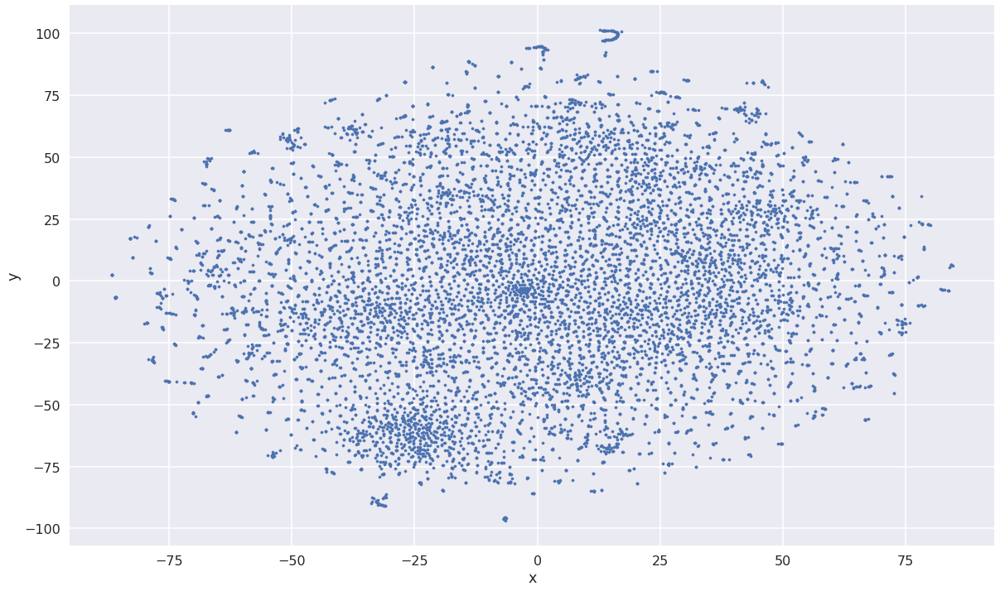

In [85]:
points.plot.scatter("x", "y", s=10, figsize=(20, 12))

In [99]:
%%time
def plot_region(x_bounds, y_bounds):
    slice = points[
        (x_bounds[0] <= points.x) &
        (points.x <= x_bounds[1]) &
        (y_bounds[0] <= points.y) &
        (points.y <= y_bounds[1]) 
    ]
    
    ax = slice.plot.scatter("x", "y", s=35, figsize=(10, 8))
    for i, point in slice.iterrows():
        #print(point.word)
        ax.text(point.x + 0.005, point.y + 0.005, point.word, fontsize=11)

CPU times: user 7 µs, sys: 0 ns, total: 7 µs
Wall time: 11.4 µs


CPU times: user 51 ms, sys: 29.4 ms, total: 80.4 ms
Wall time: 40.7 ms


/usr/local/lib/python3.5/dist-packages/matplotlib/font_manager.py:1328: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


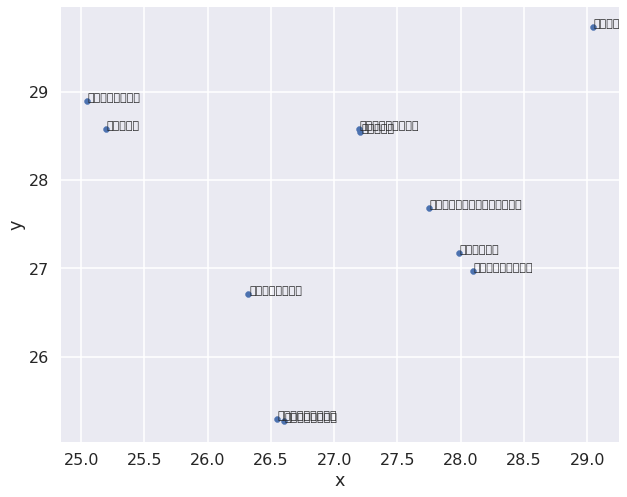

In [101]:
%%time
plot_region(x_bounds=(25, 30), y_bounds=(25, 30))

# Build Word2Vec Model with Skip Gram (Neg=0,Iter=2,size=100,window=15)
Very Good and Recommand <3 <3

In [17]:
%%time
model4=Word2Vec(texts, size=100, alpha=0.025, window=15, min_count=5, max_vocab_size=None, sample=0, seed=1, workers=1, min_alpha=0.0001, sg=1, hs=1, negative=0, cbow_mean=0, iter=2, null_word=0, trim_rule=None, sorted_vocab=1)

CPU times: user 19.1 s, sys: 25.6 ms, total: 19.1 s
Wall time: 19 s


In [53]:
model4.most_similar('စစ်ပြန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ရဲဘော်', 0.6382526159286499),
 ('ကျားသစ်', 0.5877608060836792),
 ('ဘာသာရေး', 0.5798473954200745),
 ('စစ်ဝါဒီ', 0.5582629442214966),
 ('မျိုးကွဲ', 0.5544651746749878),
 ('ခြိုးခြိုးခြံခြံ', 0.5526967644691467),
 ('စစ်မှုထမ်းဟောင်း', 0.5494565963745117),
 ('အမျိုးမျိုး', 0.5293454527854919),
 ('သန့်ပြန့်', 0.5142514705657959),
 ('ရိုင်းစိုင်း', 0.5107759833335876)]

In [54]:
model4.most_similar('ဂျပန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ချစ်ကြည်', 0.5774146318435669),
 ('နိဟွန်ဂေါ့', 0.5505729913711548),
 ('တိုက်ထုတ်', 0.532539963722229),
 ('နိဟွန်း', 0.5317529439926147),
 ('တရားဟော', 0.5274205207824707),
 ('ဘီအင်အေ', 0.5241796970367432),
 ('၁၉၄၁', 0.5208412408828735),
 ('ပြန်လှန်', 0.517690896987915),
 ('日本語', 0.5113379955291748),
 ('တိုက်ပွဲဝင်', 0.5056523084640503)]

In [55]:
model4.most_similar('လုံခြုံ')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('အလွတ်တန်း', 0.6461740732192993),
 ('၂ဝဝ၅', 0.5921968817710876),
 ('ကုလသမဂ္ဂ', 0.5818510055541992),
 ('ဒုက္ခပေး', 0.562328577041626),
 ('ပိပြား', 0.5373516082763672),
 ('အထွေထွေညီလာခံ', 0.5347775220870972),
 ('တရားမျှတ', 0.534037709236145),
 ('လုပ်ငန်းသမား', 0.5281374454498291),
 ('ငြိမ်ဝပ်', 0.5204111337661743),
 ('သီတင်းပါတ်', 0.509813129901886)]

In [56]:
model4.most_similar('ညီညွတ်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('စည်းလုံး', 0.8421717882156372),
 ('သင့်မြတ်', 0.757304310798645),
 ('မေ့လိုက်', 0.6156083941459656),
 ('ခေါင်းဆောင်', 0.5709803700447083),
 ('ဖဆပလ', 0.5675948858261108),
 ('ကိုယ်တော်မှိုင်း', 0.5623552799224854),
 ('ဖော်ဆောင်', 0.5560339689254761),
 ('မာက်စ်', 0.5343757271766663),
 ('စစ်ပညာ', 0.519813597202301),
 ('ညီလာခံ', 0.5154256820678711)]

 # Build Word2Vec Model with Skip Gram (Neg=0,Iter=2,size=100,window=3)

In [18]:
%%time
model_w3=Word2Vec(texts, size=100, alpha=0.025, window=3, min_count=5, max_vocab_size=None, sample=0, seed=1, workers=1, min_alpha=0.0001, sg=1, hs=1, negative=0, cbow_mean=0, iter=2, null_word=0, trim_rule=None, sorted_vocab=1)

CPU times: user 8.58 s, sys: 42.6 ms, total: 8.62 s
Wall time: 8.56 s


In [138]:
model_w3.most_similar('စစ်ပြန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ရုပ်ဆင်းသဏ္ဌာန်', 0.580229640007019),
 ('အရင်းအနှီး', 0.5765824317932129),
 ('CHF', 0.48021841049194336),
 ('အမျိုးမျိုး', 0.46610724925994873),
 ('အိမ်ဝ', 0.4623788595199585),
 ('ကြေးထည်', 0.4552231431007385),
 ('မျိုးကွဲ', 0.44930192828178406),
 ('စိတ်မချမ်းသာ', 0.4463436007499695),
 ('သွေးထွက်အောင်', 0.4425673484802246),
 ('ပိုးထည်', 0.42804500460624695)]

In [139]:
model_w3.most_similar('ညီညွတ်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('စည်းလုံး', 0.6414512395858765),
 ('မတည်', 0.5312302708625793),
 ('အကျိုးရှိရှိ', 0.513110876083374),
 ('ကောင်းစား', 0.5118126273155212),
 ('ရှေးရှု', 0.4934128224849701),
 ('ပွင့်လင်း', 0.4891573190689087),
 ('ဖော်ဆောင်', 0.48622292280197144),
 ('သွေးစည်း', 0.4798601269721985),
 ('ဆက်သွယ်', 0.4648100435733795),
 ('ရေး', 0.4614902138710022)]

In [140]:
model_w3.most_similar('ဂျပန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('တိုက်ထုတ်', 0.4686545729637146),
 ('တပ်', 0.45004069805145264),
 ('အမွိုင်', 0.4459453523159027),
 ('နိဟွန်း', 0.4388906955718994),
 ('မောင့်တ်ဖူဂျီ', 0.43391337990760803),
 ('ပေါ်တူဂီ', 0.4171997904777527),
 ('ဖက်ဆစ်', 0.41219398379325867),
 ('စစ်တပ်', 0.3939058780670166),
 ('ဗြိတိသျှ', 0.39183276891708374),
 ('တိုဂျို', 0.38702160120010376)]

In [141]:
model_w3.most_similar('လုံခြုံ')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ပြည်ထဲရေး', 0.5637983083724976),
 ('ကုလသမဂ္ဂ', 0.5325587391853333),
 ('ဝင်ရောက်စွက်ဖက်', 0.5202733278274536),
 ('အသိုင်းအဝန်း', 0.5086731910705566),
 ('ဖွံ့ဖြိုး', 0.5011340379714966),
 ('နီးနီးစပ်စပ်', 0.4903847575187683),
 ('လူမှုဆက်ဆံ', 0.4870119094848633),
 ('ဆူပူအုံကြွ', 0.48619481921195984),
 ('ထောင်ချ', 0.48587968945503235),
 ('ဒုက္ခပေး', 0.48235148191452026)]

In [142]:
model_w3.similar_by_word('အိုမင်း')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `similar_by_word` (Method will be removed in 4.0.0, use self.wv.similar_by_word() instead).
  """Entry point for launching an IPython kernel.


[('မုဆိုးမ', 0.9673185348510742),
 ('မကျန်းမမာ', 0.9042961597442627),
 ('မစွမ်းမသန်', 0.8967516422271729),
 ('စာပေးစာယူ', 0.7150304317474365),
 ('အသက်အရွယ်', 0.7025550603866577),
 ('ကိုယ်အင်္ဂါ', 0.6908183097839355),
 ('ခယ်တောင်ခြေချည်တောင်', 0.6869917511940002),
 ('ကျွမ်းဝင်', 0.6374887228012085),
 ('မြေညီပြင်', 0.5909104943275452),
 ('မင်းဆောင်မင်းယောင်', 0.5742962956428528)]

# =====================================================

In [19]:
model.most_similar('ရန်ကုန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ဒီဇင်ဘာ', 0.9973995685577393),
 ('မော်လမြိုင်', 0.9971945881843567),
 ('မြူနီစီပယ်', 0.997154176235199),
 ('၁၇၅၂', 0.9970690608024597),
 ('မြူးထူး', 0.9970034956932068),
 ('နှစ်ကုန်', 0.9969878196716309),
 ('နေပြည်တော်', 0.9969756603240967),
 ('ရက်တနာ', 0.996947169303894),
 ('ပညာသင်', 0.9969395995140076),
 ('ဦးခန္တီ', 0.996890664100647)]

In [20]:
model1.most_similar('ရန်ကုန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('မြို့', 0.9998311996459961),
 ('မှ', 0.999817967414856),
 ('ခုနှစ်', 0.9998064637184143),
 ('အား', 0.9997981190681458),
 ('နိုင်', 0.999794602394104),
 ('သို့', 0.9997917413711548),
 ('ခု', 0.999789834022522),
 ('သူ့', 0.9997879266738892),
 ('ရန်', 0.9997869729995728),
 ('ထား', 0.9997862577438354)]

In [29]:
model_Fast_Cbow.most_similar('ရန်ကုန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ထွက်ကုန်', 0.9999880790710449),
 ('ကုန်', 0.9999867677688599),
 ('အကုန်', 0.9999863505363464),
 ('လကုန်', 0.9999856352806091),
 ('နှစ်ကုန်', 0.9999843835830688),
 ('စားကုန်', 0.9999833106994629),
 ('ကုန်လွန်', 0.9999824166297913),
 ('ပို့ကုန်', 0.9999821186065674),
 ('ဆုန်', 0.9999818801879883),
 ('ထုတ်ကုန်', 0.9999817609786987)]

In [28]:
model_Fast_s.most_similar('ရန်ကုန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ရုန်းကန်', 0.9944771528244019),
 ('ခလီဖာအွတ်စ်မန်း', 0.9936271905899048),
 ('ဖုန်းခေါ်', 0.9933991432189941),
 ('နုန်းတင်မြေနု', 0.9928102493286133),
 ('ဝန်းရံ', 0.9926902651786804),
 ('နှစ်ကုန်', 0.992287278175354),
 ('ယူနီတေးရီးရန်း', 0.9921101927757263),
 ('ဘုန်းမီးနေလ', 0.9920145273208618),
 ('ပတ္တမြားစိမ်း', 0.9919759035110474),
 ('သန်းခေါင်ယံ', 0.9918861985206604)]

In [24]:
model2.most_similar('ရန်ကုန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('မြို့', 0.5905486345291138),
 ('ဗိုလ်တထောင်ဘုရား', 0.5846836566925049),
 ('တက္ကသိုလ်', 0.5750590562820435),
 ('Reed', 0.5700000524520874),
 ('စမ်းချောင်း', 0.5593314170837402),
 ('အထွေထွေရောဂါကုဆေးရုံ', 0.5550645589828491),
 ('ကမာရွတ်', 0.5548908710479736),
 ('Rangoon', 0.5352010726928711),
 ('တဖက်ကမ်း', 0.5320216417312622),
 ('ပုသိမ်', 0.5316517949104309)]

In [25]:
model3.most_similar('ရန်ကုန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('မြို့', 0.6944406032562256),
 ('ကမာရွတ်', 0.664261519908905),
 ('အထွေထွေရောဂါကုဆေးရုံ', 0.6364822387695312),
 ('တဖက်ကမ်း', 0.6190868616104126),
 ('မအူပင်', 0.6163731813430786),
 ('Rangoon', 0.6150597333908081),
 ('ပင်လယ်ကြောင်း', 0.610962450504303),
 ('စမ်းချောင်း', 0.5979962348937988),
 ('ဗိုလ်တထောင်ဘုရား', 0.5884087681770325),
 ('မီးရထားလမ်းဆုံး', 0.5771932005882263)]

In [26]:
model4.most_similar('ရန်ကုန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('မြို့', 0.6770308613777161),
 ('ကမာရွတ်', 0.66412353515625),
 ('ကျော်ဝင်း', 0.6140966415405273),
 ('အထွေထွေရောဂါကုဆေးရုံ', 0.6060217618942261),
 ('Rangoon', 0.6042800545692444),
 ('တက္ကသိုလ်', 0.5989910960197449),
 ('အထက်တန်းကျောင်း', 0.5989245772361755),
 ('မီးရထားလမ်းဆုံး', 0.5982894897460938),
 ('စာတိုက်ခွဲ', 0.5976139903068542),
 ('ရဲဌာနာ', 0.5954763889312744)]

In [27]:
model_w3.most_similar('ရန်ကုန်')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('လက်ဝဲစွန်းရောက်', 0.5516588687896729),
 ('တက္ကသိုလ်', 0.5421836376190186),
 ('ကမာရွတ်', 0.5353880524635315),
 ('အထွေထွေရောဂါကုဆေးရုံ', 0.5290543437004089),
 ('ဆိုင်းစု', 0.5259544849395752),
 ('မော်လမြိုင်', 0.5121594667434692),
 ('ဝါးခယ်မ', 0.5121561884880066),
 ('တဖက်ကမ်း', 0.5113270282745361),
 ('RudyardKipling', 0.5069833397865295),
 ('Reed', 0.505841851234436)]

In [30]:
model.most_similar('ယောက်ျား')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ငထွေရူး', 0.9990564584732056),
 ('ဝေါဟာရလီနတ္ထဒီပနီ', 0.9990450739860535),
 ('ရူပ', 0.9990348219871521),
 ('လေးညှင်းပွင့်', 0.9990209341049194),
 ('ပွန်ဒီချယ်ရီ', 0.9990091919898987),
 ('ဒေစ္စမန္တိသောကြာ', 0.9990013837814331),
 ('ဇာတိပ္ဖိုလ်ပွင့်', 0.9989854693412781),
 ('အမှော်နရကူစေ့', 0.9989804029464722),
 ('Wall', 0.9989674687385559),
 ('မာဒါဂါးစကား', 0.9989603757858276)]

In [31]:
model1.most_similar('ယောက်ျား')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('လ', 0.9997689723968506),
 ('ရန်', 0.9997459650039673),
 ('ကာ', 0.9997334480285645),
 ('စွာ', 0.9997307658195496),
 ('ထား', 0.9997290372848511),
 ('မှ', 0.9997227191925049),
 ('သွား', 0.9997202157974243),
 ('ခုနှစ်', 0.999718964099884),
 ('၌', 0.9997164011001587),
 ('အဖြစ်', 0.9997154474258423)]

In [32]:
model2.most_similar('ယောက်ျား')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('မိန်းမ', 0.7905102968215942),
 ('ထက်သန်ပြင်း', 0.5971309542655945),
 ('မည်ရွေ့မည်မျှ', 0.5551548600196838),
 ('ပေါင်းဘော်', 0.5467244386672974),
 ('ပြည်တန်ဆာ', 0.5404595732688904),
 ('လင်မယား', 0.5363166332244873),
 ('ပေါင်းသင်း', 0.5337534546852112),
 ('အစုံ', 0.5326015949249268),
 ('၆၅.၇၇', 0.5284441113471985),
 ('ရာဂ', 0.5264359712600708)]

In [33]:
model3.most_similar('ယောက်ျား')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('မိန်းမ', 0.80616694688797),
 ('ထက်သန်ပြင်း', 0.6218953728675842),
 ('မည်ရွေ့မည်မျှ', 0.5994226932525635),
 ('လင်မယား', 0.591111421585083),
 ('ရာဂ', 0.5804005265235901),
 ('အင်းပျဉ်', 0.551953136920929),
 ('အသက်တန်း', 0.5461742877960205),
 ('အနီးကပ်ဆုံး', 0.5365613698959351),
 ('၆၅.၇၇', 0.5362106561660767),
 ('အစုံ', 0.5297504663467407)]

In [34]:
model4.most_similar('ယောက်ျား')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('မိန်းမ', 0.8321366310119629),
 ('လင်မယား', 0.6075266599655151),
 ('မည်ရွေ့မည်မျှ', 0.6056780815124512),
 ('ထက်သန်ပြင်း', 0.5810253024101257),
 ('အနီးကပ်ဆုံး', 0.567355751991272),
 ('ရာဂ', 0.5669042468070984),
 ('ငယ်ရွယ်', 0.5532647371292114),
 ('အသက်တန်း', 0.5480211973190308),
 ('ပေါင်းသင်း', 0.5385429859161377),
 ('အင်းပျဉ်', 0.5370224714279175)]

In [35]:
model_w3.most_similar('ယောက်ျား')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('မိန်းမ', 0.7430739402770996),
 ('ထက်သန်ပြင်း', 0.5977023839950562),
 ('၆၅.၇၇', 0.5436248779296875),
 ('ပေါင်းဘော်', 0.5091577768325806),
 ('လင်မယား', 0.5060330629348755),
 ('ပုံပန်း', 0.4995564818382263),
 ('မြို့သား', 0.4868943393230438),
 ('သန့်မြင့်ဦး', 0.4799361526966095),
 ('မြေး', 0.4751780033111572),
 ('ပြည်တန်ဆာ', 0.46294036507606506)]

In [53]:
model2.score('အောင်မြင်')

array([0., 0., 0., 0., 0., 0., 0., 0., 0.], dtype=float32)

In [88]:
"နာရီ ဘယ် မှာ ဝယ် လို့ ရ နိုင် မလဲ"

'နာရီ ဘယ် မှာ ဝယ် လို့ ရ နိုင် မလဲ'

In [87]:
model2.doesnt_match("နာရီ ဘယ် မှာ မြန်မာ ဝယ် လို့ ရ နိုင် မလဲ".split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'မြန်မာ'

In [89]:
model.doesnt_match("နာရီ ဘယ် မှာ မြန်မာ ဝယ် လို့ ရ နိုင် မလဲ".split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'နာရီ'

In [90]:
model1.doesnt_match("နာရီ ဘယ် မှာ မြန်မာ ဝယ် လို့ ရ နိုင် မလဲ".split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'မလဲ'

In [91]:
model3.doesnt_match("နာရီ ဘယ် မှာ မြန်မာ ဝယ် လို့ ရ နိုင် မလဲ".split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'မြန်မာ'

In [92]:
model4.doesnt_match("နာရီ ဘယ် မှာ မြန်မာ ဝယ် လို့ ရ နိုင် မလဲ".split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'မြန်မာ'

In [116]:
model_w3.doesnt_match("မြန်မာ နာရီ ဘယ် မှာ ဝယ် လို့ ရ နိုင် မလဲ".split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'မြန်မာ'

In [94]:
model.doesnt_match('ထို အစည်းအရုံး သည် အမျိုးသား ရေး စိတ်ဓာတ် ပြင်းပြ ၍ နုပျို တက်ကြွ သည့် အခြေခံ လက္ခဏာ ရှိ ပြီး အစည်းအရုံး နာရီ  ခေါင်းဆောင် များ သည် သက်ကြီး နိုင်ငံရေးသမား များ နှင့် မ တူ တမူထူးခြား ကြ ပါ သည် ။'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'ရေး'

In [95]:
model1.doesnt_match('ထို အစည်းအရုံး သည် အမျိုးသား ရေး စိတ်ဓာတ် ပြင်းပြ ၍ နုပျို တက်ကြွ သည့် အခြေခံ လက္ခဏာ ရှိ ပြီး အစည်းအရုံး နာရီ  ခေါင်းဆောင် များ သည် သက်ကြီး နိုင်ငံရေးသမား များ နှင့် မ တူ တမူထူးခြား ကြ ပါ သည် ။'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'တမူထူးခြား'

In [96]:
model2.doesnt_match('ထို အစည်းအရုံး သည် အမျိုးသား ရေး စိတ်ဓာတ် ပြင်းပြ ၍ နုပျို တက်ကြွ သည့် အခြေခံ လက္ခဏာ ရှိ ပြီး အစည်းအရုံး နာရီ  ခေါင်းဆောင် များ သည် သက်ကြီး နိုင်ငံရေးသမား များ နှင့် မ တူ တမူထူးခြား ကြ ပါ သည် ။'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'နာရီ'

In [97]:
model3.doesnt_match('ထို အစည်းအရုံး သည် အမျိုးသား ရေး စိတ်ဓာတ် ပြင်းပြ ၍ နုပျို တက်ကြွ သည့် အခြေခံ လက္ခဏာ ရှိ ပြီး အစည်းအရုံး နာရီ  ခေါင်းဆောင် များ သည် သက်ကြီး နိုင်ငံရေးသမား များ နှင့် မ တူ တမူထူးခြား ကြ ပါ သည် ။'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'နာရီ'

In [98]:
model4.doesnt_match('ထို အစည်းအရုံး သည် အမျိုးသား ရေး စိတ်ဓာတ် ပြင်းပြ ၍ နုပျို တက်ကြွ သည့် အခြေခံ လက္ခဏာ ရှိ ပြီး အစည်းအရုံး နာရီ  ခေါင်းဆောင် များ သည် သက်ကြီး နိုင်ငံရေးသမား များ နှင့် မ တူ တမူထူးခြား ကြ ပါ သည် ။'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'နာရီ'

In [99]:
model_w3.doesnt_match('ထို အစည်းအရုံး သည် အမျိုးသား ရေး စိတ်ဓာတ် ပြင်းပြ ၍ နုပျို တက်ကြွ သည့် အခြေခံ လက္ခဏာ ရှိ ပြီး အစည်းအရုံး နာရီ  ခေါင်းဆောင် များ သည် သက်ကြီး နိုင်ငံရေးသမား များ နှင့် မ တူ တမူထူးခြား ကြ ပါ သည် ။'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'နာရီ'

In [117]:
model.most_similar_cosmul(positive=['အောင်ဆန်း', 'အမည်'], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဗိုလ်ချုပ်', 0.9989146590232849),
 ('လုပ်ငန်းစဉ်', 0.9988082647323608),
 ('ဆာမောင်ကြီး', 0.9987592697143555),
 ('ထွန်းအုပ်', 0.9986963272094727),
 ('ဖော်ဆောင်', 0.9986873865127563),
 ('ညီညွတ်', 0.9986611604690552),
 ('အကြံပေး', 0.9986369013786316),
 ('ရဲဘော်သုံးကျိပ်', 0.9986334443092346),
 ('ဆွေးနွေး', 0.9985867738723755),
 ('စည်းလုံး', 0.9985596537590027)]

In [118]:
model1.most_similar_cosmul(positive=['အောင်ဆန်း', 'အမည်'], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ခေါ်', 0.9999896883964539),
 ('ရေး', 0.9999871253967285),
 ('မြင်း', 0.9999814629554749),
 ('ထား', 0.9999810457229614),
 ('ခုနှစ်', 0.9999807476997375),
 ('-', 0.9999802112579346),
 ('မိမိ', 0.9999800324440002),
 ('ယောက်', 0.9999793171882629),
 ('၎င်း', 0.9999792575836182),
 ('ကြီး', 0.9999783039093018)]

In [119]:
model2.most_similar_cosmul(positive=['အောင်ဆန်း', 'အမည်'], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('သက္က', 0.9154012203216553),
 ('မှည့်ခေါ်', 0.8536108136177063),
 ('ကိုယ်ကျိုးရှာသမား', 0.8524064421653748),
 ('Code', 0.8449880480766296),
 ('ကိုယ်တိုင်ရေးအတ္ထုပ္ပတ္တိ', 0.8429594039916992),
 ('ဒေစ္စဂုရုသောကြာ', 0.841347336769104),
 ('တသက်တာမှတ်တမ်း', 0.8405957221984863),
 ('မ္လယ်တာ', 0.8382232785224915),
 ('ကြွေးကြော်', 0.8245030045509338),
 ('မြွယ်တာ', 0.8244423270225525)]

In [120]:
model3.most_similar_cosmul(positive=['အောင်ဆန်း', 'အမည်'], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ကော်ပါးဆဲ', 0.8888561129570007),
 ('အစောတလျင်', 0.8840139508247375),
 ('သစ်', 0.8789249658584595),
 ('ဦးဗဆွေ', 0.8631459474563599),
 ('ရုပ်စုံ', 0.853575587272644),
 ('ကိုယ်တိုင်ရေးအတ္ထုပ္ပတ္တိ', 0.8514166474342346),
 ('မောင်ကြင်ဆွေ', 0.8513331413269043),
 ('ကင်ပေအိ', 0.8505412936210632),
 ('သိပ္ပကုံလုံ', 0.8305684924125671),
 ('ပေါင်းချုပ်', 0.8270300030708313)]

In [121]:
model4.most_similar_cosmul(positive=['အောင်ဆန်း', 'အမည်'], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ကင်ပေအိ', 0.9048095345497131),
 ('‘', 0.8651196360588074),
 ('ကိုယ်တိုင်ရေးအတ္ထုပ္ပတ္တိ', 0.8476488590240479),
 ('’', 0.8359090685844421),
 ('ကော်ပါးဆဲ', 0.8353708982467651),
 ('အထွေထွေရွေးကောက်ပွဲ', 0.8319398164749146),
 ('မဏ္ဍလ', 0.8268332481384277),
 ('သက္က', 0.8219069242477417),
 ('တသက်တာမှတ်တမ်း', 0.8214666247367859),
 ('ဗဲနက်တီယာဘာနေး', 0.8162717819213867)]

In [122]:
model_w3.most_similar_cosmul(positive=['အောင်ဆန်း', 'အမည်'], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ခံထိုက်', 0.9334989190101624),
 ('မြွယ်တာ', 0.9082594513893127),
 ('သက္က', 0.8750981688499451),
 ('နွေတာ', 0.8721750378608704),
 ('ကမ္ဘာဦးသူ', 0.8708134293556213),
 ('ကိုယ်ရံတော်', 0.8566958904266357),
 ('ဗိုင်ဩလိုဂျီ', 0.851542055606842),
 ('လက်ဖျား', 0.8472091555595398),
 ('ရန်အောင်', 0.8435532450675964),
 ('တသက်တာမှတ်တမ်း', 0.8306021094322205)]

In [299]:
r = model3['ဘုရင်'] - model3['ယောက်ျား'] + model3['မိန်းမ']
model3.similar_by_vector(r)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `similar_by_vector` (Method will be removed in 4.0.0, use self.wv.similar_by_vector() instead).
  


[('ဘုရင်', 0.7692292928695679),
 ('စည်းမျဉ်းခံ', 0.5069689750671387),
 ('နန်းစိုက်', 0.5066360235214233),
 ('မင်းဆက်', 0.4910812973976135),
 ('နန်းစံ', 0.4603198766708374),
 ('အပြစ်မဲ့', 0.451353520154953),
 ('မနူဟာ', 0.4423496425151825),
 ('မိချန်', 0.4378665089607239),
 ('မိနော', 0.43639063835144043),
 ('စိုးစံ', 0.4345840513706207)]

In [303]:
model.most_similar_cosmul(['ယောက်ျား','မိန်းမ','အချစ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('လေးညှင်းပွင့်', 0.9982237815856934),
 ('ဇာတိပ္ဖိုလ်ပွင့်', 0.998200535774231),
 ('အမှော်နရကူစေ့', 0.9981914162635803),
 ('သရက်ပွင့်', 0.9981616735458374),
 ('ပေါင်ပဲစေ့မာလတိ', 0.9981552958488464),
 ('မီးဖုတ်', 0.99815434217453),
 ('မီးကင်', 0.9981542229652405),
 ('စမုံမျိုးငါးပါး', 0.9981486797332764),
 ('ရှိန်းခို', 0.9981350898742676),
 ('လီယွန်ဆိုမားလီးယား', 0.9981116056442261)]

In [302]:
model2.most_similar_cosmul(['ယောက်ျား','မိန်းမ','အချစ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ထက်သန်ပြင်း', 0.3296234905719757),
 ('အနီးကပ်ဆုံး', 0.31033849716186523),
 ('ရာဂ', 0.30586686730384827),
 ('မည်ရွေ့မည်မျှ', 0.30115628242492676),
 ('အစုံ', 0.29909148812294006),
 ('သန့်မြင့်ဦး', 0.2962191104888916),
 ('အရပ်အမောင်း', 0.2862950265407562),
 ('အပေါ်ခွံ', 0.28353434801101685),
 ('ငယ်ရွယ်', 0.2792151868343353),
 ('အဖြစ်အပျက်', 0.27913525700569153)]

In [301]:
model3.most_similar_cosmul(['ယောက်ျား','မိန်းမ','အချစ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('မည်ရွေ့မည်မျှ', 0.3717854619026184),
 ('အနီးကပ်ဆုံး', 0.3555370569229126),
 ('ထက်သန်ပြင်း', 0.3520597815513611),
 ('ရာဂ', 0.3251670300960541),
 ('အသက်တန်း', 0.3208553194999695),
 ('ငယ်ရွယ်', 0.30644845962524414),
 ('သဘောက်လင်ငယ်ထား', 0.2998810410499573),
 ('အစုံ', 0.2909388542175293),
 ('ပေါင်းသင်း', 0.2907786965370178),
 ('ဖြုန်းတီး', 0.28892990946769714)]

In [304]:
model4.most_similar_cosmul(['ယောက်ျား','မိန်းမ','အချစ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အနီးကပ်ဆုံး', 0.3633861541748047),
 ('မည်ရွေ့မည်မျှ', 0.3629821240901947),
 ('သောက်စား', 0.33600395917892456),
 ('ထက်သန်ပြင်း', 0.3250320255756378),
 ('ငယ်ရွယ်', 0.31516584753990173),
 ('အပျော်အပါး', 0.3146314322948456),
 ('ရာဂ', 0.31366902589797974),
 ('ပေါင်းသင်း', 0.31329748034477234),
 ('အသက်တန်း', 0.30899283289909363),
 ('သဘောက်လင်ငယ်ထား', 0.30738088488578796)]

In [305]:
model_w3.most_similar_cosmul(['ယောက်ျား','မိန်းမ','အချစ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('မြို့သား', 0.309082567691803),
 ('ထက်သန်ပြင်း', 0.30413323640823364),
 ('အရပ်အမောင်း', 0.3009518086910248),
 ('သန့်မြင့်ဦး', 0.2791465222835541),
 ('ရာဂ', 0.2682044506072998),
 ('အဖြတ်', 0.26318731904029846),
 ('သဏ္ဌာန်', 0.2581486999988556),
 ('ကြိုး', 0.2574467062950134),
 ('မည်ရွေ့မည်မျှ', 0.25355109572410583),
 ('ကလျာ', 0.2521732449531555)]

In [361]:
model.most_similar_cosmul(['အဖိုး','အဖွား','မြေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('JuMaNaw', 0.998127818107605),
 ('ကြီးရင့်', 0.9980928301811218),
 ('ဂျူမနော', 0.9979799389839172),
 ('phosphates', 0.9977983832359314),
 ('ဖိုစဖိတ်', 0.9976697564125061),
 ('ဝပ်တွား', 0.9976370334625244),
 ('သရက်စေ့', 0.9976343512535095),
 ('ဟိုက်ဒရဗတ်', 0.9976316094398499),
 ('ဒေစ္စမန္တိသောကြာ', 0.9976295828819275),
 ('စာချိုး', 0.9976266622543335)]

In [362]:
model2.most_similar_cosmul(['အဖိုး','အဖွား','မြေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အို', 0.45288577675819397),
 ('ကြီးရင့်', 0.34575626254081726),
 ('သေဆုံး', 0.3400488793849945),
 ('ဒေါ်ရွှေ', 0.33398184180259705),
 ('အင်းပျဉ်', 0.33329421281814575),
 ('ယောက်ျား', 0.33262720704078674),
 ('မင်းဆောင်မင်းယောင်', 0.3241840898990631),
 ('ဝိနည်း', 0.3137626647949219),
 ('ထိုက်တန်', 0.3135984539985657),
 ('ဒါးပိန်', 0.31169429421424866)]

In [363]:
model3.most_similar_cosmul(['အဖိုး','အဖွား','မြေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အို', 0.42454108595848083),
 ('ကြီးရင့်', 0.40767109394073486),
 ('ဂျူမနော', 0.4071499705314636),
 ('JuMaNaw', 0.40317752957344055),
 ('မြေခွေးဖို', 0.34093177318573),
 ('ခမည်းတော်', 0.33630940318107605),
 ('မင်းဆောင်မင်းယောင်', 0.33545878529548645),
 ('တစ်နည်း', 0.33208465576171875),
 ('ကျင်ငယ်', 0.33194413781166077),
 ('မင်းခမ်းမင်းနား', 0.33151811361312866)]

In [364]:
model4.most_similar_cosmul(['အဖိုး','အဖွား','မြေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဂျူမနော', 0.44718435406684875),
 ('အို', 0.44426652789115906),
 ('JuMaNaw', 0.443367600440979),
 ('ကြီးရင့်', 0.3932900130748749),
 ('အေးအေးသန့်', 0.3309917747974396),
 ('အသက်အရွယ်', 0.3293111026287079),
 ('မြေခွေးဖို', 0.3191315531730652),
 ('တစ်နည်း', 0.31843292713165283),
 ('ခင်ပွန်း', 0.3164641559123993),
 ('ကျင်ငယ်', 0.3149755895137787)]

In [365]:
model_w3.most_similar_cosmul(['အဖိုး','အဖွား','မြေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အို', 0.40742480754852295),
 ('အစုအဖွဲ့', 0.3548373878002167),
 ('ရာပြည့်', 0.3472089469432831),
 ('ရဲသီဟ', 0.33727625012397766),
 ('၉၃ဝ', 0.3361762762069702),
 ('၁၈၉၆', 0.33323559165000916),
 ('ဒေါ်ရွှေ', 0.3326360285282135),
 ('စာချိုး', 0.3310651481151581),
 ('တစ်ပြိုင်တည်း', 0.3304395079612732),
 ('၁၆၁', 0.32420459389686584)]

In [311]:
model.most_similar_cosmul(['ဆေးရုံ','ဆေးခန်း','လူနာ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('မီးအုံး', 0.9981004595756531),
 ('ပေါင်းခံ', 0.998042106628418),
 ('မုတ်', 0.9980133771896362),
 ('သပြေသား', 0.9980111718177795),
 ('အီရစ်ထရီးယား', 0.9980072379112244),
 ('ချိပ်', 0.9980048537254333),
 ('နှဲ', 0.9980023503303528),
 ('နီဂီနီ', 0.9979996681213379),
 ('သရက်စေ့', 0.9979957938194275),
 ('ချင်းခြောက်', 0.9979894757270813)]

In [312]:
model2.most_similar_cosmul(['ဆေးရုံ','ဆေးခန်း','လူနာ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('လမ်းမတော်', 0.27736759185791016),
 ('တိုက်တာ', 0.2671092450618744),
 ('ဘက်ပတစ်', 0.26285186409950256),
 ('Hospital', 0.25708892941474915),
 ('ဖာသာရ်-ဝဲလဝါး', 0.2524920403957367),
 ('ကွင်းဆင်း', 0.24782440066337585),
 ('အဆောက်အဦ', 0.2397027462720871),
 ('ပြီးငြိမ်း', 0.23969271779060364),
 ('ခွင့်', 0.23889610171318054),
 ('Order', 0.2384212166070938)]

In [313]:
model3.most_similar_cosmul(['ဆေးရုံ','ဆေးခန်း','လူနာ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('တိုက်တာ', 0.2980307340621948),
 ('Hospital', 0.297116756439209),
 ('တာဝန်သိသိ', 0.2957519292831421),
 ('စိတ်ရင်း', 0.27946245670318604),
 ('သစ္စာထား', 0.2783457338809967),
 ('bulletin', 0.2764144539833069),
 ('ဖာသာရ်-ဝဲလဝါး', 0.26789259910583496),
 ('ရေရှည်', 0.2657720744609833),
 ('လမ်းမတော်', 0.2523006796836853),
 ('တွေ့ဆုံ', 0.25072741508483887)]

In [315]:
model4.most_similar_cosmul(['ဆေးရုံ','ဆေးခန်း','လူနာ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('Hospital', 0.30381157994270325),
 ('တာဝန်သိသိ', 0.29383012652397156),
 ('သူနာပြု', 0.27694159746170044),
 ('bulletin', 0.27073806524276733),
 ('ကြင်ဖော်သူ', 0.2673965394496918),
 ('ဂျကာ', 0.2645359933376312),
 ('သစ္စာထား', 0.2597041428089142),
 ('ရေရှည်', 0.2567325830459595),
 ('ရေနံဓာတု', 0.25566086173057556),
 ('ရုံးပိတ်ရက်', 0.25473204255104065)]

In [316]:
model_w3.most_similar_cosmul(['ဆေးရုံ','ဆေးခန်း','လူနာ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('လမ်းမတော်', 0.2715506851673126),
 ('ဘက်ပတစ်', 0.26476266980171204),
 ('ပညာသင်ကျောင်း', 0.2487121969461441),
 ('ကေအီးအမ်', 0.24616245925426483),
 ('လူ့ကိုယ်တိုင်း', 0.2438284158706665),
 ('ဖာသာရ်-ဝဲလဝါး', 0.23904213309288025),
 ('သံချေး', 0.2376951277256012),
 ('KingEdwardMemoral', 0.23763969540596008),
 ('အေဘီအမ်', 0.2362128347158432),
 ('ဦးတင်ဦး', 0.23450680077075958)]

In [295]:
model.most_similar_cosmul(positive=['မိန်းမ','ဘုရင်' ], negative=['ယောက်ျား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ပျောက်စင်', 0.9991863965988159),
 ('Domestic', 0.9991598129272461),
 ('ပြာသာဒ်', 0.9991438388824463),
 ('မုတ်', 0.9991365075111389),
 ('ဘုံလယ်မြေ', 0.9991315007209778),
 ('ဧတ္ထောတိ', 0.999126672744751),
 ('ဇိမ်ခံ', 0.999121904373169),
 ('ဘောလုံးကွင်း', 0.9991167187690735),
 ('ဝိမာနဋ္ဌကာ', 0.9991154074668884),
 ('နနွင်းတက်', 0.9991132020950317)]

In [296]:
model2.most_similar_cosmul(positive=['မိန်းမ','ဘုရင်' ], negative=['ယောက်ျား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('မြေလှန်', 0.8117960095405579),
 ('ခမာ', 0.8089886903762817),
 ('ကြီးစိုး', 0.8015098571777344),
 ('အင်ပိုင်ယာ', 0.7885775566101074),
 ('နန်းစိုက်', 0.7858313918113708),
 ('မလ္လာယု', 0.7854607701301575),
 ('သထုံ', 0.7822087407112122),
 ('တစ်လုံးတစ်စည်း', 0.7818722128868103),
 ('ချမ်', 0.7793964147567749),
 ('စိုးစံ', 0.7713011503219604)]

In [156]:
model3.most_similar_cosmul(positive=['မိန်းမ','ဘုရင်' ], negative=['ယောက်ျား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('နန်းစိုက်', 0.8100795745849609),
 ('မင်းဆက်', 0.7841120958328247),
 ('စည်းမျဉ်းခံ', 0.7829346060752869),
 ('အပြစ်မဲ့', 0.77481609582901),
 ('စိုးစံ', 0.762759804725647),
 ('မိချန်', 0.7614233493804932),
 ('မနူဟာ', 0.7577772736549377),
 ('မြေလှန်', 0.7574658989906311),
 ('မိနော', 0.756458044052124),
 ('ပြယ်', 0.7559757828712463)]

In [460]:
model4.most_similar_cosmul(positive=['မိန်းမ','ဘုရင်မ' ], negative=['ယောက်ျား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ရှင်စောပု', 0.8686662912368774),
 ('ကျော်ဒဂုင်', 0.8684788346290588),
 ('ကျိုက်ဒဂုံ', 0.8614933490753174),
 ('ဒဂုံဘုရား', 0.8544958829879761),
 ('မြှင့်', 0.8437334895133972),
 ('ဉာဏ်', 0.7959786653518677),
 ('ဝိတိုရိယ', 0.7814352512359619),
 ('အပြိုင်', 0.7783817052841187),
 ('ဩဇာအာဏာ', 0.7781410217285156),
 ('နှစ်သစ်ကူး', 0.7775247097015381)]

In [167]:
model_w3.most_similar_cosmul(positive=['မိန်းမ','ဘုရင်' ], negative=['ယောက်ျား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ခမာ', 0.933397650718689),
 ('တစ်လုံးတစ်စည်း', 0.9091624617576599),
 ('သထုံ', 0.8857714533805847),
 ('စိုးမိုး', 0.8476822376251221),
 ('မာမွတ်', 0.8463315963745117),
 ('ဂီယာလောင်', 0.842490017414093),
 ('သက်ဦးဆံပိုင်', 0.8384168148040771),
 ('ပြည့်ရှင်', 0.8205785751342773),
 ('စည်းမျဉ်းခံ', 0.81902015209198),
 ('နန်းစိုက်', 0.8183308243751526)]

In [339]:
model.most_similar_cosmul(positive=['စစ်သား','ဗိုလ်ချုပ်'], negative=['စစ်တပ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အောင်ဆန်း', 0.9988213777542114),
 ('ဦးသန်းကြွယ်', 0.9980073571205139),
 ('ပင်လုံ', 0.9980067014694214),
 ('သဘောတူ', 0.9979152083396912),
 ('ရဲဘော်သုံးကျိပ်', 0.9978420734405518),
 ('ဘုရင်ခံ', 0.997791051864624),
 ('ညီလာခံ', 0.9977582097053528),
 ('တပ်မတော်', 0.9977278709411621),
 ('ရေးထိုး', 0.9977259039878845),
 ('အကြံပေး', 0.9977178573608398)]

In [340]:
model2.most_similar_cosmul(positive=['စစ်သား','ဗိုလ်ချုပ်'], negative=['စစ်တပ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အောင်ဆန်း', 0.8723440170288086),
 ('နိုင်ငံတော်သား', 0.8687008023262024),
 ('ရှက်', 0.8628825545310974),
 ('သီချင်း', 0.852418065071106),
 ('’', 0.8408001065254211),
 ('ကိုဌေးမြိုင်', 0.8242177963256836),
 ('‘', 0.8232948184013367),
 ('စစ်ဝန်ကြီး', 0.8223260045051575),
 ('ရဲဘော်သုံးကျိပ်', 0.8127064108848572),
 ('နူးညံ့', 0.8016582131385803)]

In [341]:
model3.most_similar_cosmul(positive=['စစ်သား','ဗိုလ်ချုပ်'], negative=['စစ်တပ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('‘', 0.9532595276832581),
 ('ကိုဌေးမြိုင်', 0.9401748180389404),
 ('အောင်ဆန်း', 0.9391915202140808),
 ('ညည်းတွား', 0.9372172951698303),
 ('ဒိုရာသန်းအေး', 0.9339407086372375),
 ('သီချင်း', 0.9214452505111694),
 ('ချင်ခြင်း', 0.9178082346916199),
 ('’', 0.8957589268684387),
 ('ကဉ္စန', 0.8869707584381104),
 ('ရဲဘော်သုံးကျိပ်', 0.8854883909225464)]

In [342]:
model4.most_similar_cosmul(positive=['စစ်သား','ဗိုလ်ချုပ်'], negative=['စစ်တပ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အားလပ်', 0.9852575063705444),
 ('အလုပ်များ', 0.9619273543357849),
 ('ပြိုင်ဘက်', 0.9265570044517517),
 ('ညည်းတွား', 0.9179048538208008),
 ('ကိုဌေးမြိုင်', 0.915389358997345),
 ('တတ်ကျွမ်း', 0.9067277312278748),
 ('အောင်ဆန်း', 0.9031640291213989),
 ('ဒိုရာသန်းအေး', 0.8925998210906982),
 ('လွတ်လပ်', 0.8900294303894043),
 ('ထိုင်ကြည့်', 0.887385904788971)]

In [343]:
model_w3.most_similar_cosmul(positive=['စစ်သား','ဗိုလ်ချုပ်'], negative=['စစ်တပ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ရှက်', 0.9224007725715637),
 ('ဖွား', 0.8844528198242188),
 ('စစ်ဝန်ကြီး', 0.8578882813453674),
 ('မေးဖျား', 0.856440544128418),
 ('နိုင်ငံတော်သား', 0.8441486358642578),
 ('လယ်ကွင်း', 0.8377524018287659),
 ('တွားသွားသတ္တဝါ', 0.8324040770530701),
 ('မာရ်နတ်', 0.8318958878517151),
 ('နူးညံ့', 0.8238836526870728),
 ('တဖက်', 0.8209679126739502)]

In [224]:
model.most_similar_cosmul(positive=['ဘုရင်','နိုင်ငံ'], negative=['ဘုရင်မ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('မြန်မာ', 0.9970452785491943),
 ('အာရှ', 0.9968236088752747),
 ('ထိစပ်', 0.9968052506446838),
 ('ဘင်္ဂလားဒေ့ရှ်', 0.996599555015564),
 ('အိန္ဒိယ', 0.996493399143219),
 ('အရှေ့တောင်', 0.9964187145233154),
 ('လာအို', 0.9963613152503967),
 ('ထိုင်း', 0.9963216185569763),
 ('Thailand', 0.996235191822052),
 ('ကပ္ပလီ', 0.9960771799087524)]

In [225]:
model2.most_similar_cosmul(positive=['ဘုရင်','နိုင်ငံ'], negative=['ဘုရင်မ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('စနည်းနာ', 0.981269359588623),
 ('ယဉ်ကျေး', 0.9172424077987671),
 ('ဆီးရီးယား', 0.9088612198829651),
 ('တချိန်', 0.9052332043647766),
 ('ကူးလူးဆက်ဆံ', 0.9012060761451721),
 ('နည်းပါး', 0.8773218989372253),
 ('ပြည်', 0.8771511912345886),
 ('ဆက်ဆံ', 0.8765860199928284),
 ('ပျက်သုန်း', 0.8732808828353882),
 ('အားသာ', 0.871184766292572)]

In [226]:
model3.most_similar_cosmul(positive=['ဘုရင်','နိုင်ငံ'], negative=['ဘုရင်မ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('စာရင်းဝင်', 0.9654949903488159),
 ('စည်းမျဉ်းခံ', 0.9530549049377441),
 ('ဟန်တူ', 0.9274104833602905),
 ('ခြားနား', 0.9269174337387085),
 ('ဆက်ဆံ', 0.906883955001831),
 ('နိဂုံး', 0.9060809016227722),
 ('အထွန်းကားဆုံး', 0.9041973948478699),
 ('ဟိနာယ', 0.8926417827606201),
 ('အာဆီယံ', 0.8900713324546814),
 ('ရှေးအစဉ်အဆက်', 0.881718635559082)]

In [227]:
model4.most_similar_cosmul(positive=['ဘုရင်','နိုင်ငံ'], negative=['ဘုရင်မ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ရှေးအစဉ်အဆက်', 0.9361141324043274),
 ('ဟန်တူ', 0.9289175271987915),
 ('ဓလေ့စရိုက်', 0.9237593412399292),
 ('အားပေး', 0.9187100529670715),
 ('စည်းမျဉ်းခံ', 0.9111414551734924),
 ('ချင်း', 0.9070099592208862),
 ('အိမ်နီးချင်း', 0.898492157459259),
 ('ဆောလျင်', 0.887902557849884),
 ('လတ်တလော', 0.8861051201820374),
 ('ကုန်းတွင်းပိတ်', 0.8807775974273682)]

In [228]:
model_w3.most_similar_cosmul(positive=['ဘုရင်','နိုင်ငံ'], negative=['ဘုရင်မ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ငလျင်', 0.8809386491775513),
 ('ပြည်', 0.8711023926734924),
 ('ချအပ်', 0.8590127229690552),
 ('ရာဇအာဏာစကြာ', 0.8410415053367615),
 ('ကော်ပီ', 0.8401572108268738),
 ('ပျက်ပြား', 0.8375244736671448),
 ('မှောင်ခို', 0.8353843092918396),
 ('တာဝန်ပေးချက်', 0.8302652835845947),
 ('လတ်တလော', 0.8295674324035645),
 ('လိုလား', 0.8280090689659119)]

In [168]:
model.most_similar_cosmul(positive=['ရန်ကုန်','မြို့' ], negative=['မန္တလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('မြို့နယ်', 0.997758686542511),
 ('မော်လမြိုင်', 0.997477114200592),
 ('၁၈၈၆', 0.9974427223205566),
 ('၁၇၈၂', 0.9974423050880432),
 ('၁၉၃၇', 0.9973669052124023),
 ('နေပြည်တော်', 0.9972728490829468),
 ('၁၈၂၃', 0.9972428679466248),
 ('၁၈၄၁', 0.9972381591796875),
 ('စစ်ကိုင်း', 0.9972227811813354),
 ('မင်းကွန်း', 0.9971991777420044)]

In [170]:
model2.most_similar_cosmul(positive=['ရန်ကုန်','မြို့' ], negative=['မန္တလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ပုသိမ်', 0.8509941101074219),
 ('မြို့တော်', 0.8488768935203552),
 ('ကိုလိုနီခေတ်', 0.8327953815460205),
 ('သံတွဲ', 0.8325569033622742),
 ('ဦးမြတ်သာ', 0.831007182598114),
 ('ဒေါ်သန်းတင်', 0.8301618695259094),
 ('တဖက်ကမ်း', 0.8192088007926941),
 ('ဗိုလ်တထောင်ဘုရား', 0.8189800381660461),
 ('၁၉၆၉', 0.8184877038002014),
 ('ကိုမောင်မောင်', 0.8171780109405518)]

In [171]:
model3.most_similar_cosmul(positive=['ရန်ကုန်','မြို့' ], negative=['မန္တလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('လေးသန်း', 0.9904218316078186),
 ('မြို့တော်', 0.9597833752632141),
 ('Rangoon', 0.9485787749290466),
 ('ပင်လယ်ကြောင်း', 0.9428441524505615),
 ('မော်လမြိုင်ကျွန်း', 0.9307690858840942),
 ('သံတွဲ', 0.9305709600448608),
 ('ပေကျင်း', 0.9183019995689392),
 ('တိုးနှုန်း', 0.900793194770813),
 ('တောင်ဥက္ကလာ', 0.897586464881897),
 ('တဖက်ကမ်း', 0.8973459601402283)]

In [172]:
model4.most_similar_cosmul(positive=['ရန်ကုန်','မြို့' ], negative=['မန္တလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('Rangoon', 0.9741896986961365),
 ('မချမ်းဘော', 0.9561998248100281),
 ('စစ်မက်ပြု', 0.9519126415252686),
 ('သနပ်ဘက်', 0.9518501162528992),
 ('မော်လမြိုင်ကျွန်း', 0.9490550756454468),
 ('အထက်တန်းကျောင်း', 0.9429708123207092),
 ('၁၉၂၅', 0.9381697177886963),
 ('ပျဉ်းမနား', 0.9361100196838379),
 ('ဂျင်း', 0.9328094720840454),
 ('မြို့တော်', 0.9298326373100281)]

In [173]:
model_w3.most_similar_cosmul(positive=['ရန်ကုန်','မြို့' ], negative=['မန္တလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('တဖက်ကမ်း', 0.8180975914001465),
 ('သံတွဲ', 0.791737973690033),
 ('အင်ပါယာ', 0.7911688089370728),
 ('ဝန်ကြီးချုပ်', 0.7907289862632751),
 ('လက်အောက်', 0.7858577966690063),
 ('အင်းစိန်', 0.7805916666984558),
 ('ကျင်းပ', 0.7784458994865417),
 ('ကျောင်း', 0.7660873532295227),
 ('အထွေထွေရောဂါကုဆေးရုံ', 0.7634986639022827),
 ('မလေးရှား', 0.7624948024749756)]

In [178]:
model.most_similar_cosmul(positive=['မြန်မာ','နိုင်ငံ' ], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဖွံ့ဖြိုး', 0.9979715347290039),
 ('ဘင်္ဂလားဒေ့ရှ်', 0.9969800710678101),
 ('အနိမ့်ဆုံး', 0.9966493844985962),
 ('လာအို', 0.996548593044281),
 ('အရှေ့တောင်', 0.9964557886123657),
 ('ထိစပ်', 0.9964035749435425),
 ('အာရှ', 0.9963996410369873),
 ('ရေး', 0.9961708188056946),
 ('ထိုင်း', 0.9960513114929199),
 ('အိန္ဒိယ', 0.9960275888442993)]

In [177]:
model2.most_similar_cosmul(positive=['မြန်မာ','နိုင်ငံ' ], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ကမ္ဘောဒီးယား', 1.0119200944900513),
 ('အာဖဂန်နစ္စတန်', 0.9852071404457092),
 ('သမ္မတနိုင်ငံ', 0.9812818765640259),
 ('အရေးကြီးဆုံး', 0.9769774675369263),
 ('လာအို', 0.9727065563201904),
 ('ပါကစ္စတန်', 0.9697882533073425),
 ('ထိုင်း', 0.9672892689704895),
 ('ကပ်ကျောက်', 0.9602546095848083),
 ('ဗဟိုဌာန', 0.9601499438285828),
 ('စည်းမျဉ်းခံ', 0.951328456401825)]

In [179]:
model3.most_similar_cosmul(positive=['မြန်မာ','နိုင်ငံ' ], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ထိုင်း', 1.1065292358398438),
 ('အရေးကြီးဆုံး', 1.0620990991592407),
 ('လူဇင်ဘတ်', 1.0550317764282227),
 ('၅၁၄', 1.0511671304702759),
 ('တစ်ဝန်း', 1.047528862953186),
 ('ဆွစ်ဇာလန်', 1.045307993888855),
 ('မိုနာကို', 1.0429757833480835),
 ('ဘယ်လ်ဂျီယံ', 1.0401705503463745),
 ('အန်ဒိုရာ', 1.0334595441818237),
 ('ဘရူနိုင်း', 1.025037169456482)]

In [180]:
model4.most_similar_cosmul(positive=['မြန်မာ','နိုင်ငံ' ], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဓလေ့စရိုက်', 1.1165270805358887),
 ('ဘရူနိုင်း', 1.0391279458999634),
 ('အန်ဒိုရာ', 1.0353906154632568),
 ('မိုနာကို', 1.0230344533920288),
 ('အချက်အချာကျ', 1.0142518281936646),
 ('အရေးကြီးဆုံး', 1.0083941221237183),
 ('တစ်ဝန်း', 1.0049993991851807),
 ('၁၇၅', 1.003029465675354),
 ('၅၁၄', 1.0026445388793945),
 ('၂၆၁', 1.0008490085601807)]

In [181]:
model_w3.most_similar_cosmul(positive=['မြန်မာ','နိုင်ငံ' ], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အဆို', 0.9731263518333435),
 ('ကမ္ဘာ့', 0.9579224586486816),
 ('သမ္မတနိုင်ငံ', 0.9401910305023193),
 ('ထိုင်း', 0.9322614073753357),
 ('ပါကစ္စတန်', 0.926074743270874),
 ('ပြက္ခဒိန်', 0.9002482891082764),
 ('ကွန်ဂရက်', 0.8984235525131226),
 ('พระนครศรีอยุธยา', 0.8982665538787842),
 ('ဘုရင့်', 0.8933236598968506),
 ('အရ', 0.892468273639679)]

In [292]:
model.most_similar_cosmul(positive=['ယောက်ျား','ဘုရင်မ'], negative=['မိန်းမ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဝိတိုရိယ', 0.9996175169944763),
 ('လက်ကဒိုက်', 0.9995884299278259),
 ('ဖားငယ်မ', 0.9995760321617126),
 ('ဒဂုံဘုရား', 0.9995585083961487),
 ('ဥတ္တရသီရိ', 0.9995560050010681),
 ('ဒေစ္စမန္တိသောကြာ', 0.9995307922363281),
 ('ဝေါဟာရလီနတ္ထဒီပနီ', 0.9995283484458923),
 ('Bill', 0.9995265007019043),
 ('ဓာတ်စည်း', 0.9995262026786804),
 ('၁၂၇၆', 0.9995242357254028)]

In [293]:
model2.most_similar_cosmul(positive=['ယောက်ျား','ဘုရင်မ'], negative=['မိန်းမ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ရှင်စောပု', 0.8473750352859497),
 ('အဲလိဇဘက်', 0.8274087309837341),
 ('ဝိတိုရိယ', 0.8233054280281067),
 ('ဆိုက်ဘာအီလစ်', 0.8079642057418823),
 ('ကဗျာ', 0.7888008952140808),
 ('ခန္တီး', 0.7878270149230957),
 ('ထားဝယ်', 0.7823397517204285),
 ('တာရာ', 0.7822186350822449),
 ('လီကွမ်ယု', 0.7795642614364624),
 ('မွှေနှောက်', 0.7746294140815735)]

In [290]:
model3.most_similar_cosmul(positive=['ယောက်ျား','ဘုရင်မ'], negative=['မိန်းမ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဝိတိုရိယ', 0.8397299647331238),
 ('ရှင်စောပု', 0.8111556172370911),
 ('ခန္တီး', 0.8088195323944092),
 ('သစ္စာခံ', 0.8027705550193787),
 ('ဇနီး', 0.8007192015647888),
 ('မဟာသရေစည်သူ', 0.7968021035194397),
 ('စည်သူ', 0.7948969602584839),
 ('ပူတောင်း', 0.7831184267997742),
 ('ဖက်ဒရေးရှင်း', 0.7802940011024475),
 ('ဖူနဘရှိ', 0.7791193127632141)]

In [291]:
model4.most_similar_cosmul(positive=['ယောက်ျား','ဘုရင်မ'], negative=['မိန်းမ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဝိတိုရိယ', 0.8391748070716858),
 ('ရှင်စောပု', 0.7910052537918091),
 ('မဏိပူရ', 0.7899196743965149),
 ('အဲလိဇဘက်', 0.7882028818130493),
 ('ခန္တီး', 0.7822245955467224),
 ('ဆက်သ', 0.7751554250717163),
 ('၁၈၈၆', 0.7728096842765808),
 ('၂၀၀၅', 0.7717307209968567),
 ('လှိုဏ်ဂူတော်', 0.7686434388160706),
 ('သစ္စာခံ', 0.7670770287513733)]

In [317]:
model3.most_similar_cosmul(positive=['လူကြီး','အသက်'], negative=['ကလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အာသောက', 0.934378981590271),
 ('စကားရည်လုပွဲ', 0.9117641448974609),
 ('ပါးစပ်ရာဇဝင်', 0.9069556593894958),
 ('မင်း', 0.9037904739379883),
 ('ကျောင်းအုပ်', 0.8712085485458374),
 ('အတိသဉ္စာနဂရ', 0.8704927563667297),
 ('၁၆၁', 0.8523776531219482),
 ('များမကြာမီ', 0.8517788648605347),
 ('ရုပ်ရှင်ကား', 0.8428704142570496),
 ('၁.၂၅', 0.8379773497581482)]

In [263]:
model.most_similar_cosmul(positive=['ပြည်သူ','တိုင်းပြည်' ], negative=['ပြည်သား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ကုန်ပစ္စည်း', 0.9992271661758423),
 ('ထိန်းသိမ်း', 0.9991826415061951),
 ('အတိုက်အခံ', 0.9991770386695862),
 ('စစ်', 0.9991721510887146),
 ('အဆင့်အတန်း', 0.999152421951294),
 ('လွတ်လပ်', 0.9991293549537659),
 ('အေးဆေး', 0.9990972876548767),
 ('ရန်', 0.9990964531898499),
 ('သွေးစည်း', 0.9990776777267456),
 ('တရားမျှတ', 0.9990720748901367)]

In [264]:
model2.most_similar_cosmul(positive=['ပြည်သူ','တိုင်းပြည်' ], negative=['ပြည်သား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဂုဏ်သိက္ခာ', 1.2064648866653442),
 ('သို့တည်းမဟုတ်', 1.1617056131362915),
 ('ချုပ်ချယ်', 1.1505005359649658),
 ('လူမဆန်', 1.1499249935150146),
 ('သဘောဆောင်', 1.1465673446655273),
 ('စိတ်ဓာတ်', 1.1463110446929932),
 ('ကန့်သတ်', 1.1194331645965576),
 ('သံဃာတော်', 1.1176848411560059),
 ('အထက်သန်ဆုံး', 1.1079374551773071),
 ('ပြုန်းတီး', 1.105984091758728)]

In [265]:
model3.most_similar_cosmul(positive=['ပြည်သူ','တိုင်းပြည်' ], negative=['ပြည်သား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဝက်ဘ်စာမျက်နှာ', 1.5103479623794556),
 ('ချုပ်ချယ်', 1.4474438428878784),
 ('အပြည့်အဝ', 1.3333814144134521),
 ('ကန့်သတ်', 1.3297274112701416),
 ('အတိုက်အခံ', 1.255589485168457),
 ('သဘောဆောင်', 1.2131308317184448),
 ('ထူးထူးခြားခြား', 1.1880587339401245),
 ('အသိစိတ်', 1.1796960830688477),
 ('ကြွယ်ဝ', 1.1777859926223755),
 ('တန်းတူညီမျှ', 1.1723530292510986)]

In [266]:
model4.most_similar_cosmul(positive=['ပြည်သူ','တိုင်းပြည်' ], negative=['ပြည်သား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အပြည့်အဝ', 1.3513814210891724),
 ('ထူးထူးခြားခြား', 1.339106798171997),
 ('ချုပ်ချယ်', 1.3265081644058228),
 ('ဝက်ဘ်စာမျက်နှာ', 1.2915050983428955),
 ('ဝတ်ပြု', 1.226391077041626),
 ('အလေးအနက်', 1.2080789804458618),
 ('တန်းတူညီမျှ', 1.2046529054641724),
 ('အစဉ်တစိုက်', 1.1690342426300049),
 ('အတိုက်အခံ', 1.1689999103546143),
 ('ကန့်သတ်', 1.1516810655593872)]

In [267]:
model_w3.most_similar_cosmul(positive=['ပြည်သူ','တိုင်းပြည်' ], negative=['ပြည်သား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အရှိဆုံး', 1.3463066816329956),
 ('ဂုဏ်သိက္ခာ', 1.3185429573059082),
 ('ချို့ယွင်း', 1.3150609731674194),
 ('သို့တည်းမဟုတ်', 1.27202308177948),
 ('အကြောင်းပြု', 1.2171399593353271),
 ('အထက်သန်ဆုံး', 1.1997791528701782),
 ('ချုပ်ချယ်', 1.1900739669799805),
 ('ဂရုမစိုက်', 1.169273853302002),
 ('ဩဇာ', 1.1630337238311768),
 ('လူမဆန်', 1.162020206451416)]

In [274]:
model.most_similar_cosmul(positive=['အချစ်','မိန်းမ'], negative=['ယောက်ျား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('သေလုမတတ်', 0.9993748068809509),
 ('ဧတ္ထောတိ', 0.9993690252304077),
 ('ကုန်းသတ္တဝါ', 0.9993548393249512),
 ('အပျော့စား', 0.9993389248847961),
 ('လစ်ဗာဝတ်ပင်', 0.9993325471878052),
 ('အန္တောဝီထိတော', 0.9993305802345276),
 ('အပြစ်', 0.9993262887001038),
 ('ရိုက်နှက်', 0.9993236064910889),
 ('အတည်မပြု', 0.9993148446083069),
 ('Genetics', 0.9993124008178711)]

In [320]:
model2.most_similar_cosmul(positive=['ယောက်ျား','မိန်းမ'], negative=['အချစ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('၆၅.၇၇', 1.5216035842895508),
 ('လင်မယား', 1.5010428428649902),
 ('၆၇.၉၅', 1.4437689781188965),
 ('ပေါင်းဘော်', 1.366115689277649),
 ('၄ဝ', 1.3630118370056152),
 ('ပေါင်းသင်း', 1.2758713960647583),
 ('အင်းပျဉ်', 1.2593495845794678),
 ('မည်ရွေ့မည်မျှ', 1.251280426979065),
 ('ကုဋေ', 1.2305693626403809),
 ('ပြည်တန်ဆာ', 1.224172830581665)]

In [284]:
model3.most_similar_cosmul(positive=['ယောက်ျား','မိန်းမ'], negative=['အချစ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('လင်မယား', 1.672025203704834),
 ('၆၅.၇၇', 1.3555032014846802),
 ('ထက်သန်ပြင်း', 1.320773720741272),
 ('ပေါင်းဘော်', 1.3164225816726685),
 ('အင်းပျဉ်', 1.2736022472381592),
 ('၆၇.၉၅', 1.2592324018478394),
 ('ရာဂ', 1.248520851135254),
 ('အစုံ', 1.2331174612045288),
 ('ပေါင်းသင်း', 1.2077211141586304),
 ('မည်ရွေ့မည်မျှ', 1.1999390125274658)]

In [278]:
model4.most_similar_cosmul(positive=['ယောက်ျား','မိန်းမ'], negative=['အချစ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('လင်မယား', 1.4596744775772095),
 ('၆၅.၇၇', 1.2674884796142578),
 ('မည်ရွေ့မည်မျှ', 1.2373578548431396),
 ('ထက်သန်ပြင်း', 1.2322118282318115),
 ('ရာဂ', 1.212808609008789),
 ('၆၇.၉၅', 1.203220009803772),
 ('အသက်တန်း', 1.187709927558899),
 ('ပေါင်းသင်း', 1.1824942827224731),
 ('ငယ်ရွယ်', 1.1760271787643433),
 ('ကွာရှင်း', 1.1544266939163208)]

In [279]:
model_w3.most_similar_cosmul(positive=['ယောက်ျား','မိန်းမ'], negative=['အချစ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('၆၅.၇၇', 1.8034552335739136),
 ('၆၇.၉၅', 1.5262283086776733),
 ('ကုဋေ', 1.5172991752624512),
 ('၄ဝ', 1.4338605403900146),
 ('မွေးချင်း', 1.3864151239395142),
 ('ပျမ်းမျှ', 1.3806363344192505),
 ('၁ဝ', 1.3252170085906982),
 ('လက်မ', 1.311152458190918),
 ('ပေါင်းဘော်', 1.306654453277588),
 ('၁၉၅၄ဝဝဝ', 1.2719223499298096)]

In [188]:
model.most_similar_cosmul(positive=[ 'နာနတ်သီး','အသီး' ], negative=['သရက်သီး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('သလိပ်', 1.0000466108322144),
 ('သည်းခြေ', 0.9998955130577087),
 ('ပူ', 0.9998657703399658),
 ('တောက်', 0.9998349547386169),
 ('စိမ်း', 0.9997498989105225),
 ('မှည့်', 0.9997348189353943),
 ('ဝမ်းမီး', 0.9997156858444214),
 ('ချဉ်', 0.9997154474258423),
 ('ဝမ်းသက်', 0.9996929168701172),
 ('ဦးပန်း', 0.9995918273925781)]

In [187]:
model2.most_similar_cosmul(positive=[ 'နာနတ်သီး','အသီး' ], negative=['သရက်သီး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('လက်သုတ်', 0.9256443977355957),
 ('ပူ', 0.9067530035972595),
 ('တင်ကျီးငှက်', 0.9021492004394531),
 ('Rory', 0.8949519395828247),
 ('တောက်', 0.8918523192405701),
 ('ဝမ်းမီး', 0.8905066251754761),
 ('မင်္ဂလာဆောင်', 0.8841756582260132),
 ('စိမ်', 0.8821466565132141),
 ('တင်ကျီး', 0.8815996646881104),
 ('နှုတ်သီး', 0.88104647397995)]

In [185]:
model3.most_similar_cosmul(positive=[ 'နာနတ်သီး','အသီး' ], negative=['သရက်သီး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ပူ', 0.85664963722229),
 ('ဝမ်းမီး', 0.8454051613807678),
 ('သလိပ်', 0.8432116508483887),
 ('ဝမ်းသက်', 0.8320382833480835),
 ('သည်းခြေ', 0.8273401856422424),
 ('ချဉ်', 0.8257141709327698),
 ('မှည့်', 0.8074140548706055),
 ('ရင့်', 0.7795929908752441),
 ('အုန်းပင်', 0.7779558897018433),
 ('publishing', 0.7677215337753296)]

In [189]:
model4.most_similar_cosmul(positive=[ 'နာနတ်သီး','အသီး' ], negative=['သရက်သီး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ပူ', 0.9031561017036438),
 ('ချဉ်', 0.8876935839653015),
 ('သလိပ်', 0.8732867240905762),
 ('သည်းခြေ', 0.8654100298881531),
 ('အုန်းပင်', 0.8537776470184326),
 ('ဝမ်းသက်', 0.8398107886314392),
 ('မှည့်', 0.8347991704940796),
 ('ဝမ်းမီး', 0.8341803550720215),
 ('ရင့်', 0.8169112205505371),
 ('ချို', 0.7957485914230347)]

In [190]:
model_w3.most_similar_cosmul(positive=[ 'နာနတ်သီး','အသီး' ], negative=['သရက်သီး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('လက်သုတ်', 0.951951801776886),
 ('တင်ကျီးငှက်', 0.9396857619285583),
 ('ထင်း', 0.9068883061408997),
 ('Pteridophytes', 0.9025371074676514),
 ('တင်ကျီး', 0.8939573168754578),
 ('စိမ်', 0.8836022019386292),
 ('Bryophytes', 0.8660438656806946),
 ('AltairBASIC', 0.8630256056785583),
 ('from', 0.8601680994033813),
 ('Algae', 0.8471693396568298)]

In [191]:
model.most_similar_cosmul(positive=[ 'ရန်ကုန်','မြန်မာ' ], negative=['မန္တလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဖက်ဆစ်', 0.9998219013214111),
 ('ကွန်မြူနစ်', 0.9996991157531738),
 ('စစ်', 0.9996750950813293),
 ('ဖဆပလ', 0.9996427893638611),
 ('ကောင်စီ', 0.9996306300163269),
 ('အမေရိကန်', 0.9996097683906555),
 ('ရဲဘော်သုံးကျိပ်', 0.9996078610420227),
 ('၁၉၄၀', 0.9996069073677063),
 ('ဗြိတိသျှ', 0.9995901584625244),
 ('အဖွဲ့', 0.9995889067649841)]

In [192]:
model2.most_similar_cosmul(positive=[ 'ရန်ကုန်','မြန်မာ' ], negative=['မန္တလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ထိုင်း', 1.0067373514175415),
 ('ရုံးသုံး', 0.999069094657898),
 ('အင်ဒိုနီးရှား', 0.9897490739822388),
 ('သမ္မတ', 0.9804323315620422),
 ('အမေရိကန်', 0.9604339599609375),
 ('တိုဂျို', 0.9411069750785828),
 ('ပြဋ္ဌာန်း', 0.9194221496582031),
 ('ပြည်တော်သာ', 0.9176747798919678),
 ('အင်ပါယာ', 0.9152282476425171),
 ('တရားဝင်', 0.9150277376174927)]

In [193]:
model3.most_similar_cosmul(positive=[ 'ရန်ကုန်','မြန်မာ' ], negative=['မန္တလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('တိုဂျို', 1.0602539777755737),
 ('ဂေါ်ဒန်ဘရောင်း', 1.038041353225708),
 ('ဩစတြီးယား', 1.00589120388031),
 ('လေးသန်း', 1.005553126335144),
 ('မီနာမီ', 1.0025279521942139),
 ('တရားဝင်', 0.9980262517929077),
 ('ပြည်တော်သာ', 0.9975459575653076),
 ('အဂျင်ဒါ', 0.9936173558235168),
 ('SavetheChildren', 0.9759594798088074),
 ('အလုပ်လုပ်ကိုင်', 0.9746847748756409)]

In [194]:
model4.most_similar_cosmul(positive=[ 'ရန်ကုန်','မြန်မာ' ], negative=['မန္တလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အရပ်သုံးစကား', 1.0539512634277344),
 ('ဘားမား', 0.9963443279266357),
 ('ပြည်တော်သာ', 0.9785704016685486),
 ('၁၉၄၁', 0.9785596132278442),
 ('ညွှန်ကြားရေးမှူးချုပ်', 0.9767191410064697),
 ('တရားဝင်', 0.9732707738876343),
 ('ချစ်ကြည်', 0.9721186757087708),
 ('အာဏာသိမ်း', 0.9687103033065796),
 ('မီနာမီ', 0.9610312581062317),
 ('၁၉၆၉', 0.9578089118003845)]

In [195]:
model_w3.most_similar_cosmul(positive=[ 'ရန်ကုန်','မြန်မာ' ], negative=['မန္တလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အင်ဒိုနီးရှား', 0.948731541633606),
 ('အမေရိကန်', 0.9441041946411133),
 ('သမ္မတ', 0.9405373334884644),
 ('သာယာဝပြော', 0.9098950028419495),
 ('ပြင်သစ်', 0.9079033136367798),
 ('ဂျီ', 0.9060060977935791),
 ('ဝန်ကြီးချုပ်', 0.9005264043807983),
 ('ပြည်တော်သာ', 0.8916624188423157),
 ('အင်ပါယာ', 0.888581395149231),
 ('အပြီး', 0.8807260990142822)]

In [258]:
model.most_similar_cosmul(positive=['ကျောင်းသူ','တက္ကသိုလ်' ], negative=['ကျောင်းသား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ရန်ကုန်', 0.9989792704582214),
 ('ဆေး', 0.998920202255249),
 ('Temasek', 0.9988858699798584),
 ('Medical', 0.9988406300544739),
 ('ဆင်ခေတ်', 0.9988359212875366),
 ('အမည်ရင်း', 0.9988235235214233),
 ('ကိုဘဂျမ်း', 0.9988126158714294),
 ('မြူးထူး', 0.9988057613372803),
 ('တောင်ကျစမ်းချောင်း', 0.9987821578979492),
 ('ဒေါ်စိန်တင့်', 0.9987809658050537)]

In [259]:
model2.most_similar_cosmul(positive=['ကျောင်းသူ','တက္ကသိုလ်' ], negative=['ကျောင်းသား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဆေး', 0.8879284858703613),
 ('တောင်ကြီး', 0.8871513605117798),
 ('၂၇၂၅', 0.8842126727104187),
 ('ပရဝုဏ်', 0.8685523271560669),
 ('ကြည့်မြင်တိုင်', 0.8676869869232178),
 ('ကမာရွတ်', 0.8671753406524658),
 ('ကောလိပ်', 0.8509047031402588),
 ('ရန်ကုန်', 0.8093016147613525),
 ('အထွေထွေရောဂါကုဆေးရုံ', 0.804250955581665),
 ('စစ်ဌာနချုပ်', 0.803631603717804)]

In [260]:
model3.most_similar_cosmul(positive=['ကျောင်းသူ','တက္ကသိုလ်' ], negative=['ကျောင်းသား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ကမာရွတ်', 0.9260278344154358),
 ('ပရဝုဏ်', 0.9175570607185364),
 ('ကောလိပ်', 0.8758909702301025),
 ('ဆေး', 0.8700766563415527),
 ('အထွေထွေရောဂါကုဆေးရုံ', 0.8590169548988342),
 ('အောက်စဖို့', 0.850008487701416),
 ('ပင်ရင်း', 0.8494105935096741),
 ('Medical', 0.8489680290222168),
 ('၂၇၂၅', 0.8443689942359924),
 ('အော်ရီဂွန်', 0.8441770672798157)]

In [261]:
model4.most_similar_cosmul(positive=['ကျောင်းသူ','တက္ကသိုလ်' ], negative=['ကျောင်းသား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ကမာရွတ်', 0.9291686415672302),
 ('ပရဝုဏ်', 0.887329638004303),
 ('Medical', 0.8743852376937866),
 ('Branch', 0.8659499883651733),
 ('အောက်စဖို့', 0.8583186268806458),
 ('ကိန်းဘရစ်ချ်', 0.8578594326972961),
 ('ကောလိပ်', 0.8566598296165466),
 ('ဆေး', 0.8562584519386292),
 ('အထွေထွေရောဂါကုဆေးရုံ', 0.8540012836456299),
 ('အော်ရီဂွန်', 0.844728946685791)]

In [262]:
model_w3.most_similar_cosmul(positive=['ကျောင်းသူ','တက္ကသိုလ်' ], negative=['ကျောင်းသား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('တောင်ကြီး', 0.9508160352706909),
 ('လက်ဝဲစွန်းရောက်', 0.899420440196991),
 ('ဆေး', 0.8756781816482544),
 ('ဥပစာသိပ္ပံ', 0.8652418255805969),
 ('ပရဝုဏ်', 0.8545519709587097),
 ('အထွေထွေရောဂါကုဆေးရုံ', 0.8459909558296204),
 ('၂၇၂၅', 0.8429684042930603),
 ('တက်ရောက်', 0.8356868028640747),
 ('ကောလိပ်', 0.8320034742355347),
 ('ရန်ကုန်', 0.8313488364219666)]

In [148]:
model.doesnt_match('သစ်သီး ပန်းသီးပင် နာနတ်သီး သရက်သီး ဒူးရင်းသီး စပျစ်သီး စပါး သစ္စာခံ '.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'သစ်သီး'

In [147]:
model1.doesnt_match('သစ်သီး ပန်းသီးပင် နာနတ်သီး သရက်သီး ဒူးရင်းသီး စပျစ်သီး စပါး သစ္စာခံ '.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'ဒူးရင်းသီး'

In [146]:
model2.doesnt_match('သစ်သီး ပန်းသီးပင် နာနတ်သီး ဒူးရင်းသီး သရက်သီး စပျစ်သီး စပါး သစ္စာခံ'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'သစ္စာခံ'

In [154]:
model3.doesnt_match('သစ်သီး ပန်းသီးပင် နာနတ်သီး ဒူးရင်းသီး သရက်သီး စပျစ်သီး စပါး သစ္စာခံ'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'သစ္စာခံ'

In [144]:
model4.doesnt_match('သစ်သီး ပန်းသီးပင် နာနတ်သီး ဒူးရင်းသီး စပျစ်သီး သရက်သီး စပါး သစ္စာခံ '.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'သစ္စာခံ'

In [143]:
model_w3.doesnt_match('သစ်သီး ပန်းသီးပင် နာနတ်သီး သရက်သီး ဒူးရင်းသီး စပျစ်သီး စပါး သစ္စာခံ'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'သစ္စာခံ'

In [210]:
model.doesnt_match('စပယ်ပန်း နှင်းဆီ သစ်ခွ မြန်မာ စကားပန်း ပန်းဥယျာဉ်'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'မြန်မာ'

In [326]:
model2.doesnt_match('စပယ်ပန်း နှင်းဆီပန်း မြန်မာ စကားပန်း ပန်း ပန်းဥယျာဉ် '.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'မြန်မာ'

In [323]:
model3.doesnt_match('စပယ်ပန်း စကားပန်း ပန်း ပန်းဥယျာဉ် မြန်မာ နှင်းဆီပန်း'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'မြန်မာ'

In [324]:
model4.doesnt_match('စပယ်ပန်း မြန်မာ စကားပန်း ပန်း ပန်းဥယျာဉ် နှင်းဆီပန်း'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'မြန်မာ'

In [325]:
model_w3.doesnt_match('စပယ်ပန်း စကားပန်း ပန်း  ပန်းဥယျာဉ် မြန်မာ နှင်းဆီပန်း'.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'မြန်မာ'

In [327]:
model.doesnt_match('မင်းသား မင်းသမီး ရုပ်ရှင်ကား ဇတ်ကား ဆရာဝန် '.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'ဆရာဝန်'

In [328]:
model2.doesnt_match('မင်းသား မင်းသမီး ရုပ်ရှင်ကား ဇတ်ကား ဆရာဝန် '.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'မင်းသမီး'

In [329]:
model3.doesnt_match('မင်းသား မင်းသမီး ရုပ်ရှင်ကား ဇတ်ကား ဆရာဝန် '.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'ဆရာဝန်'

In [330]:
model4.doesnt_match('မင်းသား မင်းသမီး ရုပ်ရှင်ကား ဇတ်ကား ဆရာဝန် '.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'ဆရာဝန်'

In [331]:
model_w3.doesnt_match('မင်းသား မင်းသမီး ရုပ်ရှင်ကား ဇတ်ကား ဆရာဝန် '.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'ရုပ်ရှင်ကား'

In [344]:
%%time
model_n5 = Word2Vec(texts, size=100, window=5, min_count=5,sample=1e-5, negative=3, workers=3,sg=1) # default = 1 worker = no parallelizationd

CPU times: user 8.23 s, sys: 123 ms, total: 8.35 s
Wall time: 3.94 s


In [345]:
model_n5.doesnt_match('သစ်သီး ပန်းသီးပင် နာနတ်သီး သရက်သီး ဒူးရင်းသီး စပျစ်သီး စပါး သစ္စာခံ '.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'စပါး'

In [346]:
model_n5.most_similar_cosmul(positive=['ကျောင်းသူ','တက္ကသိုလ်' ], negative=['ကျောင်းသား'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အရည်ဖျော်', 0.9991689324378967),
 ('ဆင်းတု', 0.9991580843925476),
 ('လိမ်း', 0.9991463422775269),
 ('Host', 0.9991450309753418),
 ('လိပ်စရွေ', 0.9991434812545776),
 ('စစ်မီးပွား', 0.9991422295570374),
 ('သံသရာ', 0.9991343021392822),
 ('Instrumentation', 0.9991334676742554),
 ('definition', 0.9991316795349121),
 ('သစ္စေး', 0.9991239309310913)]

# SkipGram ,window 10,iter=3 

In [390]:
%%time
model_n10_iter3=Word2Vec(texts, size=100, alpha=0.025, window=10, min_count=5, max_vocab_size=None, sample=0, seed=1, workers=1, min_alpha=0.0001, sg=1, hs=1, negative=0, cbow_mean=0, iter=10, null_word=0, trim_rule=None, sorted_vocab=1)

CPU times: user 1min 15s, sys: 120 ms, total: 1min 15s
Wall time: 1min 15s


In [448]:
model.wv.distance('မိန်းမ','ဘုရင်မ')

0.002797754268588304

In [449]:
model2.wv.distance('မိန်းမ','ဘုရင်မ')

0.9867761793357868

In [450]:
model3.wv.distance('မိန်းမ','ဘုရင်မ')

1.088466886227521

In [459]:
model4.wv.distance('မိန်းမ','ဘုရင်မ')

1.1012080382754421

In [452]:
model_w3.wv.distance('မိန်းမ','ဘုရင်မ')

0.9657738723848913

In [453]:
model_n10_iter3.wv.distance('မိန်းမ','ဘုရင်မ')

1.1121525758444504

In [401]:
model_n10_iter3.wv.most_similar_cosmul(positive=['ကျောင်းသူ','တက္ကသိုလ်' ], negative=['ကျောင်းသား'])

[('ဆေး', 0.8643118739128113),
 ('ပရဝုဏ်', 0.8318113684654236),
 ('၂၇၂၅', 0.8256493806838989),
 ('ကမာရွတ်', 0.8089756369590759),
 ('အထွေထွေရောဂါကုဆေးရုံ', 0.7950551509857178),
 ('အပတ်စဉ်', 0.7824057340621948),
 ('Medical', 0.7804521322250366),
 ('အောက်စဖို့', 0.7724953889846802),
 ('Branch', 0.7718740105628967),
 ('မန္တလေး', 0.7671685218811035)]

In [392]:
model_n10_iter3.most_similar_cosmul(positive=[ 'ရန်ကုန်','မြန်မာ' ], negative=['မန္တလေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('လေးသန်း', 1.0004208087921143),
 ('တရားဝင်', 0.9600259065628052),
 ('ဂေါ်ဒန်ဘရောင်း', 0.9481452107429504),
 ('အသိမှတ်မပြု', 0.937989354133606),
 ('ရှင်းလင်းပွဲ', 0.9256208539009094),
 ('ထိုင်း', 0.918928861618042),
 ('အဂျင်ဒါ', 0.9175985455513),
 ('အချက်အချာကျ', 0.9090932607650757),
 ('အင်္ဂလိပ်', 0.9053335785865784),
 ('၁၉၀၉', 0.8995838165283203)]

In [393]:
model_n10_iter3.most_similar_cosmul(positive=['ယောက်ျား','မိန်းမ'], negative=['အချစ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('လင်မယား', 1.5299365520477295),
 ('ပေါင်းဘော်', 1.3610422611236572),
 ('ထက်သန်ပြင်း', 1.3377529382705688),
 ('ရာဂ', 1.2957308292388916),
 ('ပြည်တန်ဆာ', 1.250718593597412),
 ('အနီးကပ်ဆုံး', 1.157692790031433),
 ('ပေါင်းသင်း', 1.1396331787109375),
 ('၆၅.၇၇', 1.1326090097427368),
 ('မည်ရွေ့မည်မျှ', 1.1267720460891724),
 ('အသက်တန်း', 1.1156365871429443)]

In [394]:
model_n10_iter3.most_similar_cosmul(positive=['စစ်သား','ဗိုလ်ချုပ်'], negative=['စစ်တပ်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('အားလပ်', 0.9875632524490356),
 ('အောင်ဆန်း', 0.9584606289863586),
 ('ကိုဌေးမြိုင်', 0.9096861481666565),
 ('အလုပ်များ', 0.9088464379310608),
 ('ဒိုရာသန်းအေး', 0.8955517411231995),
 ('ညည်းတွား', 0.8818534016609192),
 ('ထိုင်ကြည့်', 0.8675971031188965),
 ('ညစာစားပွဲ', 0.8503693342208862),
 ('‘', 0.8494945168495178),
 ('လူရွယ်', 0.8473387360572815)]

In [395]:
model_n10_iter3.most_similar_cosmul(positive=['ယောက်ျား','ဘုရင်မ'], negative=['မိန်းမ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဆက်သ', 0.8268499374389648),
 ('ဝိတိုရိယ', 0.804663896560669),
 ('သမီးတော်', 0.7953200936317444),
 ('ရှင်စောပု', 0.7801695466041565),
 ('ပေးအပ်', 0.7527455687522888),
 ('မဟာသရေစည်သူ', 0.7517524361610413),
 ('ဦးမြင့်သိန်း', 0.7494794726371765),
 ('ဩဇာအာဏာ', 0.7462573647499084),
 ('ဖက်ဒရေးရှင်း', 0.7440076470375061),
 ('ပဏ္ဍာ', 0.7428908348083496)]

In [396]:
model_n10_iter3.most_similar_cosmul(positive=['ယောက်ျား','ဘုရင်'], negative=['မိန်းမ'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('သစ္စာခံ', 0.8862826228141785),
 ('ခန္တီး', 0.8809919357299805),
 ('စော်ဘွား', 0.8707209825515747),
 ('နန်းစံ', 0.8686650991439819),
 ('စည်းမျဉ်းခံ', 0.8656503558158875),
 ('ဘူမိဘော', 0.8485361337661743),
 ('အကုန်လုံး', 0.8332037329673767),
 ('ဆက်သ', 0.8220764994621277),
 ('ဘူမိဘောအဒူလျာဒက်', 0.8107231855392456),
 ('ချက်ကရီ', 0.7961406707763672)]

In [397]:
model_n10_iter3.most_similar_cosmul(['အဖိုး','အဖွား','မြေး'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('ဂျူမနော', 0.3608112931251526),
 ('JuMaNaw', 0.35509979724884033),
 ('အို', 0.33808258175849915),
 ('ကြီးရင့်', 0.33147016167640686),
 ('မြေခွေးဖို', 0.2967655658721924),
 ('မင်းဆောင်မင်းယောင်', 0.2920178472995758),
 ('အသက်အရွယ်', 0.2916049659252167),
 ('မင်းခမ်းမင်းနား', 0.2855680286884308),
 ('စေ၍', 0.2802378535270691),
 ('ထိုက်တန်', 0.274840772151947)]

In [398]:
model_n10_iter3.most_similar_cosmul(positive=['မြန်မာ','နိုင်ငံ' ], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('တိုင်းကြီးပြည်ကြီး', 1.1081725358963013),
 ('စည်းမျဉ်းခံ', 1.0926578044891357),
 ('ဓလေ့စရိုက်', 1.0765889883041382),
 ('พระนครศรีอยุธยา', 1.0417896509170532),
 ('ဝယ်အား', 1.0411198139190674),
 ('ထိုင်း', 1.0354290008544922),
 ('၂၆၁', 1.0322065353393555),
 ('ကျရှုံး', 1.0208989381790161),
 ('၅၁၄', 1.0156352519989014),
 ('လူဇင်ဘတ်', 1.011435627937317)]

In [399]:
model_n10_iter3.most_similar_cosmul(positive=['အောင်ဆန်း', 'အမည်'], negative=['ဂျပန်'])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar_cosmul` (Method will be removed in 4.0.0, use self.wv.most_similar_cosmul() instead).
  """Entry point for launching an IPython kernel.


[('မဏ္ဍလ', 0.915800929069519),
 ('ကော်ပါးဆဲ', 0.9077982306480408),
 ('ဗဲနက်တီယာဘာနေး', 0.8968995809555054),
 ('အမေးပုစ္ဆာ', 0.878656804561615),
 ('အစောတလျင်', 0.8764581680297852),
 ('VenetiaBurney', 0.869114875793457),
 ('တိုင်းကြီးပြည်ကြီး', 0.8631553053855896),
 ('ရုပ်စုံ', 0.8588514924049377),
 ('မဏ္ဍလေး', 0.8505882620811462),
 ('ပုရောဟိတောသောကြာ', 0.8427631258964539)]

In [389]:
model_n10_iter3.doesnt_match('သစ်သီး ပန်းသီးပင် နာနတ်သီး သရက်သီး ဒူးရင်းသီး စပျစ်သီး စပါး သစ္စာခံ '.split())

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `doesnt_match` (Method will be removed in 4.0.0, use self.wv.doesnt_match() instead).
  """Entry point for launching an IPython kernel.


'သစ္စာခံ'

In [66]:
from gensim.similarities import WmdSimilarity

In [67]:
instance = WmdSimilarity(texts, model, num_best=10)

In [68]:
print (instance)

WmdSimilarity<53643 docs, 100 features>


In [69]:
instance

In [79]:
from time import time
from nltk import word_tokenize

In [77]:
def preprocess(doc):
    doc = doc.lower()  # Lower the text.
    doc = word_tokenize(doc)  # Split into words.
    doc = [w for w in doc if not w in stop_words]  # Remove stopwords.
    doc = [w for w in doc if w.isalpha()]  # Remove numbers and punctuation.
    return doc

In [ ]:
print 'Cell took %.2f seconds to run.' %(time() - start)